# Carreguem les dades

In [1]:
#carregem les dades enzipades
#importem fastai
!pip3 install fastai --upgrade
from fastai.vision.all import *
from fastai.data.block import DataBlock

In [2]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/dataset_CIFAR10.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: validation/dog/0004.jpg  
  inflating: validation/dog/0005.jpg  
  inflating: validation/dog/0006.jpg  
  inflating: validation/dog/0007.jpg  
  inflating: validation/dog/0008.jpg  
  inflating: validation/dog/0009.jpg  
  inflating: validation/dog/0010.jpg  
  inflating: validation/dog/0011.jpg  
  inflating: validation/dog/0012.jpg  
  inflating: validation/dog/0013.jpg  
  inflating: validation/dog/0014.jpg  
  inflating: validation/dog/0015.jpg  
  inflating: validation/dog/0016.jpg  
  inflating: validation/dog/0017.jpg  
  inflating: validation/dog/0018.jpg  
  inflating: validation/dog/0019.jpg  
  inflating: validation/dog/0020.jpg  
  inflating: validation/dog/0021.jpg  
  inflating: validation/dog/0022.jpg  
  inflating: validation/dog/0023.jpg  
  inflating: validation/dog/0024.jpg  
  inflating: validation/dog/0025.jpg  
  inflating: validation/dog/0026.jpg  
  inflating: validation/dog/0027.jpg  
  i

# VGG19

## Fine tuning 1 {1.5 (lr=0.015) [0.874300]}
item_tfms=[RandomResizedCrop(224, min_scale=0.5), FlipItem(p=0.5), Resize(224)]

batch_tfms=[Normalize.from_stats(*imagenet_stats)]

dls = data.dataloaders(path, bs=64, verbose=True)

### Definim el DataBlock i Dataloader

In [3]:
path = Path('/content')

In [4]:
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),#com son les dades (entrada i etiquetes)
    get_items=get_image_files,#com llegeixes les imatges
    get_y=parent_label,#com aconsegueixes les etiquetes
    splitter=GrandparentSplitter(valid_name='validation'),#com separes entre validació i train
    item_tfms=[RandomResizedCrop(224, min_scale=0.5), FlipItem(p=0.5), Resize(224)],#transformacions a nivell d'imatge (canvis de mida, data augmentation)
    #This code includes a RandomResizedCrop transform to randomly crop and resize the images,
    #a FlipItem transform to randomly flip the images horizontally, and a Resize transform to ensure all images are the same size.
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]#transformacions a nivell de batch
)

In [5]:
dls = data.dataloaders(path, bs=64, verbose=True)

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (224, 224), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (<Resampling.BILINEAR: 2>, <Resampling.NEAREST: 0>), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> Resize -- {'size': (224, 224), 'method': 'crop', 'pad_mode': 'reflection', 'resamples': (<Resampling.BILINEAR: 2>, <Resampling.NEAREST: 0>), 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### 1.1 (FreezeE1) [0.841600]

In [6]:
learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn.fine_tune(epochs=3, freeze_epochs=1)#

/usr/local/lib/python3.10/dist-packages/fastai/vision/learner.py:301: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.185079,0.841753,0.698600,0.301400,05:01


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.796003,0.599611,0.788200,0.211800,11:19
1,0.662152,0.480487,0.829400,0.170600,11:19


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.796003,0.599611,0.788200,0.211800,11:19
1,0.662152,0.480487,0.829400,0.170600,11:19
2,0.586080,0.453391,0.841600,0.158400,11:19


In [7]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

### 1.2 (lr=0.001) [0.822300]

In [8]:
learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn.fine_tune(epochs=3, base_lr=0.001)#

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.243729,0.862234,0.698800,0.301200,04:54


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.895628,0.623522,0.778700,0.221300,11:19
1,0.728040,0.537373,0.811000,0.189000,11:19


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.895628,0.623522,0.778700,0.221300,11:19
1,0.728040,0.537373,0.811000,0.189000,11:19
2,0.684791,0.510452,0.822300,0.177700,11:19


In [9]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

### 1.3 (lr=0.005) [0.854500]

In [ ]:
learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn.fine_tune(epochs=3, base_lr=0.005)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.228516,0.891664,0.678400,0.321600,04:44


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.782590,0.583277,0.795400,0.204600,11:38
1,0.612315,0.448171,0.847200,0.152800,11:37
2,0.491962,0.405499,0.854500,0.145500,11:37


In [10]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

### 1.4 (lr=0.01) [0.871300]

In [ ]:
learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn.fine_tune(epochs=3, base_lr=0.01)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.268805,0.945196,0.665300,0.334700,05:00


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.775134,0.622460,0.787100,0.212900,12:21
1,0.592366,0.443322,0.845300,0.154700,12:21
2,0.439514,0.369055,0.871300,0.128700,12:22


In [11]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

### 1.5 (lr=0.015) [0.874300]

In [ ]:
learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn.fine_tune(epochs=3, base_lr=0.015)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|█████

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.213991,0.943371,0.661700,0.338300,04:50


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.813642,0.624871,0.780500,0.219500,11:21
1,0.592981,0.459417,0.833900,0.166100,11:19
2,0.445998,0.358876,0.874300,0.125700,11:19


In [12]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

In [13]:
#interp = Interpretation.from_learner(learn)
#interp.plot_top_losses(9, figsize=(15,10))

### 1.6 (lr=0.02) [0.872600]

In [ ]:
learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn.fine_tune(epochs=3, base_lr=0.02)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.202892,1.007760,0.641300,0.358700,04:41


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.808976,0.628962,0.785300,0.214700,11:18
1,0.591720,0.475936,0.835700,0.164300,11:18
2,0.434731,0.359328,0.872600,0.127400,11:18


In [14]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

In [15]:
#interp = Interpretation.from_learner(learn)
#interp.plot_top_losses(9, figsize=(15,10))

### 1.7 (lr=0.03) [0.874000]

In [ ]:
learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn.fine_tune(epochs=3, base_lr=0.03)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.284164,0.931496,0.667800,0.332200,04:46


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.905475,1.050185,0.647800,0.352200,11:25
1,0.678650,0.541612,0.815400,0.184600,11:18
2,0.432929,0.366802,0.874000,0.126000,11:18


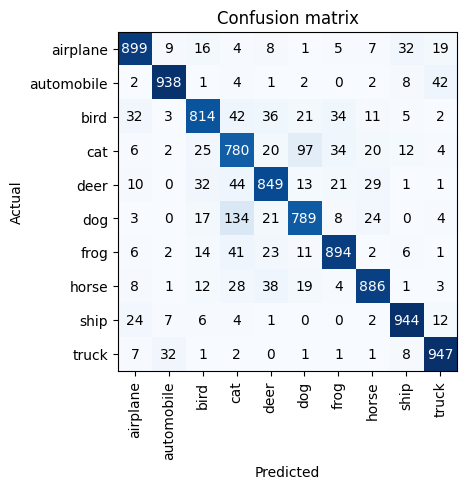

In [ ]:
#Evaluate the performance of the model:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

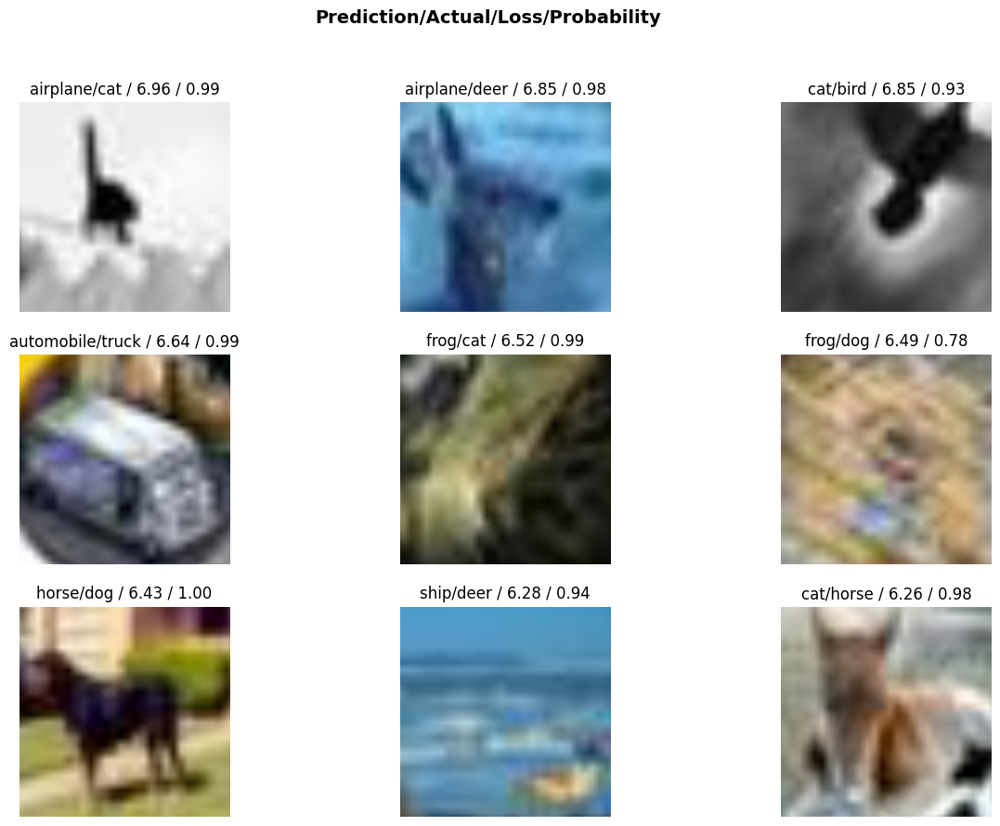

In [ ]:
interp = Interpretation.from_learner(learn)
interp.plot_top_losses(9, figsize=(15,10))

## Fine Tuning 2 {2.10 (lr=0.03) [0.878300]}
item_tfms=[RandomResizedCrop(224, min_scale=0.5), FlipItem(p=0.5), Resize(224)]

batch_tfms=[Normalize.from_stats(*imagenet_stats)]

dls2 = data.dataloaders(path, bs=128, item_tfms=Resize(460), batch_tfms=aug_transforms(size=224), verbose=True)

### Definim el DataBlock i Dataloader

In [ ]:
path = Path('/content')

In [ ]:
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),#com son les dades (entrada i etiquetes)
    get_items=get_image_files,#com llegeixes les imatges. To assemble our items inside the data block
    get_y=parent_label,#com aconsegueixes les etiquetes
    splitter=GrandparentSplitter(valid_name='validation'),#com separes entre validació i train
    item_tfms=[RandomResizedCrop(224, min_scale=0.5), FlipItem(p=0.5), Resize(224)],#transformacions a nivell d'imatge (canvis de mida, data augmentation)
    #This code includes a RandomResizedCrop transform to randomly crop and resize the images,
    #a FlipItem transform to randomly flip the images horizontally, and a Resize transform to ensure all images are the same size.
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]#transformacions a nivell de batch *aug_transforms(size=(240,320), aug_transforms())
)

In [ ]:
dls2 = data.dataloaders(path, bs=128, item_tfms=Resize(460), batch_tfms=aug_transforms(size=224), verbose=True)

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (224, 224), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> Resize -- {'size': (224, 224), 'method': 'crop', 'pad_mode': 'reflection', 'resamples': (2, 0), 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
dls2.vocab#per mirar el nom de les categories

['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']

### 2.0

SuggestedLRs(valley=0.0006918309954926372)

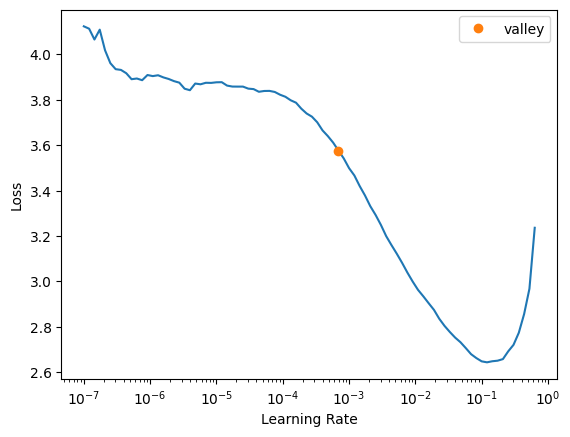

In [ ]:
learn2 = cnn_learner(dls2, vgg19, metrics=[accuracy, error_rate], pretrained=True)

#busquem quin és la millor learning rate
learn2.lr_find()

### 2.1 (lr=0.0006) [0.778200]

In [ ]:
learn2 = cnn_learner(dls2, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn2.fine_tune(epochs=3, base_lr=0.0006)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.416919,0.911264,0.684500,0.315500,04:26


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.087196,0.717052,0.746200,0.253800,10:47
1,0.911110,0.626627,0.774800,0.225200,10:46
2,0.852504,0.613298,0.778200,0.221800,10:47


In [16]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn2)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

### 2.2 (lr=0.0007) [0.790200]

In [ ]:
learn2 = cnn_learner(dls2, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn2.fine_tune(epochs=3, base_lr=0.0007)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.383742,0.892943,0.685500,0.314500,04:24


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.048084,0.697415,0.753600,0.246400,10:47
1,0.851517,0.607755,0.781300,0.218700,10:47
2,0.784380,0.589167,0.790200,0.209800,10:47


In [17]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn2)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

### 2.3 (lr=0.0008) [0.790800]

In [ ]:
learn2 = cnn_learner(dls2, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn2.fine_tune(epochs=3, base_lr=0.0008)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.367248,0.890733,0.689700,0.310300,04:25


epoch,train_loss,valid_loss,accuracy,error_rate,time


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.020277,0.685831,0.756900,0.243100,10:47
1,0.827182,0.594182,0.788200,0.211800,10:46
2,0.768703,0.582942,0.790800,0.209200,10:46


In [18]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn2)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

In [19]:
#interp = Interpretation.from_learner(learn2)
#interp.plot_top_losses(9, figsize=(15,10))

In [20]:
#learn2.show_results()

In [ ]:
#per prediure el test
#learn.predict(path/'train/000005.jpg')

### 2.4 (lr=0.001) [0.804400]

In [ ]:
learn2 = cnn_learner(dls2, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn2.fine_tune(epochs=3, base_lr=0.001)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.355699,0.859327,0.699800,0.300200,04:27


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.955720,0.655407,0.765400,0.234600,10:47
1,0.794985,0.574287,0.797600,0.202400,10:47
2,0.738386,0.552871,0.804400,0.195600,10:48


In [21]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn2)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

In [22]:
#interp = Interpretation.from_learner(learn2)
#interp.plot_top_losses(9, figsize=(15,10))

### 2.5 (lr=0.005) [0.855600]

In [ ]:
learn2 = cnn_learner(dls2, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn2.fine_tune(epochs=3, base_lr=0.005)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|█████

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.178608,0.868763,0.690000,0.310000,05:34


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.775442,0.600698,0.782100,0.217900,13:27
1,0.603518,0.444083,0.843500,0.156500,13:24
2,0.518036,0.419218,0.855600,0.144400,13:24


In [23]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn2)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

In [24]:
#interp = Interpretation.from_learner(learn2)
#interp.plot_top_losses(9, figsize=(15,10))

### 2.6 (lr=0.01) [0.866700]

In [ ]:
learn2 = cnn_learner(dls2, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn2.fine_tune(epochs=3, base_lr=0.01)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.215344,0.943951,0.667700,0.332300,05:33


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.776361,0.695159,0.770900,0.229100,13:26
1,0.577132,0.442025,0.846000,0.154000,13:26
2,0.458246,0.384580,0.866700,0.133300,13:25


In [25]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn2)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

In [26]:
#interp = Interpretation.from_learner(learn2)
#interp.plot_top_losses(9, figsize=(15,10))

### 2.7 (lr=0.015) [0.872500]

In [ ]:
learn2 = cnn_learner(dls2, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn2.fine_tune(epochs=3, base_lr=0.015)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.259900,0.904091,0.671300,0.328700,05:24


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.750827,0.589325,0.798000,0.202000,13:26
1,0.575047,0.443768,0.843900,0.156100,13:23
2,0.435690,0.372847,0.872500,0.127500,13:24


In [27]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn2)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

In [28]:
#interp = Interpretation.from_learner(learn2)
#interp.plot_top_losses(9, figsize=(15,10))

### 2.8 (lr=0.02) [0.876500]

In [ ]:
learn2 = cnn_learner(dls2, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn2.fine_tune(epochs=3, base_lr=0.02)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.214068,0.885299,0.679200,0.320800,05:32


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.764815,0.659284,0.770200,0.229800,13:24
1,0.596124,0.417782,0.853600,0.146400,13:24
2,0.425465,0.357719,0.876500,0.123500,13:24


In [29]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn2)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

In [30]:
#interp = Interpretation.from_learner(learn2)
#interp.plot_top_losses(9, figsize=(15,10))

### 2.9 (freeze_epochs=1) [0.827200]

In [ ]:
# Learner.fine_tune (epochs, base_lr=0.002, freeze_epochs=1, lr_mult=100, pct_start=0.3, div=5.0, lr_max=None,div_final=100000.0, wd=None, moms=None, cbs=None,reset_opt=False, start_epoch=0)
#base_lr=[0.001,0.005,0.01]
#freeze_epochs=[1,2,3]
#wd=[None,0.1,0.01,0.001]
#cbs=[EarlyStoppingCallback(patience=2)

In [ ]:
learn2 = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn2.fine_tune(epochs=3, freeze_epochs=1)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.236765,0.852901,0.700100,0.299900,05:14


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.836653,0.630574,0.779800,0.220200,12:54
1,0.697617,0.511347,0.816200,0.183800,12:54
2,0.610643,0.487117,0.827200,0.172800,12:53


In [31]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn2)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

### 2.10 (lr=0.03) [0.878300]

In [ ]:
learn2 = cnn_learner(dls2, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn2.fine_tune(epochs=3, base_lr=0.03)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.182958,0.904181,0.670100,0.329900,04:40


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.805295,0.651154,0.769800,0.230200,12:10
1,0.597062,0.473922,0.833400,0.166600,12:09
2,0.434432,0.356805,0.878300,0.121700,12:10


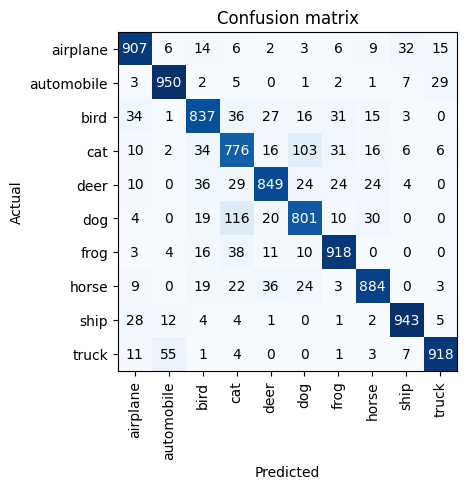

In [ ]:
#Evaluate the performance of the model:
interp = ClassificationInterpretation.from_learner(learn2)
interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

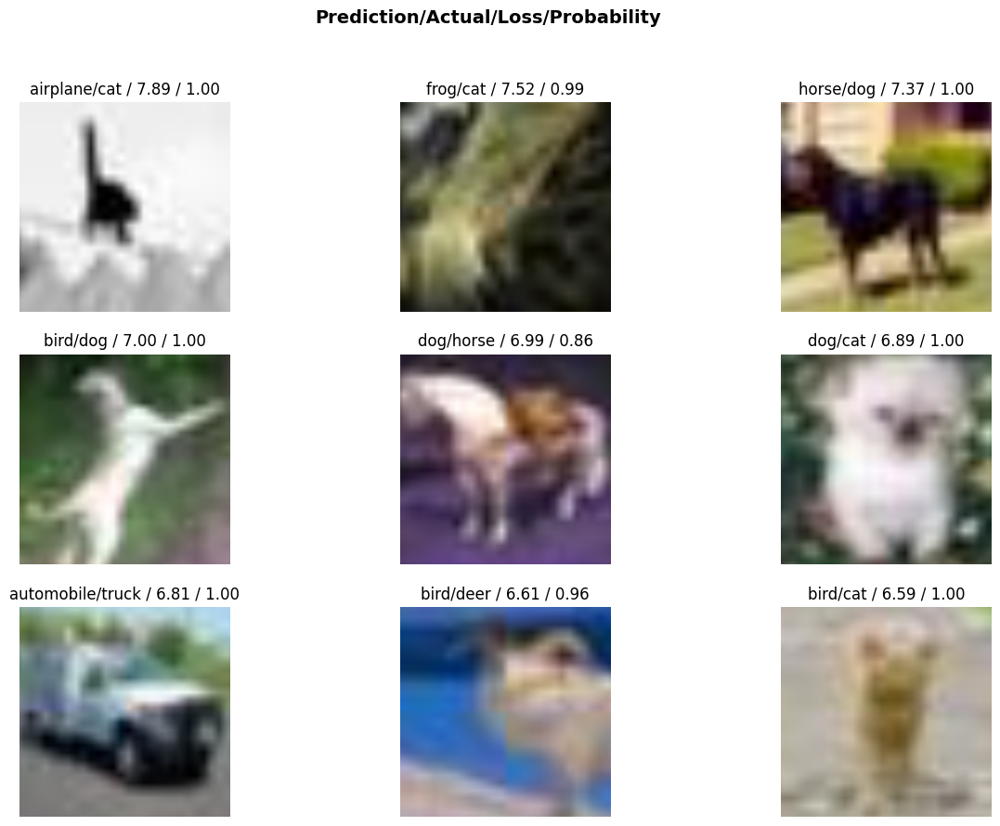

In [ ]:
interp = Interpretation.from_learner(learn2)
interp.plot_top_losses(9, figsize=(15,10))

## Fine Tuning 3 {3.6 (lr=0.03) [0.869800]}
item_tfms=[RandomResizedCrop(224, min_scale=0.5), FlipItem(p=0.5)],

batch_tfms=[*aug_transforms(), Normalize.from_stats(*imagenet_stats)]

dls3 = data.dataloaders(path, bs=128, item_tfms=[Resize(224, method='squish'), FlipItem(p=0.5), Normalize.from_stats(*imagenet_stats)], batch_tfms=[*aug_transforms(size=224, max_rotate=30.0, min_scale=0.75), Normalize.from_stats(*imagenet_stats)], verbose=True)

### Definim el DataBlock i Dataloader

In [ ]:
path = Path('/content')
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),#com son les dades (entrada i etiquetes)
    get_items=get_image_files,#com llegeixes les imatges. To assemble our items inside the data block
    get_y=parent_label,#com aconsegueixes les etiquetes
    splitter=GrandparentSplitter(valid_name='validation'),#com separes entre validació i train
    item_tfms=[RandomResizedCrop(224, min_scale=0.5), FlipItem(p=0.5)],#transformacions a nivell d'imatge (canvis de mida, data augmentation)
    #This code includes a RandomResizedCrop transform to randomly crop and resize the images,
    #a FlipItem transform to randomly flip the images horizontally, and a Resize transform to ensure all images are the same size.
    batch_tfms=[*aug_transforms(), Normalize.from_stats(*imagenet_stats)]#transformacions a nivell de batch *aug_transforms(size=(240,320), aug_transforms())
)
#dls3 = data.dataloaders(path, bs=128, item_tfms=Resize(460), batch_tfms=aug_transforms(size=224), verbose=True)
dls3 = data.dataloaders(path,
                        bs=128, # Decreased the batch size to fit into the GPU memory
                        item_tfms=[Resize(224, method='squish'), # Resizing the image to 224x224 while maintaining the aspect ratio
                                   FlipItem(p=0.5), # Randomly flip the image horizontally
                                   Normalize.from_stats(*imagenet_stats)], # Normalize the image using the ImageNet statistics
                        batch_tfms=[*aug_transforms(size=224, max_rotate=30.0, min_scale=0.75), # Apply a set of augmentation techniques to the batch
                                    Normalize.from_stats(*imagenet_stats)],# Normalize the batch again using the ImageNet statistics
                        verbose=True)

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (224, 224), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Flip -- {'size': None, 'mode': 'bilinear', 'pad_mode': 'reflection', 'mode_mask': 'nearest', 'align_corners': True, 'p': 0.5} -> Brightness -- {'max_lighting': 0.2, 'p': 1.0, 'draw': None, 'batch': False} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### 3.0

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|█████

SuggestedLRs(valley=0.0005754399462603033)

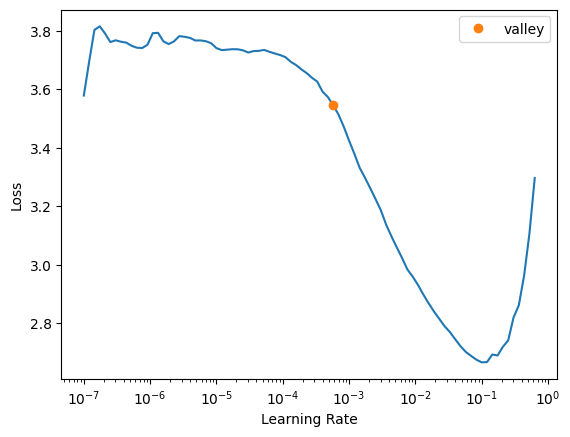

In [ ]:
learn3 = cnn_learner(dls3, vgg19, metrics=[accuracy, error_rate], pretrained=True)

#busquem quin és la millor learning rate
learn3.lr_find()

### 3.1 (lr=0.001)[0.794500]

In [ ]:
learn3 = cnn_learner(dls3, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn3.fine_tune(epochs=3, base_lr=0.001)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.444630,0.920686,0.680700,0.319300,05:15


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.086886,0.708303,0.748200,0.251800,12:33
1,0.883192,0.594958,0.786900,0.213100,12:35
2,0.817578,0.578859,0.794500,0.205500,12:37


In [32]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn3)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

In [33]:
#interp = Interpretation.from_learner(learn3)
#interp.plot_top_losses(9, figsize=(15,10))

### 3.2 (lr=0.005) [0.845600]

In [ ]:
learn3 = cnn_learner(dls3, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn3.fine_tune(epochs=3, base_lr=0.005)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.269878,0.916242,0.666600,0.333400,04:59


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.861606,0.654022,0.767900,0.232100,13:17
1,0.672512,0.478797,0.832400,0.167600,13:16
2,0.594719,0.434058,0.845600,0.154400,13:18


In [34]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn3)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

In [35]:
#interp = Interpretation.from_learner(learn3)
#interp.plot_top_losses(9, figsize=(15,10))

### 3.3 (lr=0.01) [0.858800]

In [ ]:
learn3 = cnn_learner(dls3, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn3.fine_tune(epochs=3, base_lr=0.01)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.313567,0.935297,0.673000,0.327000,05:12


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.842774,0.583986,0.796800,0.203200,13:49
1,0.666095,0.466302,0.837800,0.162200,13:45
2,0.539609,0.402473,0.858800,0.141200,13:46


In [36]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn3)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

In [37]:
#interp = Interpretation.from_learner(learn3)
#interp.plot_top_losses(9, figsize=(15,10))

### 3.4 (lr=0.015) [0.867500]

In [ ]:
learn3 = cnn_learner(dls3, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn3.fine_tune(epochs=3, base_lr=0.015)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.349346,0.967819,0.656200,0.343800,04:57


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.840018,0.594187,0.786900,0.213100,12:39
1,0.642810,0.492112,0.827700,0.172300,12:35
2,0.513113,0.386049,0.867500,0.132500,12:32


In [38]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn3)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

In [39]:
#interp = Interpretation.from_learner(learn3)
#interp.plot_top_losses(9, figsize=(15,10))

### 3.5 (lr=0.02) [0.869100]

In [ ]:
learn3 = cnn_learner(dls3, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn3.fine_tune(epochs=3, base_lr=0.02)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.306994,0.932178,0.671000,0.329000,04:57


epoch,train_loss,valid_loss,accuracy,error_rate,time


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.840873,0.749848,0.745300,0.254700,12:31
1,0.638309,0.459168,0.840400,0.159600,12:31
2,0.495542,0.373837,0.869100,0.130900,12:31


In [40]:
#Evaluate the performance of the model:
#interp = ClassificationInterpretation.from_learner(learn3)
#interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

In [41]:
#interp = Interpretation.from_learner(learn3)
#interp.plot_top_losses(9, figsize=(15,10))

### 3.6 (lr=0.03) [0.869800]

In [ ]:
learn3 = cnn_learner(dls3, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn3.fine_tune(epochs=3, base_lr=0.03)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.275452,0.943229,0.659700,0.340300,04:59


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.865219,0.769233,0.723100,0.276900,12:04
1,0.667476,0.526192,0.818200,0.181800,12:02
2,0.489983,0.367354,0.869800,0.130200,12:03


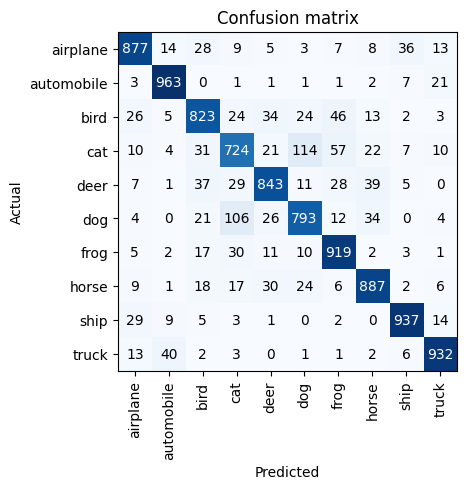

In [ ]:
#Evaluate the performance of the model:
interp = ClassificationInterpretation.from_learner(learn3)
interp.plot_confusion_matrix()#This will show you the confusion matrix and other performance metrics for your model.

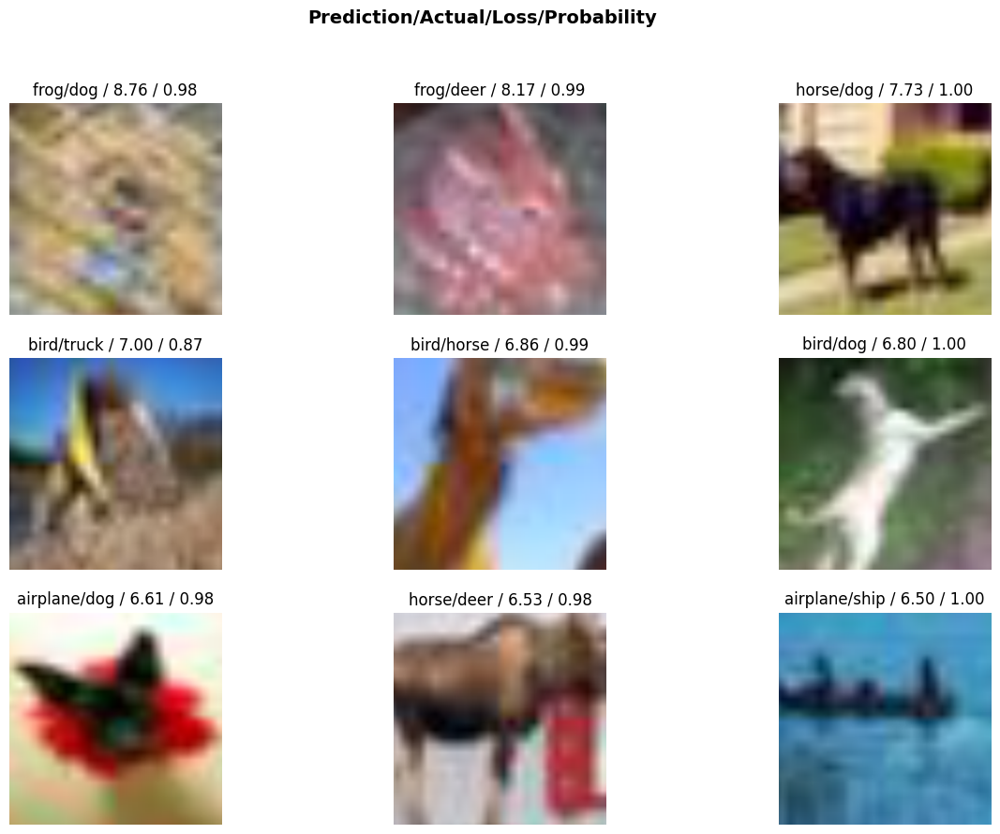

In [ ]:
interp = Interpretation.from_learner(learn3)
interp.plot_top_losses(9, figsize=(15,10))

## Fine tuning 4 (progresive resizing) {[0.908600]}
Iteració 1 (lr=0.01, bs=128, size=128) [0.895800]

Iteració 2 (lr=0.015, bs=128, size=256) [0.906100]

Iteració 3 (lr=0.01, bs=64, size=512) [0.908600]

item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],

batch_tfms=[Normalize.from_stats(*imagenet_stats)]

dls4 = data_block.dataloaders(path, bs=128, num_workers=4, verbose=True, batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True,), Normalize.from_stats(*imagenet_stats)], item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

### Definim el DataBlock i Dataloader

In [ ]:
path = Path('/content')
data_block = DataBlock(blocks=(ImageBlock, CategoryBlock),
                       get_items=get_image_files,
                       splitter=GrandparentSplitter(valid_name='validation'),
                       get_y=parent_label,
                       item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],
                       batch_tfms=[Normalize.from_stats(*imagenet_stats)])

dls4 = data_block.dataloaders(path, bs=128, num_workers=4, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.02, bs=128, size=128) [0.895800]

In [ ]:
learn4 = cnn_learner(dls4, vgg19, metrics=[accuracy, error_rate], pretrained=True)
learn4.fine_tune(epochs=3, base_lr=0.02)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.113528,0.883850,0.691900,0.308100,01:42


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.647079,0.513700,0.823100,0.176900,03:45
1,0.471131,0.384548,0.868900,0.131100,03:46
2,0.334178,0.308315,0.895800,0.104200,03:47


In [42]:
#interp = ClassificationInterpretation.from_learner(learn4)
#interp.plot_confusion_matrix()

In [43]:
#interp = Interpretation.from_learner(learn4)
#interp.plot_top_losses(9, figsize=(15,10))

### Iteració 2 (lr=0.015, bs=128, size=256) [0.906100]

In [ ]:
dls4 = data_block.dataloaders(path, bs=128, num_workers=4, verbose=True,
                             batch_tfms=[*aug_transforms(size=256, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])
# Step 4: Fine-tune the model with larger image size
learn4.dls = dls4
learn4.fine_tune(epochs=3, base_lr=0.015)

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.359053,0.339493,0.885600,0.114400,01:49


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.405704,0.523330,0.831500,0.168500,03:48
1,0.323816,0.319958,0.890400,0.109600,03:50
2,0.231966,0.281553,0.906100,0.093900,03:48


In [44]:
#interp = ClassificationInterpretation.from_learner(learn4)
#interp.plot_confusion_matrix()

In [45]:
#interp = Interpretation.from_learner(learn4)
#interp.plot_top_losses(9, figsize=(15,10))

### Iteració 3 (lr=0.01, bs=64, size=512) [0.908600]

In [ ]:
dls4 = data_block.dataloaders(path, bs=64, num_workers=4, verbose=True,
                             batch_tfms=[*aug_transforms(size=512, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])
# Step 6: Fine-tune the model with even larger image size
learn4.dls = dls4
learn4.fine_tune(epochs=3, base_lr=0.01)

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.290025,0.337257,0.895800,0.104200,01:57


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.385342,0.420756,0.862000,0.138000,03:52
1,0.320087,0.336791,0.885700,0.114300,03:52
2,0.205468,0.278632,0.908600,0.091400,03:51


In [46]:
#interp = ClassificationInterpretation.from_learner(learn4)
#interp.plot_confusion_matrix()

In [47]:
#interp = Interpretation.from_learner(learn4)
#interp.plot_top_losses(9, figsize=(15,10))

## Param Tuning 2 {Iteration 1/8 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'dropout': 0.0, 'batch_size': 128} [0.9000]}
when 'learning_rate'=0.02 --> mean(acc)=0.8974;
{{{when 'learning_rate'=0.03 --> mean(acc)=0.897925}}}

{{{when 'weight_decay'=0 --> mean(acc)=0.898575}}};
when 'weight_decay'=0 --> mean(acc)=0.89675

{{{when 'dropout'=0 --> mean(acc)=0.89865}}};
when 'dropout'=0.1 --> mean(acc)=0.896675

### Define datablock, dataloader and params



In [ ]:
from fastai.vision.all import *
from fastai.data.block import DataBlock
from sklearn.model_selection import ParameterSampler
import random
from sklearn.model_selection import ParameterGrid

In [ ]:
# Define the hyperparameter space to search over
param_grid = {
    'batch_size': [128],
    'learning_rate': [0.02,0.03],
    'weight_decay': [0.0, 0.001],
    'dropout': [0.0, 0.1],
}

In [ ]:
# Create a data block and data loaders with default parameters
path = Path('/content')
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    get_y=parent_label,
    splitter=GrandparentSplitter(valid_name='validation'),
    item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]
)
dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
# Define the number of random combinations to try
n_iter = len(list(ParameterGrid(param_grid)))

# Generate random combinations of hyperparameters
param_list = list(ParameterSampler(param_grid, n_iter=n_iter, random_state=42))

In [ ]:
param_list

[{'weight_decay': 0.0,
  'learning_rate': 0.02,
  'dropout': 0.0,
  'batch_size': 128},
 {'weight_decay': 0.001,
  'learning_rate': 0.02,
  'dropout': 0.0,
  'batch_size': 128},
 {'weight_decay': 0.0,
  'learning_rate': 0.03,
  'dropout': 0.0,
  'batch_size': 128},
 {'weight_decay': 0.001,
  'learning_rate': 0.03,
  'dropout': 0.0,
  'batch_size': 128},
 {'weight_decay': 0.0,
  'learning_rate': 0.02,
  'dropout': 0.1,
  'batch_size': 128},
 {'weight_decay': 0.001,
  'learning_rate': 0.02,
  'dropout': 0.1,
  'batch_size': 128},
 {'weight_decay': 0.0,
  'learning_rate': 0.03,
  'dropout': 0.1,
  'batch_size': 128},
 {'weight_decay': 0.001,
  'learning_rate': 0.03,
  'dropout': 0.1,
  'batch_size': 128}]

### Model

In [ ]:
learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True)

In [ ]:
# Loop over the hyperparameter combinations
for i, params in enumerate(param_list):
    print(f'Iteration {i+1}/{n_iter} with params: {params}')

    # Update the data loaders with the current hyperparameters
    dls = data.dataloaders(path, bs=params['batch_size'], num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])


    # Create a simple model with the current hyperparameters
    learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True, ps=params['dropout'])

    # Fit the model with the current hyperparameters
    learn.fine_tune(3, base_lr=params['learning_rate'], wd=params['weight_decay'])

    # Evaluate the model on the validation set
    acc = learn.validate()[1]
    print(f'Accuracy: {acc:.4f}')

    # Save the model and accuracy for later analysis
    learn.save(f'model_{i+1}')
    with open(f'accuracy_{i+1}.txt', 'w') as f:
        f.write(str(acc))


Iteration 1/8 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.946634,0.829050,0.706900,0.293100,01:45


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.586015,0.530263,0.814400,0.185600,03:54
1,0.426541,0.405358,0.861500,0.138500,03:54
2,0.276133,0.295801,0.900000,0.100000,03:54


Accuracy: 0.9000
Iteration 2/8 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.935416,0.817765,0.712500,0.287500,01:44


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.584289,0.586515,0.798700,0.201300,03:52
1,0.431226,0.401539,0.865500,0.134500,03:53
2,0.276535,0.296291,0.898900,0.101100,03:52


Accuracy: 0.8989
Iteration 3/8 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.931398,0.824318,0.713200,0.286800,01:45


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.641718,0.739067,0.765900,0.234100,03:53
1,0.457589,0.393312,0.863400,0.136600,03:51
2,0.291931,0.296127,0.898700,0.101300,03:51


Accuracy: 0.8987
Iteration 4/8 with params: {'weight_decay': 0.001, 'learning_rate': 0.03, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.937723,0.808380,0.714700,0.285300,01:43


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.628786,0.648208,0.781100,0.218900,03:52
1,0.448634,0.404610,0.865600,0.134400,03:52
2,0.274760,0.298553,0.897000,0.103000,03:51


Accuracy: 0.8970
Iteration 5/8 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'dropout': 0.1, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.957385,0.824799,0.709200,0.290800,01:43


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.609082,0.611332,0.789000,0.211000,03:52
1,0.445243,0.413431,0.855000,0.145000,03:51
2,0.291081,0.304649,0.896500,0.103500,03:53


Accuracy: 0.8965
Iteration 6/8 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'dropout': 0.1, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.975504,0.812308,0.714400,0.285600,01:45


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.618837,0.580205,0.797400,0.202600,03:51
1,0.435539,0.369225,0.870600,0.129400,03:52
2,0.292934,0.300889,0.894200,0.105800,03:52


Accuracy: 0.8942
Iteration 7/8 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'dropout': 0.1, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.963760,0.808963,0.714100,0.285900,01:43


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.638880,0.611496,0.789100,0.210900,03:52
1,0.459820,0.377727,0.863500,0.136500,03:51
2,0.296455,0.296310,0.899100,0.100900,03:53


Accuracy: 0.8991
Iteration 8/8 with params: {'weight_decay': 0.001, 'learning_rate': 0.03, 'dropout': 0.1, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.958378,0.826348,0.704100,0.295900,01:47


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.647102,0.606573,0.789300,0.210700,03:52
1,0.463950,0.382615,0.870900,0.129100,03:52
2,0.295626,0.303871,0.896900,0.103100,03:52


Accuracy: 0.8969


{{Iteration 1/8 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'dropout': 0.0, 'batch_size': 128} [0.9000]}}

Iteration 2/8 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'dropout': 0.0, 'batch_size': 128} [0.8989]

Iteration 3/8 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'dropout': 0.0, 'batch_size': 128} [0.8987]

Iteration 4/8 with params: {'weight_decay': 0.001, 'learning_rate': 0.03, 'dropout': 0.0, 'batch_size': 128} [0.8970]


Iteration 5/8 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'dropout': 0.1, 'batch_size': 128} [0.8965]

Iteration 6/8 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'dropout': 0.1, 'batch_size': 128} [0.8942]

Iteration 7/8 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'dropout': 0.1, 'batch_size': 128} [0.8991]

Iteration 8/8 with params: {'weight_decay': 0.001, 'learning_rate': 0.03, 'dropout': 0.1, 'batch_size': 128} [0.8969]


when 'learning_rate'=0.02 --> mean(acc)=0.8974;
{{{when 'learning_rate'=0.03 --> mean(acc)=0.897925}}}

{{{when 'weight_decay'=0 --> mean(acc)=0.898575}}};
when 'weight_decay'=0 --> mean(acc)=0.89675

{{{when 'dropout'=0 --> mean(acc)=0.89865}}};
when 'dropout'=0.1 --> mean(acc)=0.896675

best combination= Iteration 1/8 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'dropout': 0.0, 'batch_size': 128} [0.9000]

## Param Tuning 4 (lr and freeze epochs) {Iteration 3/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128} [0.9008]}
learning_rate=0.02-->mean(acc)=0.8986;
learning_rate=0.03-->mean(acc)=0.8991;
{{learning_rate=0.04-->mean(acc)=0.9004}}

freeze_epochs=1-->mean(acc)=0.8982;
{{freeze_epochs=2-->mean(acc)=0.9001}};
freeze_epochs=3-->mean(acc)=0.8999


### Define datablock, dataloader and params



In [ ]:
from fastai.vision.all import *
from fastai.data.block import DataBlock
from sklearn.model_selection import ParameterSampler
import random
from sklearn.model_selection import ParameterGrid

In [ ]:
# Define the hyperparameter space to search over
param_grid = {
    'batch_size': [128],
    'learning_rate': [0.02,0.03,0.04],
    'weight_decay': [0.0],
    'dropout': [0.0],
    'freeze_epochs':[1,2,3]
}

In [ ]:
# Create a data block and data loaders with default parameters
path = Path('/content')
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    get_y=parent_label,
    splitter=GrandparentSplitter(valid_name='validation'),
    item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]
)
dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
# Define the number of random combinations to try
n_iter = len(list(ParameterGrid(param_grid)))

# Generate random combinations of hyperparameters
param_list = list(ParameterSampler(param_grid, n_iter=n_iter, random_state=42))

In [ ]:
len(list(ParameterGrid(param_grid)))

9

In [ ]:
param_list

[{'weight_decay': 0.0,
  'learning_rate': 0.02,
  'freeze_epochs': 1,
  'dropout': 0.0,
  'batch_size': 128},
 {'weight_decay': 0.0,
  'learning_rate': 0.03,
  'freeze_epochs': 1,
  'dropout': 0.0,
  'batch_size': 128},
 {'weight_decay': 0.0,
  'learning_rate': 0.04,
  'freeze_epochs': 1,
  'dropout': 0.0,
  'batch_size': 128},
 {'weight_decay': 0.0,
  'learning_rate': 0.02,
  'freeze_epochs': 2,
  'dropout': 0.0,
  'batch_size': 128},
 {'weight_decay': 0.0,
  'learning_rate': 0.03,
  'freeze_epochs': 2,
  'dropout': 0.0,
  'batch_size': 128},
 {'weight_decay': 0.0,
  'learning_rate': 0.04,
  'freeze_epochs': 2,
  'dropout': 0.0,
  'batch_size': 128},
 {'weight_decay': 0.0,
  'learning_rate': 0.02,
  'freeze_epochs': 3,
  'dropout': 0.0,
  'batch_size': 128},
 {'weight_decay': 0.0,
  'learning_rate': 0.03,
  'freeze_epochs': 3,
  'dropout': 0.0,
  'batch_size': 128},
 {'weight_decay': 0.0,
  'learning_rate': 0.04,
  'freeze_epochs': 3,
  'dropout': 0.0,
  'batch_size': 128}]

### Model

In [ ]:
#learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True)

In [ ]:
# Loop over the hyperparameter combinations
for i, params in enumerate(param_list):
    print(f'Iteration {i+1}/{n_iter} with params: {params}')

    # Update the data loaders with the current hyperparameters
    dls = data.dataloaders(path, bs=params['batch_size'], num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])


    # Create a simple model with the current hyperparameters
    learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True, ps=params['dropout'])

    # Fit the model with the current hyperparameters
    learn.fine_tune(3, base_lr=params['learning_rate'], wd=params['weight_decay'], freeze_epochs=params['freeze_epochs'])

    # Evaluate the model on the validation set
    acc = learn.validate()[1]
    print(f'Accuracy: {acc:.4f}')

    # Save the model and accuracy for later analysis
    learn.save(f'model_{i+1}')
    with open(f'accuracy_{i+1}.txt', 'w') as f:
        f.write(str(acc))


Iteration 1/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|█████

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.938329,0.802211,0.722700,0.277300,01:51


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.599429,0.532339,0.812700,0.187300,03:52
1,0.442730,0.370916,0.870500,0.129500,03:51
2,0.296165,0.300980,0.895300,0.104700,03:55


Accuracy: 0.8953
Iteration 2/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.928934,0.842078,0.705400,0.294600,01:47


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.651340,0.670837,0.777100,0.222900,03:54
1,0.455054,0.366585,0.872500,0.127500,03:51
2,0.281494,0.296031,0.898500,0.101500,03:52


Accuracy: 0.8985
Iteration 3/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.965311,0.855938,0.700000,0.300000,01:52


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.685837,0.693256,0.771000,0.229000,03:53
1,0.473759,0.458307,0.843100,0.156900,03:51
2,0.289535,0.300432,0.900800,0.099200,03:52


Accuracy: 0.9008
Iteration 4/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 2, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.951908,0.845050,0.703400,0.296600,01:45
1,0.856473,0.779339,0.723900,0.276100,01:56


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.573498,0.529489,0.818800,0.181200,03:54
1,0.428968,0.385254,0.868600,0.131400,03:53
2,0.287761,0.295746,0.900700,0.099300,03:52


Accuracy: 0.9007
Iteration 5/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.969676,0.890316,0.700600,0.299400,01:49
1,0.880920,0.775110,0.722900,0.277100,01:46


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.614603,0.741038,0.756000,0.244000,03:52
1,0.454328,0.451287,0.848600,0.151400,03:52
2,0.292795,0.293823,0.899400,0.100600,03:51


Accuracy: 0.8994
Iteration 6/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 2, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.961540,0.836915,0.706800,0.293200,01:45
1,0.920428,0.835867,0.706300,0.293700,01:44


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.665033,0.532197,0.818700,0.181300,03:51
1,0.470262,0.383597,0.864800,0.135200,03:51
2,0.296653,0.290187,0.900100,0.099900,03:51


Accuracy: 0.9001
Iteration 7/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 3, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.916929,0.815792,0.717200,0.282800,01:44
1,0.880290,0.788203,0.721800,0.278200,01:46
2,0.844852,0.765505,0.731400,0.268600,01:45


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.581800,0.480119,0.833300,0.166700,03:52
1,0.426355,0.389408,0.867700,0.132300,03:52
2,0.269384,0.303160,0.899800,0.100200,03:51


Accuracy: 0.8998
Iteration 8/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.934686,0.880421,0.699800,0.300200,01:45
1,0.870784,0.788449,0.721200,0.278800,01:44
2,0.858692,0.768032,0.734000,0.266000,01:47


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.605693,0.580020,0.804200,0.195800,03:52
1,0.458359,0.378271,0.873700,0.126300,03:51
2,0.282700,0.295274,0.899400,0.100600,03:52


Accuracy: 0.8994
Iteration 9/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 3, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.945063,0.868001,0.704800,0.295200,01:45
1,0.900970,0.850876,0.705400,0.294600,01:45
2,0.890160,0.802597,0.720600,0.279400,01:44


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.652015,0.768652,0.756000,0.244000,03:52
1,0.471230,0.428670,0.857200,0.142800,03:51
2,0.284850,0.296816,0.900400,0.099600,03:51


Accuracy: 0.9004


Iteration 1/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128} [0.8953]

Iteration 2/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128} [0.8985]

{{Iteration 3/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128} [0.9008]}}

Iteration 4/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 2, 'dropout': 0.0, 'batch_size': 128} [0.9007]

Iteration 5/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.0, 'batch_size': 128} [0.8994]


Iteration 6/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 2, 'dropout': 0.0, 'batch_size': 128} [0.9001]

Iteration 7/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 3, 'dropout': 0.0, 'batch_size': 128} [0.8998]

Iteration 8/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.0, 'batch_size': 128} [0.8994]

Iteration 9/9 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 3, 'dropout': 0.0, 'batch_size': 128} [0.9004]

learning_rate=0.02-->mean(acc)=0.8986;
learning_rate=0.03-->mean(acc)=0.8991;
{{learning_rate=0.04-->mean(acc)=0.9004}}

freeze_epochs=1-->mean(acc)=0.8982;
{{freeze_epochs=2-->mean(acc)=0.9001}};
freeze_epochs=3-->mean(acc)=0.8999

## Param Tuning 5 {Iteration 5/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 2, 'epochs': 7, 'dropout': 0.0, 'batch_size': 128} [0.9147]} (not finished)
    'batch_size': [128,256],
    'learning_rate': [0.02,0.04],
    'weight_decay': [0.0],
    'dropout': [0.0],
    'freeze_epochs':[2],
    'epochs':[3,5,7]



### Define datablock, dataloader and params



In [ ]:
from fastai.vision.all import *
from fastai.data.block import DataBlock
from sklearn.model_selection import ParameterSampler
import random
from sklearn.model_selection import ParameterGrid

In [ ]:
# Define the hyperparameter space to search over
param_grid = {
    'batch_size': [128,256],
    'learning_rate': [0.02,0.04],
    'weight_decay': [0.0],
    'dropout': [0.0],
    'freeze_epochs':[2],
    'epochs':[3,5,7]
}

In [ ]:
# Create a data block and data loaders with default parameters
path = Path('/content')
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    get_y=parent_label,
    splitter=GrandparentSplitter(valid_name='validation'),
    item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]
)
dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
# Define the number of random combinations to try
n_iter = len(list(ParameterGrid(param_grid)))

# Generate random combinations of hyperparameters
param_list = list(ParameterSampler(param_grid, n_iter=n_iter, random_state=42))

In [ ]:
len(list(ParameterGrid(param_grid)))

12

### Model

In [ ]:
# Loop over the hyperparameter combinations
for i, params in enumerate(param_list):
    print(f'Iteration {i+1}/{n_iter} with params: {params}')

    # Update the data loaders with the current hyperparameters
    dls = data.dataloaders(path, bs=params['batch_size'], num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])


    # Create a simple model with the current hyperparameters
    learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True, ps=params['dropout'])

    # Fit the model with the current hyperparameters
    learn.fine_tune(params['epochs'], base_lr=params['learning_rate'], wd=params['weight_decay'], freeze_epochs=params['freeze_epochs'])

    # Evaluate the model on the validation set
    acc = learn.validate()[1]
    print(f'Accuracy: {acc:.4f}')

    # Save the model and accuracy for later analysis
    learn.save(f'model_{i+1}')
    with open(f'accuracy_{i+1}.txt', 'w') as f:
        f.write(str(acc))


Iteration 1/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 2, 'epochs': 3, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.943687,0.834675,0.711200,0.288800,01:52
1,0.857217,0.775267,0.733000,0.267000,01:47


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.590162,0.727684,0.759600,0.240400,04:00
1,0.422132,0.365450,0.870700,0.129300,03:59
2,0.279728,0.300893,0.897400,0.102600,03:59


Accuracy: 0.8974
Iteration 2/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 2, 'epochs': 3, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.959968,0.839621,0.708900,0.291100,01:46
1,0.921667,0.800452,0.716600,0.283400,01:46


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.674920,0.626235,0.787500,0.212500,03:59
1,0.486115,0.422237,0.854700,0.145300,03:58
2,0.291660,0.290312,0.899900,0.100100,03:58


Accuracy: 0.8999
Iteration 3/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 2, 'epochs': 5, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.928315,0.915754,0.691100,0.308900,01:46
1,0.861651,0.772105,0.722900,0.277100,01:46


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.555682,0.491932,0.832500,0.167500,03:59
1,0.496305,0.446837,0.842900,0.157100,03:59
2,0.367488,0.372789,0.870500,0.129500,03:59
3,0.253293,0.301917,0.895800,0.104200,04:00
4,0.187076,0.278544,0.906100,0.093900,03:59


Accuracy: 0.9061
Iteration 4/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 2, 'epochs': 5, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.964869,0.829734,0.706600,0.293400,01:47
1,0.945099,0.801742,0.717800,0.282200,01:47


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.600511,0.595136,0.791600,0.208400,04:00
1,0.581814,0.567505,0.809800,0.190200,03:58
2,0.440113,0.406493,0.864100,0.135900,03:58
3,0.287162,0.301038,0.898700,0.101300,03:58
4,0.201154,0.270203,0.911100,0.088900,03:58


Accuracy: 0.9111
Iteration 5/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 2, 'epochs': 7, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.969242,0.858313,0.697900,0.302100,01:46
1,0.873779,0.786370,0.726400,0.273600,01:46


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.537300,0.544964,0.810700,0.189300,04:00
1,0.506042,0.479120,0.839600,0.160400,03:59
2,0.447090,0.461995,0.841700,0.158300,03:59
3,0.348716,0.383954,0.869100,0.130900,03:59
4,0.261976,0.291907,0.898600,0.101400,03:58
5,0.170569,0.281599,0.908900,0.091100,03:59
6,0.138224,0.272667,0.914700,0.085300,03:59


Accuracy: 0.9147
Iteration 6/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 2, 'epochs': 7, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.958306,0.847852,0.700900,0.299100,01:46
1,0.943797,0.901036,0.689500,0.310500,01:46


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.555426,0.596225,0.798900,0.201100,04:00
1,0.595704,0.986236,0.696700,0.303300,03:59
2,0.509020,0.465724,0.842400,0.157600,03:58
3,0.417332,0.595822,0.807600,0.192400,03:58
4,0.301155,0.308717,0.896700,0.103300,03:58
5,0.195832,0.273789,0.911100,0.088900,03:58
6,0.148659,0.270174,0.913200,0.086800,03:58


Accuracy: 0.9132
Iteration 7/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 2, 'epochs': 3, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.933087,0.829914,0.708800,0.291200,01:48


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.933087,0.829914,0.708800,0.291200,01:48
1,0.846539,0.731464,0.734900,0.265100,01:48


epoch,train_loss,valid_loss,accuracy,error_rate,time


Iteration 1/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 2, 'epochs': 3, 'dropout': 0.0, 'batch_size': 128} [0.8974]

Iteration 2/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 2, 'epochs': 3, 'dropout': 0.0, 'batch_size': 128} [0.8999]

Iteration 3/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 2, 'epochs': 5, 'dropout': 0.0, 'batch_size': 128} [0.9061]

Iteration 4/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 2, 'epochs': 5, 'dropout': 0.0, 'batch_size': 128} [0.9111]

{{Iteration 5/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 2, 'epochs': 7, 'dropout': 0.0, 'batch_size': 128} [0.9147]}}

Iteration 6/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 2, 'epochs': 7, 'dropout': 0.0, 'batch_size': 128} []

## Param Tuning 6 {Iteration 6/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 2, 'epochs': 7, 'dropout': 0.0, 'batch_size': 256} [0.9156]}
    'batch_size': [256],
    'learning_rate': [0.02,0.04],
    'weight_decay': [0.0],
    'dropout': [0.0],
    'freeze_epochs':[2],
    'epochs':[3,5,7]

learning rate=0.02-->[0.901967]
{{learning rate=0.04-->[0.9071]}}

epochs=3-->[0.8936]
epochs=5-->[0.9066]
{{epochs=7-->[0.9134]}}

### Define datablock, dataloader and params



In [ ]:
from fastai.vision.all import *
from fastai.data.block import DataBlock
from sklearn.model_selection import ParameterSampler
import random
from sklearn.model_selection import ParameterGrid

In [ ]:
# Define the hyperparameter space to search over
param_grid = {
    'batch_size': [256],
    'learning_rate': [0.02,0.04],
    'weight_decay': [0.0],
    'dropout': [0.0],
    'freeze_epochs':[2],
    'epochs':[3,5,7]
}

In [ ]:
# Create a data block and data loaders with default parameters
path = Path('/content')
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    get_y=parent_label,
    splitter=GrandparentSplitter(valid_name='validation'),
    item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]
)
dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
# Define the number of random combinations to try
n_iter = len(list(ParameterGrid(param_grid)))

# Generate random combinations of hyperparameters
param_list = list(ParameterSampler(param_grid, n_iter=n_iter, random_state=42))

In [ ]:
len(list(ParameterGrid(param_grid)))

6

### Model

In [ ]:
# Loop over the hyperparameter combinations
for i, params in enumerate(param_list):
    print(f'Iteration {i+1}/{n_iter} with params: {params}')

    # Update the data loaders with the current hyperparameters
    dls = data.dataloaders(path, bs=params['batch_size'], num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])


    # Create a simple model with the current hyperparameters
    learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True, ps=params['dropout'])

    # Fit the model with the current hyperparameters
    learn.fine_tune(params['epochs'], base_lr=params['learning_rate'], wd=params['weight_decay'], freeze_epochs=params['freeze_epochs'])

    # Evaluate the model on the validation set
    acc = learn.validate()[1]
    print(f'Accuracy: {acc:.4f}')

    # Save the model and accuracy for later analysis
    learn.save(f'model_{i+1}')
    with open(f'accuracy_{i+1}.txt', 'w') as f:
        f.write(str(acc))


Iteration 1/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 2, 'epochs': 3, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:12<00:00, 45.5MB/s]


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.920302,0.869305,0.703700,0.296300,01:55
1,0.845694,0.744436,0.735800,0.264200,01:49


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.568927,0.518403,0.823100,0.176900,03:36
1,0.427968,0.371130,0.871500,0.128500,03:38
2,0.287480,0.316442,0.890900,0.109100,03:36


Accuracy: 0.8909
Iteration 2/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 2, 'epochs': 3, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.954866,0.895423,0.706400,0.293600,01:37
1,0.852258,0.792027,0.721000,0.279000,01:37


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.602559,0.619409,0.794200,0.205800,04:04
1,0.446736,0.384779,0.864400,0.135600,04:03
2,0.289621,0.302128,0.896300,0.103700,04:02


Accuracy: 0.8963
Iteration 3/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 2, 'epochs': 5, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.928177,0.828834,0.712200,0.287800,01:48
1,0.847322,0.747492,0.735800,0.264200,01:49


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.537986,0.489543,0.827000,0.173000,04:08
1,0.473042,0.467928,0.843300,0.156700,04:13
2,0.373864,0.398916,0.864200,0.135800,04:17
3,0.266454,0.307608,0.898700,0.101300,04:07
4,0.192245,0.292562,0.903800,0.096200,04:05


Accuracy: 0.9038
Iteration 4/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 2, 'epochs': 5, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.943391,0.860464,0.700900,0.299100,01:49
1,0.848773,0.796878,0.719500,0.280500,01:49


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.569055,0.609606,0.795700,0.204300,04:07
1,0.521899,0.545162,0.816300,0.183700,04:04
2,0.416990,0.409831,0.861900,0.138100,04:04
3,0.279608,0.304140,0.897300,0.102700,04:04
4,0.194692,0.277777,0.909400,0.090600,04:05


Accuracy: 0.9094
Iteration 5/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 2, 'epochs': 7, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.920814,0.821369,0.720700,0.279300,01:37
1,0.854896,0.774819,0.728900,0.271100,01:37


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.528525,0.459347,0.838000,0.162000,03:59
1,0.497080,0.520664,0.820800,0.179200,03:59
2,0.405563,0.404231,0.861800,0.138200,04:01
3,0.328933,0.360795,0.875000,0.125000,03:58
4,0.244321,0.314533,0.898500,0.101500,03:58


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.528525,0.459347,0.838000,0.162000,03:59
1,0.497080,0.520664,0.820800,0.179200,03:59
2,0.405563,0.404231,0.861800,0.138200,04:01
3,0.328933,0.360795,0.875000,0.125000,03:58
4,0.244321,0.314533,0.898500,0.101500,03:58
5,0.171401,0.288331,0.906200,0.093800,03:58
6,0.139811,0.281814,0.911200,0.088800,03:58


Accuracy: 0.9112
Iteration 6/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 2, 'epochs': 7, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.955747,0.883322,0.703300,0.296700,01:50
1,0.862885,0.791890,0.725800,0.274200,01:52


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.541066,0.571778,0.805900,0.194100,03:51
1,0.526620,0.529495,0.821300,0.178700,03:51
2,0.458598,0.423023,0.851800,0.148200,03:51
3,0.368812,0.378550,0.875700,0.124300,03:51
4,0.276311,0.325352,0.887100,0.112900,03:51
5,0.189459,0.272707,0.911600,0.088400,03:51
6,0.135827,0.267058,0.915600,0.084400,03:51


Accuracy: 0.9156


Iteration 1/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 2, 'epochs': 3, 'dropout': 0.0, 'batch_size': 256} [0.8909]

Iteration 2/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 2, 'epochs': 3, 'dropout': 0.0, 'batch_size': 256} [0.8963]

Iteration 3/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 2, 'epochs': 5, 'dropout': 0.0, 'batch_size': 256} [0.9038]

Iteration 4/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 2, 'epochs': 5, 'dropout': 0.0, 'batch_size': 256} [0.9094]

Iteration 5/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 2, 'epochs': 7, 'dropout': 0.0, 'batch_size': 256} [0.9112]

{{Iteration 6/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 2, 'epochs': 7, 'dropout': 0.0, 'batch_size': 256} [0.9156]}}

learning rate=0.02-->[0.901967]
{{learning rate=0.04-->[0.9071]}}

epochs=3-->[0.8936]
epochs=5-->[0.9066]
{{epochs=7-->[0.9134]}}

# TESTING VGG19 [0.894600]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Learner


In [ ]:
path = Path('/content')
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    get_y=parent_label,
    splitter=GrandparentSplitter(valid_name='validation'),
    item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]
)
dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 60000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True, ps=0.0)
learn.fine_tune(3, base_lr=0.02, wd=0.0)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.939565,0.830719,0.711300,0.288700,02:01


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.610752,0.521091,0.820000,0.180000,04:01
1,0.442374,0.388316,0.863200,0.136800,03:59
2,0.278274,0.303865,0.894600,0.105400,04:00


## Predictor

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(path/"test_unlabelled"))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictions.csv', index=False)

In [ ]:
print(preds, _)

In [ ]:
df

,filename,predicted_class
0,6996.jpg,cat
1,3887.jpg,automobile
2,3274.jpg,frog
3,6629.jpg,frog
4,7584.jpg,automobile
...,...,...
9995,3686.jpg,frog
9996,3193.jpg,cat
9997,3534.jpg,frog
9998,5471.jpg,truck


# TESTING VGG19 3 (progresive resizing + (training on "train" + "validation")) (lr=0.03, bs=128, freeze_epochs=2, image_size=256) [0.901600]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05, seed=42),
                   get_y=parent_label,
                   item_tfms=RandomResizedCrop(460, min_scale=0.75),
                   batch_tfms=[*aug_transforms(size=224, max_warp=0), Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=128, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: RandomResizedCrop -- {'size': (460, 460), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Flip -- {'size': 224, 'mode': 'bilinear', 'pad_mode': 'reflection', 'mode_mask': 'nearest', 'align_corners': True, 'p': 0.5} -> Brightness -- {'max_lighting': 0.2, 'p': 1.0, 'draw': None, 'batch': False} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.04, bs=128, freeze_epochs=3, image_size=128) [0.880800]

In [ ]:
#train the model
learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True, ps=0.0)
learn.fine_tune(epochs=3, base_lr=0.04, wd=0.0, freeze_epochs=3)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|█████

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.998354,0.925141,0.692800,0.307200,05:30
1,0.988283,0.867797,0.690800,0.309200,05:29


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.998354,0.925141,0.692800,0.307200,05:30
1,0.988283,0.867797,0.690800,0.309200,05:29
2,0.968604,0.824333,0.699600,0.300400,05:29


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.684130,0.967236,0.707200,0.292800,14:41
1,0.495790,0.451518,0.844800,0.155200,14:40
2,0.307189,0.333451,0.880800,0.119200,14:38


### Iteració 2 (lr=0.03, bs=128, freeze_epochs=2, image_size=256) [0.901600]

In [ ]:
dls = dblock.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=256, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=5, base_lr=0.03, freeze_epochs=2)

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: RandomResizedCrop -- {'size': (460, 460), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Flip -- {'size': 224, 'mode': 'bilinear', 'pad_mode': 'reflection', 'mode_mask': 'nearest', 'align_corners': True, 'p': 0.5} -> Brightness -- {'max_lighting': 0.2, 'p': 1.0, 'draw': None, 'batch': False} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.287349,0.368583,0.880800,0.119200,05:29
1,0.327646,0.400832,0.876000,0.124000,05:30


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.366220,0.588460,0.819600,0.180400,14:40
1,0.419003,1.045733,0.848000,0.152000,14:38
2,0.322025,0.441247,0.858800,0.141200,14:38
3,0.212826,0.315492,0.896000,0.104000,14:38
4,0.141744,0.299510,0.901600,0.098400,14:38


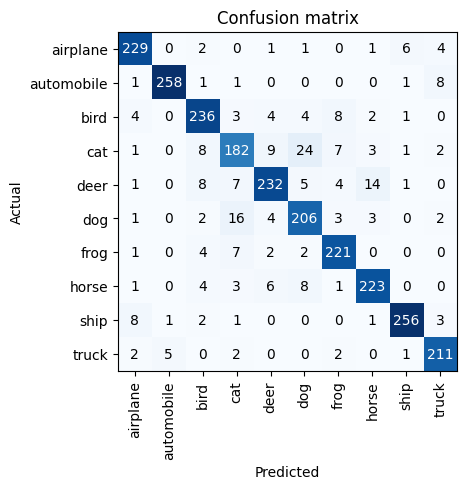

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

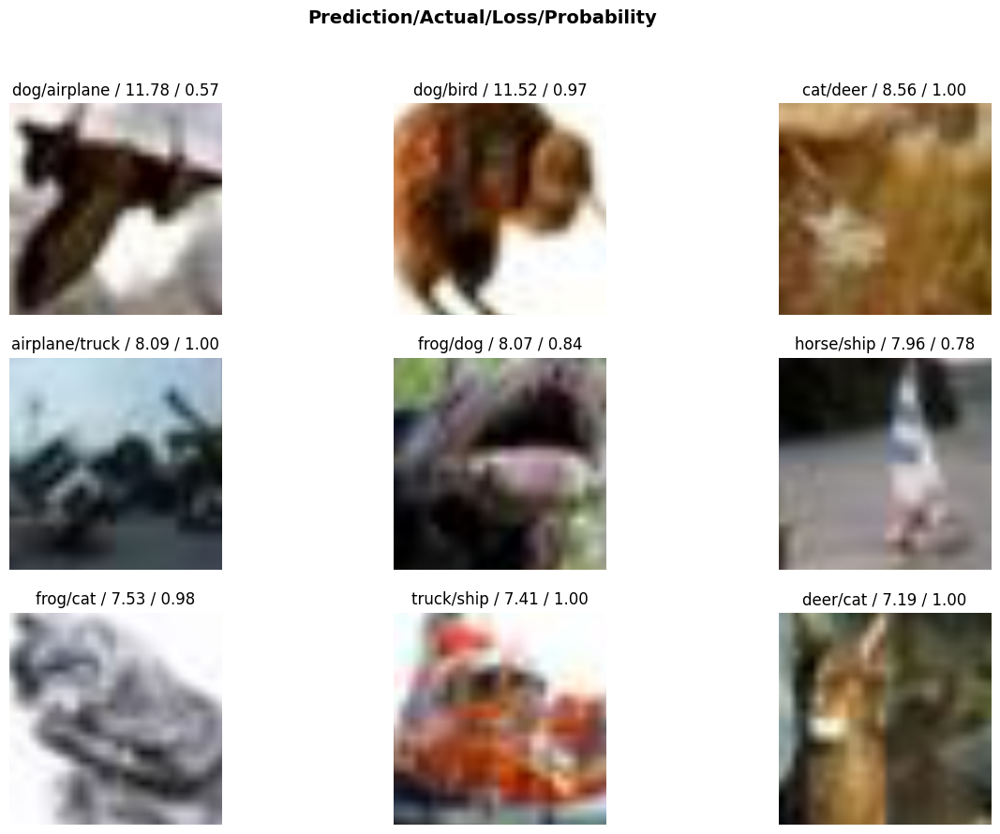

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsVGG19.csv', index=False)

In [ ]:
print(preds, _)
df

tensor([[1.6555e-15, 7.7224e-10, 2.8758e-17,  ..., 5.3562e-17, 2.0822e-12,
         1.0000e+00],
        [3.6988e-06, 1.8384e-06, 1.1547e-04,  ..., 2.2949e-05, 2.0199e-06,
         9.3528e-05],
        [1.6449e-06, 5.4527e-06, 5.5910e-06,  ..., 2.3655e-09, 3.1642e-08,
         3.3083e-08],
        ...,
        [1.2052e-05, 2.4861e-05, 1.1680e-03,  ..., 9.9103e-01, 1.8077e-05,
         8.7271e-06],
        [6.9723e-05, 6.1282e-04, 1.3034e-03,  ..., 6.5030e-02, 1.3005e-04,
         8.8462e-03],
        [1.1128e-09, 6.9507e-09, 1.9892e-04,  ..., 3.6758e-07, 2.5917e-08,
         8.0309e-08]]) None


,filename,predicted_class
0,0151.jpg,truck
1,0777.jpg,dog
2,4791.jpg,frog
3,6657.jpg,truck
4,0969.jpg,automobile
...,...,...
9995,9369.jpg,bird
9996,8759.jpg,ship
9997,2939.jpg,horse
9998,7767.jpg,dog


# TESTING VGG19 4 (lr=0.04, bs=128, freeze_epochs=2, image_size=256) [0.892400]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05, seed=42),
                   get_y=parent_label,
                   item_tfms=RandomResizedCrop(460, min_scale=0.75),
                   batch_tfms=[*aug_transforms(size=224, max_warp=0), Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=128, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: RandomResizedCrop -- {'size': (460, 460), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Flip -- {'size': 224, 'mode': 'bilinear', 'pad_mode': 'reflection', 'mode_mask': 'nearest', 'align_corners': True, 'p': 0.5} -> Brightness -- {'max_lighting': 0.2, 'p': 1.0, 'draw': None, 'batch': False} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True, ps=0.0)
learn.fine_tune(epochs=5, base_lr=0.04, freeze_epochs=2)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.024326,0.929823,0.668400,0.331600,05:35
1,1.000685,1.005518,0.647200,0.352800,05:30


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.618900,0.751498,0.746400,0.253600,14:44
1,0.615212,0.782467,0.734800,0.265200,14:42
2,0.476511,0.450849,0.846000,0.154000,14:43


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.618900,0.751498,0.746400,0.253600,14:44
1,0.615212,0.782467,0.734800,0.265200,14:42
2,0.476511,0.450849,0.846000,0.154000,14:43
3,0.323573,0.360115,0.878400,0.121600,14:41
4,0.212851,0.309092,0.892400,0.107600,14:39


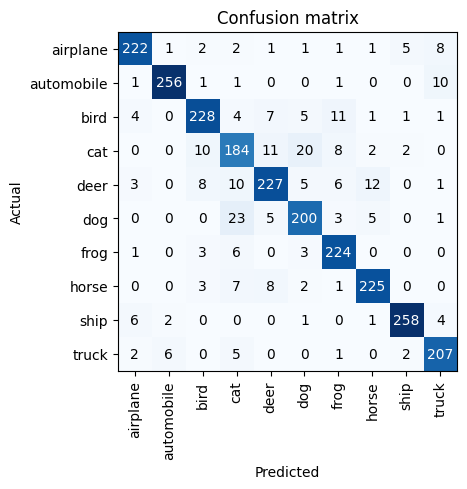

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsVGG19_2.csv', index=False)

In [ ]:
print(preds, _)
df

tensor([[1.3730e-13, 2.1744e-10, 4.3087e-15,  ..., 1.7095e-15, 3.7947e-11,
         1.0000e+00],
        [5.3305e-05, 4.4452e-05, 2.3329e-03,  ..., 1.6081e-03, 2.3673e-04,
         6.0462e-03],
        [2.1476e-08, 8.1255e-08, 7.2637e-07,  ..., 9.1057e-10, 1.2145e-09,
         4.8614e-09],
        ...,
        [6.2298e-04, 9.9899e-03, 5.9221e-02,  ..., 8.1152e-01, 2.3183e-04,
         9.6155e-04],
        [1.4827e-05, 3.0614e-05, 4.1251e-04,  ..., 2.6633e-03, 3.5642e-05,
         1.2275e-04],
        [3.3266e-07, 9.4390e-08, 8.9538e-04,  ..., 2.9288e-05, 2.0163e-07,
         3.0379e-07]]) None


,filename,predicted_class
0,0151.jpg,truck
1,0777.jpg,dog
2,4791.jpg,frog
3,6657.jpg,truck
4,0969.jpg,automobile
...,...,...
9995,9369.jpg,bird
9996,8759.jpg,ship
9997,2939.jpg,horse
9998,7767.jpg,cat


tensor([[1.3730e-13, 2.1744e-10, 4.3087e-15,  ..., 1.7095e-15, 3.7947e-11,
         1.0000e+00],
        [5.3305e-05, 4.4452e-05, 2.3329e-03,  ..., 1.6081e-03, 2.3673e-04,
         6.0462e-03],
        [2.1476e-08, 8.1255e-08, 7.2637e-07,  ..., 9.1057e-10, 1.2145e-09,
         4.8614e-09],
        ...,
        [6.2298e-04, 9.9899e-03, 5.9221e-02,  ..., 8.1152e-01, 2.3183e-04,
         9.6155e-04],
        [1.4827e-05, 3.0614e-05, 4.1251e-04,  ..., 2.6633e-03, 3.5642e-05,
         1.2275e-04],
        [3.3266e-07, 9.4390e-08, 8.9538e-04,  ..., 2.9288e-05, 2.0163e-07,
         3.0379e-07]]) None


,filename,predicted_class
0,0151.jpg,truck
1,0777.jpg,dog
2,4791.jpg,frog
3,6657.jpg,truck
4,0969.jpg,automobile
...,...,...
9995,9369.jpg,bird
9996,8759.jpg,ship
9997,2939.jpg,horse
9998,7767.jpg,cat


# TESTING VGG19 5 (progresive resizing) (lr=0.03, bs=128, size=256, freeze_epochs=2, image_size=256) [0.891200]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05, seed=42),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.04, bs=256, freeze_epochs=2, image_size=128) [0.891200]

In [ ]:
#train the model
learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True, ps=0.0)
learn.fine_tune(epochs=3, base_lr=0.04, wd=0.0, freeze_epochs=2)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.857845,0.880848,0.694800,0.305200,01:50
1,0.775535,0.793795,0.726000,0.274000,01:48


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.503265,0.756302,0.757600,0.242400,04:22
1,0.352290,0.462185,0.839200,0.160800,04:23


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.503265,0.756302,0.757600,0.242400,04:22
1,0.352290,0.462185,0.839200,0.160800,04:23
2,0.192100,0.325902,0.891200,0.108800,04:24


### Iteració 2 (lr=0.01, bs=128, freeze_epochs=1, image_size=256)

In [ ]:
from fastai.callback.all import *
dls = dblock.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=256, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Add the EarlyStoppingCallback and ReduceLROnPlateau
callbacks = [EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=2),
             ReduceLROnPlateau(monitor='accuracy', factor=0.2, min_delta=1, patience=1)]

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=20, base_lr=0.01, wd=0.0, freeze_epochs=1, cbs=callbacks)


Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.185216,0.371203,0.878800,0.121200,01:52


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.161145,0.349744,0.885200,0.114800,04:20


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.161145,0.349744,0.885200,0.114800,04:20
1,0.146661,0.355047,0.885600,0.114400,04:22
2,0.145084,0.355907,0.891200,0.108800,04:20


No improvement since epoch 0: early stopping


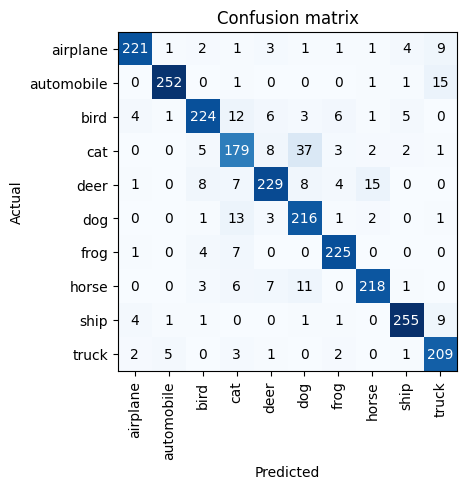

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

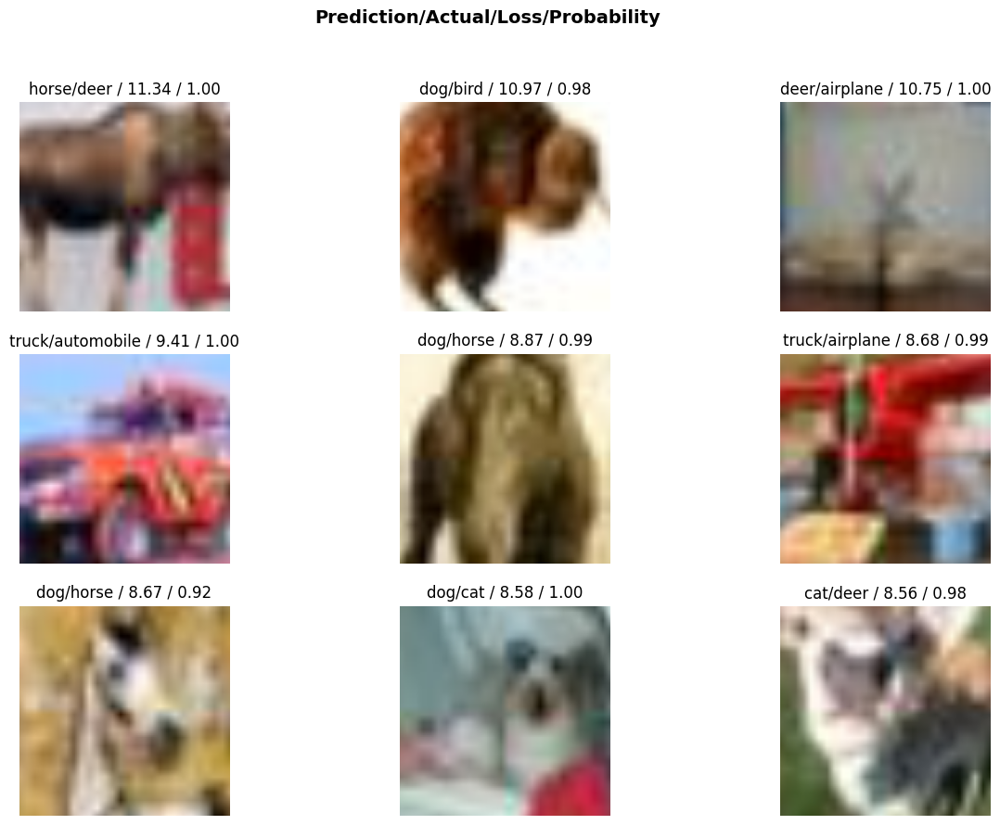

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsVGG19_2.csv', index=False)

In [ ]:
df

,filename,predicted_class
0,0151.jpg,truck
1,0777.jpg,dog
2,4791.jpg,frog
3,6657.jpg,truck
4,0969.jpg,automobile
...,...,...
9995,9369.jpg,bird
9996,8759.jpg,ship
9997,2939.jpg,horse
9998,7767.jpg,dog


,filename,predicted_class
0,0151.jpg,truck
1,0777.jpg,dog
2,4791.jpg,frog
3,6657.jpg,truck
4,0969.jpg,automobile
...,...,...
9995,9369.jpg,bird
9996,8759.jpg,ship
9997,2939.jpg,horse
9998,7767.jpg,dog


# TESTING VGG19 6 (progresive resizing) [0.886800]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.04, bs=128, freeze_epochs=3, image_size=128) [0.880800]

In [ ]:
#train the model
learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True, ps=0.0)
learn.fine_tune(epochs=3, base_lr=0.04, wd=0.0, freeze_epochs=3)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.816782,0.810961,0.720800,0.279200,02:07
1,0.781157,0.755136,0.732400,0.267600,01:46
2,0.753854,0.777316,0.718000,0.282000,01:45


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.497422,0.612344,0.796400,0.203600,04:13
1,0.370118,0.386673,0.869600,0.130400,04:14
2,0.197125,0.302055,0.902800,0.097200,04:12


### Iteració 2 (lr=0.03, bs=128, freeze_epochs=2, image_size=256) [0.901600]

In [ ]:
from fastai.callback.all import *
dls = dblock.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=256, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Add the EarlyStoppingCallback and ReduceLROnPlateau
callbacks = [EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=1),
             ReduceLROnPlateau(monitor='accuracy', factor=0.2, min_delta=1, patience=1)]

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=5, base_lr=0.02, freeze_epochs=1, cbs=callbacks)

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.222620,0.212025,0.928400,0.071600,01:50


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.249072,0.271918,0.901200,0.098800,04:14
1,0.284418,0.323161,0.886800,0.113200,04:14


No improvement since epoch 0: early stopping


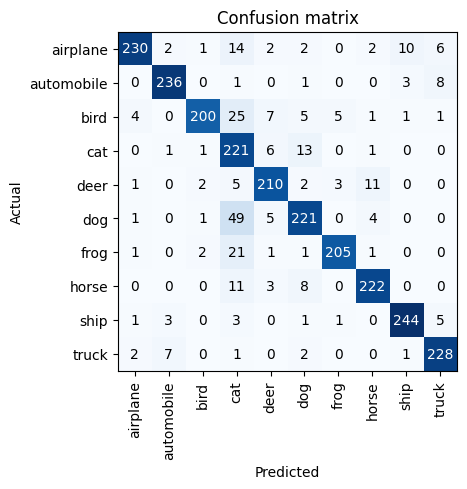

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

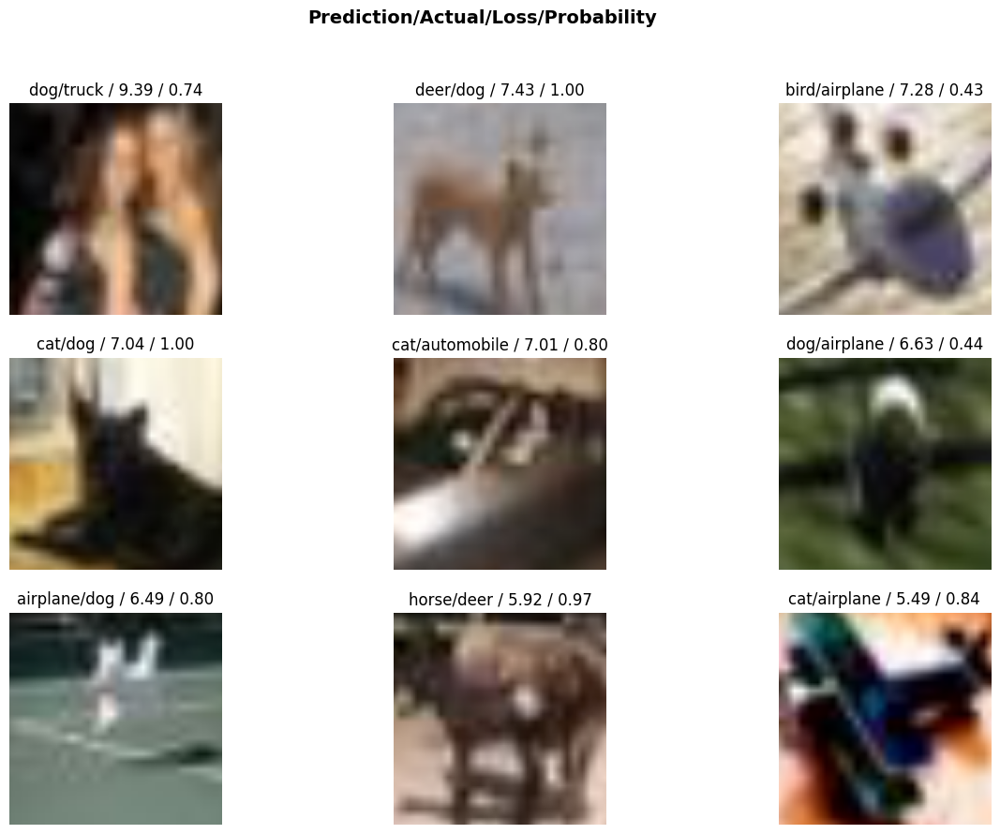

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsVGG19_6_S.csv', index=False)

In [ ]:
print(preds, _)
df

tensor([[1.1351e-05, 1.7750e-06, 2.8184e-03,  ..., 4.4668e-05, 2.0625e-06,
         5.5217e-06],
        [9.1923e-01, 5.4626e-03, 3.0619e-02,  ..., 8.1400e-03, 9.2040e-04,
         2.8008e-04],
        [7.4666e-09, 7.2751e-09, 1.1874e-07,  ..., 9.9983e-01, 5.3944e-10,
         3.5158e-09],
        ...,
        [1.0644e-05, 3.3548e-06, 1.9652e-03,  ..., 1.4217e-03, 1.3135e-06,
         1.0066e-05],
        [6.7754e-07, 3.1839e-06, 2.8415e-09,  ..., 8.8619e-10, 1.0000e+00,
         2.4712e-07],
        [6.3068e-05, 4.7074e-05, 1.9268e-03,  ..., 4.5299e-03, 2.9294e-06,
         5.2028e-06]]) None


,filename,predicted_class
0,7531.jpg,frog
1,0110.jpg,airplane
2,1035.jpg,horse
3,2227.jpg,ship
4,2495.jpg,dog
...,...,...
9995,5169.jpg,cat
9996,5738.jpg,frog
9997,5572.jpg,dog
9998,9831.jpg,ship


# TESTING VGG19 7 (progresive resizing) [0.914800]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05, seed=42),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.04, bs=256, freeze_epochs=2, image_size=128) [0.891200]

In [ ]:
#train the model
learn = cnn_learner(dls, vgg19, metrics=[accuracy, error_rate], pretrained=True, ps=0.0)
learn.fine_tune(epochs=7, base_lr=0.04, wd=0.0, freeze_epochs=2)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|█████

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.868660,0.887070,0.698000,0.302000,01:51
1,0.780898,0.759468,0.731200,0.268800,01:51


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.445494,0.527597,0.829200,0.170800,04:33
1,0.439332,0.554810,0.804400,0.195600,04:33
2,0.360707,0.433123,0.862800,0.137200,04:32
3,0.275173,0.438620,0.862000,0.138000,04:31
4,0.190412,0.344122,0.884800,0.115200,04:30
5,0.105808,0.279105,0.910000,0.090000,04:30


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.445494,0.527597,0.829200,0.170800,04:33
1,0.439332,0.554810,0.804400,0.195600,04:33
2,0.360707,0.433123,0.862800,0.137200,04:32
3,0.275173,0.438620,0.862000,0.138000,04:31
4,0.190412,0.344122,0.884800,0.115200,04:30
5,0.105808,0.279105,0.910000,0.090000,04:30
6,0.063870,0.273066,0.911200,0.088800,04:30


### Iteració 2 (lr=0.01, bs=128, freeze_epochs=1, image_size=256)

In [ ]:
from fastai.callback.all import *
dls = dblock.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=256, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Add the EarlyStoppingCallback and ReduceLROnPlateau
callbacks = [EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=1),
             ReduceLROnPlateau(monitor='accuracy', factor=0.2, min_delta=1, patience=1)]

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=20, base_lr=0.01, wd=0.0, freeze_epochs=1, cbs=callbacks)


Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.082380,0.352151,0.904800,0.095200,01:49


epoch,train_loss,valid_loss,accuracy,error_rate,time


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.072682,0.307160,0.913600,0.086400,04:28
1,0.065978,0.323046,0.914800,0.085200,04:28


No improvement since epoch 0: early stopping


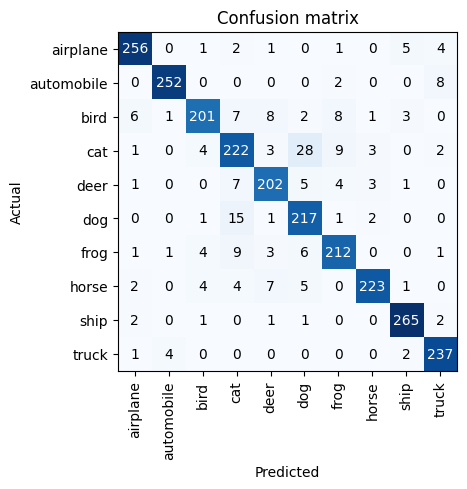

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

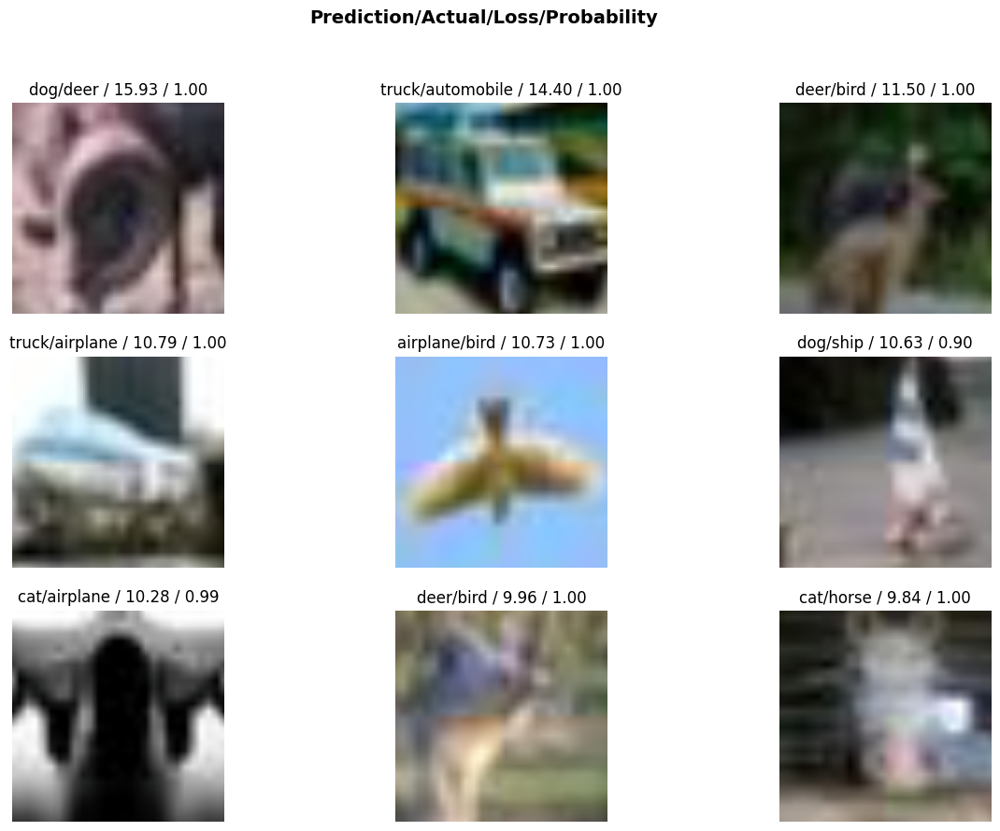

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsVGG19_S_7.csv', index=False)

In [ ]:
df

,filename,predicted_class
0,7531.jpg,frog
1,0110.jpg,airplane
2,1035.jpg,horse
3,2227.jpg,ship
4,2495.jpg,dog
...,...,...
9995,5169.jpg,cat
9996,5738.jpg,frog
9997,5572.jpg,dog
9998,9831.jpg,ship


,filename,predicted_class
0,7531.jpg,frog
1,0110.jpg,airplane
2,1035.jpg,horse
3,2227.jpg,ship
4,2495.jpg,dog
...,...,...
9995,5169.jpg,cat
9996,5738.jpg,frog
9997,5572.jpg,dog
9998,9831.jpg,ship


# ResNet

## Param Tuning 1 {Iteration 5/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.9147]}
    'batch_size': [128,256],
    'learning_rate': [0.1,0.02,0.03],
    'weight_decay': [0.0],
    'dropout': [0.0],
    'freeze_epochs':[1]

learning_rate=0.01-->[0.8743];
{{learning_rate=0.02-->[0.91175]}};
learning_rate=0.03-->[0.90435]

batch_size=128-->[0.8923];
{{batch_size=256-->[0.9014]}}

### Define datablock, dataloader and params

In [ ]:
from fastai.vision.all import *
from fastai.data.block import DataBlock
from sklearn.model_selection import ParameterSampler
import random
from sklearn.model_selection import ParameterGrid

In [ ]:
# Define the hyperparameter space to search over
param_grid = {
    'batch_size': [128,256],
    'learning_rate': [0.1,0.02,0.03],
    'weight_decay': [0.0],
    'dropout': [0.0],
    'freeze_epochs':[1]
}

In [ ]:
# Create a data block and data loaders with default parameters
path = Path('/content')
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    get_y=parent_label,
    splitter=GrandparentSplitter(valid_name='validation'),
    item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]
)
dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
# Define the number of random combinations to try
n_iter = len(list(ParameterGrid(param_grid)))

# Generate random combinations of hyperparameters
param_list = list(ParameterSampler(param_grid, n_iter=n_iter, random_state=42))

In [ ]:
len(list(ParameterGrid(param_grid)))

6

In [ ]:
param_list

[{'weight_decay': 0.0,
  'learning_rate': 0.1,
  'freeze_epochs': 1,
  'dropout': 0.0,
  'batch_size': 128},
 {'weight_decay': 0.0,
  'learning_rate': 0.02,
  'freeze_epochs': 1,
  'dropout': 0.0,
  'batch_size': 128},
 {'weight_decay': 0.0,
  'learning_rate': 0.03,
  'freeze_epochs': 1,
  'dropout': 0.0,
  'batch_size': 128},
 {'weight_decay': 0.0,
  'learning_rate': 0.1,
  'freeze_epochs': 1,
  'dropout': 0.0,
  'batch_size': 256},
 {'weight_decay': 0.0,
  'learning_rate': 0.02,
  'freeze_epochs': 1,
  'dropout': 0.0,
  'batch_size': 256},
 {'weight_decay': 0.0,
  'learning_rate': 0.03,
  'freeze_epochs': 1,
  'dropout': 0.0,
  'batch_size': 256}]

### Model

In [ ]:
#learn = cnn_learner(dls, resnet34, metrics=[accuracy, error_rate], pretrained=True)

In [ ]:
# Loop over the hyperparameter combinations
for i, params in enumerate(param_list):
    print(f'Iteration {i+1}/{n_iter} with params: {params}')

    # Update the data loaders with the current hyperparameters
    dls = data.dataloaders(path, bs=params['batch_size'], num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])


    # Create a simple model with the current hyperparameters
    learn = cnn_learner(dls, resnet34, metrics=[accuracy, error_rate], pretrained=True, ps=params['dropout'])

    # Fit the model with the current hyperparameters
    learn.fine_tune(3, base_lr=params['learning_rate'], wd=params['weight_decay'], freeze_epochs=params['freeze_epochs'])

    # Evaluate the model on the validation set
    acc = learn.validate()[1]
    print(f'Accuracy: {acc:.4f}')

    # Save the model and accuracy for later analysis
    learn.save(f'model_{i+1}')
    with open(f'accuracy_{i+1}.txt', 'w') as f:
        f.write(str(acc))


Iteration 1/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.1, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pt

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.805502,0.818333,0.746200,0.253800,01:31


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.908752,0.780498,0.732900,0.267100,01:33
1,0.643985,0.796182,0.799300,0.200700,01:32
2,0.428960,0.767505,0.864400,0.135600,01:31


Accuracy: 0.8644
Iteration 2/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.711530,0.521387,0.819100,0.180900,01:24


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.656333,0.647757,0.784200,0.215800,01:34
1,0.465151,0.364666,0.876200,0.123800,01:34
2,0.279561,0.266967,0.908800,0.091200,01:34


Accuracy: 0.9088
Iteration 3/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.680091,0.541374,0.816700,0.183300,01:32


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.693513,0.721056,0.766900,0.233100,01:41
1,0.500522,0.429541,0.851000,0.149000,01:40
2,0.292352,0.277949,0.903700,0.096300,01:41


Accuracy: 0.9037
Iteration 4/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.1, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.747334,0.665707,0.787500,0.212500,01:37


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.828418,0.933748,0.704400,0.295600,01:40
1,0.581301,0.437466,0.846400,0.153600,01:43
2,0.380594,0.328042,0.884500,0.115500,01:43


Accuracy: 0.8845
Iteration 5/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.868402,0.550056,0.816200,0.183800,01:37


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.610503,0.563410,0.818100,0.181900,01:41
1,0.452808,0.354349,0.876900,0.123100,01:40
2,0.269037,0.256102,0.914700,0.085300,01:44


Accuracy: 0.9147
Iteration 6/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.825785,0.500033,0.829200,0.170800,01:35


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.644584,0.636632,0.792800,0.207200,01:38
1,0.474072,0.420502,0.856100,0.143900,01:41
2,0.284911,0.269709,0.905000,0.095000,01:40


Accuracy: 0.9050


Iteration 1/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.1, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128} [0.8644]

Iteration 2/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128} [0.9088]

Iteration 3/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128} [0.9037]

Iteration 4/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.1, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.8845]

{{Iteration 5/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.9147]}}

Iteration 6/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.9050]

learning_rate=0.1-->[0.8743];
{{learning_rate=0.02-->[0.91175]}};
learning_rate=0.03-->[0.90435]

batch_size=128-->[0.8923];
{{batch_size=256-->[0.9014]}}

## Param Tuning 2 Iteration 5/16 with params: {'weight_decay': 0.0, 'learning_rate': 0.01, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 256} [0.914800]
    'batch_size': [256,512],
    'learning_rate': [0.01,0.02],
    'weight_decay': [0.0, 0.001],
    'dropout': [0.0,0.001],
    'freeze_epochs':[1]

learning_rate=0.01-->[0.911675];
{{learning_rate=0.02-->[0.9119625]}};

weight_decay=0.0-->[0.9112125];
{{weight_decay=0.001-->[0.912425]}}


dropout=0.0-->[0.91155];
{{dropout=0.001-->[0.911975]}}

{{batch_size=256-->[0.9133875]}};
batch_size=512-->[0.9101375]

### Define datablock, dataloader and params

In [ ]:
from fastai.vision.all import *
from fastai.data.block import DataBlock
from sklearn.model_selection import ParameterSampler
import random
from sklearn.model_selection import ParameterGrid

In [ ]:
# Define the hyperparameter space to search over
param_grid = {
    'batch_size': [256,512],
    'learning_rate': [0.01,0.02],
    'weight_decay': [0.0, 0.001],
    'dropout': [0.0,0.001],
    'freeze_epochs':[1]
}

In [ ]:
# Create a data block and data loaders with default parameters
path = Path('/content')
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    get_y=parent_label,
    splitter=GrandparentSplitter(valid_name='validation'),
    item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]
)
dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
# Define the number of random combinations to try
n_iter = len(list(ParameterGrid(param_grid)))

# Generate random combinations of hyperparameters
param_list = list(ParameterSampler(param_grid, n_iter=n_iter, random_state=42))

In [ ]:
len(list(ParameterGrid(param_grid)))

16

In [ ]:
param_list

[{'weight_decay': 0.0,
  'learning_rate': 0.01,
  'freeze_epochs': 1,
  'dropout': 0.0,
  'batch_size': 256},
 {'weight_decay': 0.001,
  'learning_rate': 0.01,
  'freeze_epochs': 1,
  'dropout': 0.0,
  'batch_size': 256},
 {'weight_decay': 0.0,
  'learning_rate': 0.02,
  'freeze_epochs': 1,
  'dropout': 0.0,
  'batch_size': 256},
 {'weight_decay': 0.001,
  'learning_rate': 0.02,
  'freeze_epochs': 1,
  'dropout': 0.0,
  'batch_size': 256},
 {'weight_decay': 0.0,
  'learning_rate': 0.01,
  'freeze_epochs': 1,
  'dropout': 0.001,
  'batch_size': 256},
 {'weight_decay': 0.001,
  'learning_rate': 0.01,
  'freeze_epochs': 1,
  'dropout': 0.001,
  'batch_size': 256},
 {'weight_decay': 0.0,
  'learning_rate': 0.02,
  'freeze_epochs': 1,
  'dropout': 0.001,
  'batch_size': 256},
 {'weight_decay': 0.001,
  'learning_rate': 0.02,
  'freeze_epochs': 1,
  'dropout': 0.001,
  'batch_size': 256},
 {'weight_decay': 0.0,
  'learning_rate': 0.01,
  'freeze_epochs': 1,
  'dropout': 0.0,
  'batch_size': 

### Model

In [ ]:
#learn = cnn_learner(dls, resnet34, metrics=[accuracy, error_rate], pretrained=True)

In [ ]:
# Loop over the hyperparameter combinations
for i, params in enumerate(param_list):
    print(f'Iteration {i+1}/{n_iter} with params: {params}')

    # Update the data loaders with the current hyperparameters
    dls = data.dataloaders(path, bs=params['batch_size'], num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])


    # Create a simple model with the current hyperparameters
    learn = cnn_learner(dls, resnet34, metrics=[accuracy, error_rate], pretrained=True, ps=params['dropout'])

    # Fit the model with the current hyperparameters
    learn.fine_tune(3, base_lr=params['learning_rate'], wd=params['weight_decay'], freeze_epochs=params['freeze_epochs'])

    # Evaluate the model on the validation set
    acc = learn.validate()[1]
    print(f'Accuracy: {acc:.4f}')

    # Save the model and accuracy for later analysis
    learn.save(f'model_{i+1}')
    with open(f'accuracy_{i+1}.txt', 'w') as f:
        f.write(str(acc))


Iteration 1/16 with params: {'weight_decay': 0.0, 'learning_rate': 0.01, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pt

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.964788,0.673807,0.766300,0.233700,01:33


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.524897,0.467278,0.843900,0.156100,01:34
1,0.395907,0.317463,0.889900,0.110100,01:32
2,0.245614,0.252501,0.910600,0.089400,01:31


Accuracy: 0.9106
Iteration 2/16 with params: {'weight_decay': 0.001, 'learning_rate': 0.01, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.965178,0.662954,0.772700,0.227300,01:26


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.540755,0.502990,0.832000,0.168000,01:31
1,0.398221,0.363759,0.877700,0.122300,01:31
2,0.234514,0.252290,0.914500,0.085500,01:31


Accuracy: 0.9145
Iteration 3/16 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.863795,0.591790,0.801100,0.198900,01:28


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.595360,0.685733,0.779300,0.220700,01:34
1,0.428292,0.342865,0.881600,0.118400,01:34
2,0.262358,0.250166,0.913300,0.086700,01:34


Accuracy: 0.9133
Iteration 4/16 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.868112,0.594302,0.799100,0.200900,01:30


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.616714,0.547121,0.818900,0.181100,01:40
1,0.447781,0.357930,0.878200,0.121800,01:35
2,0.259528,0.254743,0.914300,0.085700,01:33


Accuracy: 0.9143
Iteration 5/16 with params: {'weight_decay': 0.0, 'learning_rate': 0.01, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.963184,0.664127,0.773000,0.227000,01:30


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.538791,0.482962,0.835900,0.164100,01:35
1,0.403711,0.314605,0.892800,0.107200,01:34
2,0.243472,0.246538,0.914800,0.085200,01:34


Accuracy: 0.9148
Iteration 6/16 with params: {'weight_decay': 0.001, 'learning_rate': 0.01, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.975445,0.660115,0.771600,0.228400,01:32


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.548118,0.484126,0.837000,0.163000,01:36
1,0.400840,0.326188,0.891200,0.108800,01:33
2,0.242203,0.244719,0.914700,0.085300,01:34


Accuracy: 0.9147
Iteration 7/16 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.863222,0.603468,0.807400,0.192600,01:26


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.601243,0.593187,0.807500,0.192500,01:32
1,0.437021,0.334084,0.885200,0.114800,01:33
2,0.263798,0.256807,0.913100,0.086900,01:32


Accuracy: 0.9131
Iteration 8/16 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.850648,0.585564,0.805100,0.194900,01:28


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.603670,0.741816,0.753500,0.246500,01:34
1,0.437385,0.338134,0.883600,0.116400,01:31
2,0.265653,0.258303,0.911800,0.088200,01:33


Accuracy: 0.9118
Iteration 9/16 with params: {'weight_decay': 0.0, 'learning_rate': 0.01, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.139523,0.772098,0.739300,0.260700,01:26


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.541589,0.522107,0.836600,0.163400,01:31
1,0.405551,0.311088,0.892900,0.107100,01:31
2,0.261968,0.260678,0.910300,0.089700,01:32


Accuracy: 0.9103
Iteration 10/16 with params: {'weight_decay': 0.001, 'learning_rate': 0.01, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.127256,0.748472,0.747800,0.252200,01:28


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.551840,0.507242,0.832800,0.167200,01:31
1,0.402401,0.329440,0.882400,0.117600,01:32
2,0.264637,0.266774,0.909000,0.091000,01:31


Accuracy: 0.9090
Iteration 11/16 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.025206,0.640685,0.792100,0.207900,01:29


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.548632,0.746411,0.779400,0.220600,01:30
1,0.436653,0.321140,0.890600,0.109400,01:33
2,0.283057,0.260384,0.909900,0.090100,01:32


Accuracy: 0.9099
Iteration 12/16 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.015775,0.674231,0.780500,0.219500,01:29


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.558318,0.583790,0.815200,0.184800,01:33
1,0.436816,0.358458,0.876500,0.123500,01:33
2,0.279387,0.253040,0.911400,0.088600,01:39


Accuracy: 0.9114
Iteration 13/16 with params: {'weight_decay': 0.0, 'learning_rate': 0.01, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.141368,0.744060,0.746000,0.254000,01:30


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.550345,0.506308,0.837000,0.163000,01:35
1,0.407552,0.323630,0.890300,0.109700,01:34
2,0.268032,0.265063,0.908800,0.091200,01:33


Accuracy: 0.9088
Iteration 14/16 with params: {'weight_decay': 0.001, 'learning_rate': 0.01, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.145687,0.738562,0.747300,0.252700,01:27


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.536594,0.495836,0.845000,0.155000,01:34
1,0.406048,0.332682,0.885300,0.114700,01:32
2,0.263033,0.267940,0.910700,0.089300,01:34


Accuracy: 0.9107
Iteration 15/16 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.030817,0.663610,0.779600,0.220400,01:28


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.570988,0.755586,0.760100,0.239900,01:34
1,0.430818,0.339349,0.882400,0.117600,01:33
2,0.274613,0.259361,0.908900,0.091100,01:33


Accuracy: 0.9089
Iteration 16/16 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.031618,0.662497,0.786100,0.213900,01:29


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.561954,0.653453,0.808600,0.191400,01:33
1,0.430700,0.323734,0.886600,0.113400,01:32
2,0.278726,0.254820,0.913000,0.087000,01:33


Accuracy: 0.9130


Iteration 1/16 with params: {'weight_decay': 0.0, 'learning_rate': 0.01, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.910600]

Iteration 2/16 with params: {'weight_decay': 0.001, 'learning_rate': 0.01, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.914500]

Iteration 3/16 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.913300]

Iteration 4/16 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.914300]

{{Iteration 5/16 with params: {'weight_decay': 0.0, 'learning_rate': 0.01, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 256} [0.914800]}}

Iteration 6/16 with params: {'weight_decay': 0.001, 'learning_rate': 0.01, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 256} [0.914700]

Iteration 7/16 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 256} [0.913100]

Iteration 8/16 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 256} [0.911800]

Iteration 9/16 with params: {'weight_decay': 0.0, 'learning_rate': 0.01, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512} [0.910300]

Iteration 10/16 with params: {'weight_decay': 0.001, 'learning_rate': 0.01, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512} [0.909000]

Iteration 11/16 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512} [0.909900]

Iteration 12/16 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512} [0.911400]

Iteration 13/16 with params: {'weight_decay': 0.0, 'learning_rate': 0.01, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 512} [0.908800]

Iteration 14/16 with params: {'weight_decay': 0.001, 'learning_rate': 0.01, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 512} [0.910700]

Iteration 15/16 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 512} [0.908900]

Iteration 16/16 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 512} [0.913000]

learning_rate=0.01-->[0.911675];
{{learning_rate=0.02-->[0.9119625]}};

weight_decay=0.0-->[0.9112125];
{{weight_decay=0.001-->[0.912425]}}


dropout=0.0-->[0.91155];
{{dropout=0.001-->[0.911975]}}

{{batch_size=256-->[0.9133875]}};
batch_size=512-->[0.9101375]

## Param Tuning 3 {Iteration 5/12 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 3, 'dropout': 0.001, 'batch_size': 256} [0.9178]}
    'batch_size': [256],
    'learning_rate': [0.02],
    'weight_decay': [0.001,0.01],
    'dropout': [0.001,0.01],
    'freeze_epochs':[1,2,3]

{{weight_decay=0.001-->[0.91523]}};
weight_decay=0.01-->[0.91275]

freeze_epochs=1-->[0.911075];
freeze_epochs=2-->[0.91425];
{{freeze_epochs=3-->[0.91665]}}

{{dropout=0.001-->[0.914083]}};
dropout=0.01-->[0.913883]

### Define datablock, dataloader and params

In [ ]:
from fastai.vision.all import *
from fastai.data.block import DataBlock
from sklearn.model_selection import ParameterSampler
import random
from sklearn.model_selection import ParameterGrid

In [ ]:
# Define the hyperparameter space to search over
param_grid = {
    'batch_size': [256],
    'learning_rate': [0.02],
    'weight_decay': [0.001,0.01],
    'dropout': [0.001,0.01],
    'freeze_epochs':[1,2,3]
}

In [ ]:
# Create a data block and data loaders with default parameters
path = Path('/content')
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    get_y=parent_label,
    splitter=GrandparentSplitter(valid_name='validation'),
    item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]
)
dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
# Define the number of random combinations to try
n_iter = len(list(ParameterGrid(param_grid)))

# Generate random combinations of hyperparameters
param_list = list(ParameterSampler(param_grid, n_iter=n_iter, random_state=42))

In [ ]:
len(list(ParameterGrid(param_grid)))

12

### Model

In [ ]:
#learn = cnn_learner(dls, resnet34, metrics=[accuracy, error_rate], pretrained=True)

In [ ]:
# Loop over the hyperparameter combinations
for i, params in enumerate(param_list):
    print(f'Iteration {i+1}/{n_iter} with params: {params}')

    # Update the data loaders with the current hyperparameters
    dls = data.dataloaders(path, bs=params['batch_size'], num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])


    # Create a simple model with the current hyperparameters
    learn = cnn_learner(dls, resnet34, metrics=[accuracy, error_rate], pretrained=True, ps=params['dropout'])

    # Fit the model with the current hyperparameters
    learn.fine_tune(3, base_lr=params['learning_rate'], wd=params['weight_decay'], freeze_epochs=params['freeze_epochs'])

    # Evaluate the model on the validation set
    acc = learn.validate()[1]
    print(f'Accuracy: {acc:.4f}')

    # Save the model and accuracy for later analysis
    learn.save(f'model_{i+1}')
    with open(f'accuracy_{i+1}.txt', 'w') as f:
        f.write(str(acc))


Iteration 1/12 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pt

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.856560,0.598350,0.799100,0.200900,01:30


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.596507,0.540956,0.819000,0.181000,01:30
1,0.448726,0.365157,0.872700,0.127300,01:36
2,0.263418,0.253054,0.913100,0.086900,01:42


Accuracy: 0.9131
Iteration 2/12 with params: {'weight_decay': 0.01, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.850402,0.601798,0.802600,0.197400,01:28


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.609483,0.735722,0.776900,0.223100,01:28
1,0.445104,0.338078,0.885400,0.114600,01:30
2,0.260765,0.264684,0.907100,0.092900,01:28


Accuracy: 0.9071
Iteration 3/12 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 2, 'dropout': 0.001, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.981625,0.714149,0.757700,0.242300,01:21
1,0.607905,0.485072,0.831300,0.168700,01:23


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.577022,0.661055,0.782600,0.217400,01:31
1,0.434764,0.348992,0.878200,0.121800,01:32
2,0.257630,0.250638,0.916000,0.084000,01:31


Accuracy: 0.9160
Iteration 4/12 with params: {'weight_decay': 0.01, 'learning_rate': 0.02, 'freeze_epochs': 2, 'dropout': 0.001, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.967671,0.683711,0.763100,0.236900,01:25
1,0.585334,0.458205,0.850700,0.149300,01:25


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.572000,0.531461,0.819900,0.180100,01:29
1,0.427781,0.339905,0.886100,0.113900,01:30
2,0.254565,0.249078,0.914100,0.085900,01:36


Accuracy: 0.9141
Iteration 5/12 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 3, 'dropout': 0.001, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.052433,0.780496,0.726800,0.273200,01:28
1,0.665788,0.508126,0.819800,0.180200,01:24
2,0.506667,0.417883,0.862700,0.137300,01:24


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.568521,0.522883,0.820600,0.179400,01:30
1,0.432237,0.384377,0.865200,0.134800,01:31
2,0.251843,0.244156,0.917800,0.082200,01:30


Accuracy: 0.9178
Iteration 6/12 with params: {'weight_decay': 0.01, 'learning_rate': 0.02, 'freeze_epochs': 3, 'dropout': 0.001, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.045169,0.816056,0.715200,0.284800,01:20
1,0.668993,0.514524,0.824100,0.175900,01:20
2,0.506857,0.415401,0.858700,0.141300,01:21


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.555883,0.579548,0.803200,0.196800,01:29
1,0.431818,0.334700,0.884800,0.115200,01:29
2,0.255723,0.238620,0.916400,0.083600,01:30


Accuracy: 0.9164
Iteration 7/12 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.01, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.854795,0.557056,0.812600,0.187400,01:21


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.595340,0.622132,0.804900,0.195100,01:29
1,0.439557,0.368070,0.871800,0.128200,01:28


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.595340,0.622132,0.804900,0.195100,01:29
1,0.439557,0.368070,0.871800,0.128200,01:28
2,0.264144,0.253992,0.911900,0.088100,01:29


Accuracy: 0.9119
Iteration 8/12 with params: {'weight_decay': 0.01, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.01, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.858271,0.568672,0.809900,0.190100,01:19


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.590118,0.614023,0.798500,0.201500,01:28
1,0.437564,0.355243,0.878800,0.121200,01:28
2,0.264980,0.251286,0.912200,0.087800,01:29


Accuracy: 0.9122
Iteration 9/12 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 2, 'dropout': 0.01, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.985154,0.687480,0.772100,0.227900,01:24
1,0.592317,0.439768,0.853000,0.147000,01:22


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.553646,0.775622,0.753100,0.246900,01:28
1,0.428758,0.365221,0.876000,0.124000,01:27
2,0.253118,0.239643,0.915800,0.084200,01:27


Accuracy: 0.9158
Iteration 10/12 with params: {'weight_decay': 0.01, 'learning_rate': 0.02, 'freeze_epochs': 2, 'dropout': 0.01, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.970018,0.701837,0.766000,0.234000,01:21
1,0.604339,0.445126,0.847900,0.152100,01:19


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.572685,0.603985,0.808100,0.191900,01:28
1,0.429613,0.350902,0.877700,0.122300,01:28
2,0.262147,0.254383,0.911100,0.088900,01:29


Accuracy: 0.9111
Iteration 11/12 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 3, 'dropout': 0.01, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.049702,0.764198,0.736200,0.263800,01:20
1,0.675919,0.506018,0.821000,0.179000,01:20
2,0.507025,0.383396,0.865500,0.134500,01:18


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.569924,0.670899,0.782500,0.217500,01:27
1,0.430423,0.339686,0.880500,0.119500,01:28
2,0.258431,0.245981,0.916800,0.083200,01:27


Accuracy: 0.9168
Iteration 12/12 with params: {'weight_decay': 0.01, 'learning_rate': 0.02, 'freeze_epochs': 3, 'dropout': 0.01, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.038000,0.781627,0.730700,0.269300,01:21
1,0.667785,0.496342,0.830900,0.169100,01:20
2,0.507361,0.406532,0.859200,0.140800,01:21


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.561689,0.546231,0.819100,0.180900,01:27
1,0.417934,0.367230,0.879100,0.120900,01:28
2,0.248076,0.241354,0.915600,0.084400,01:28


Accuracy: 0.9156


Iteration 1/12 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 256} [0.9131]

Iteration 2/12 with params: {'weight_decay': 0.01, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.001, 'batch_size': 256} [0.9071]

Iteration 3/12 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 2, 'dropout': 0.001, 'batch_size': 256} [0.9160]

Iteration 4/12 with params: {'weight_decay': 0.01, 'learning_rate': 0.02, 'freeze_epochs': 2, 'dropout': 0.001, 'batch_size': 256} [0.9141]

{{Iteration 5/12 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 3, 'dropout': 0.001, 'batch_size': 256} [0.9178]}}

Iteration 6/12 with params: {'weight_decay': 0.01, 'learning_rate': 0.02, 'freeze_epochs': 3, 'dropout': 0.001, 'batch_size': 256} [0.9164]

Iteration 7/12 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.01, 'batch_size': 256} [0.9119]

Iteration 8/12 with params: {'weight_decay': 0.01, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.01, 'batch_size': 256} [0.9122]

Iteration 9/12 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 2, 'dropout': 0.01, 'batch_size': 256} [0.9158]

Iteration 10/12 with params: {'weight_decay': 0.01, 'learning_rate': 0.02, 'freeze_epochs': 2, 'dropout': 0.01, 'batch_size': 256} [0.9111]

Iteration 11/12 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 3, 'dropout': 0.01, 'batch_size': 256} [0.9168]

Iteration 12/12 with params: {'weight_decay': 0.01, 'learning_rate': 0.02, 'freeze_epochs': 3, 'dropout': 0.01, 'batch_size': 256} [0.9156]

{{weight_decay=0.001-->[0.91523]}};
weight_decay=0.01-->[0.91275]

freeze_epochs=1-->[0.911075];
freeze_epochs=2-->[0.91425];
{{freeze_epochs=3-->[0.91665]}}

{{dropout=0.001-->[0.914083]}};
dropout=0.01-->[0.913883]

## Param Tuning 4 {Iteration 5/6 with params: {'weight_decay': 0.001, 'learning_rate': 0.01, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.001, 'batch_size': 256} [0.9278]}
    'batch_size': [256],
    'learning_rate': [0.02],
    'weight_decay': [0.001,],
    'dropout': [0.001],
    'freeze_epochs':[3],
    'epochs':[3,5,7

{{learning_rate=0.01-->[0.92453]}}
learning_rate=0.02-->[0.9214]

epochs=3-->[0.9176]
epochs=5-->[0.92425]
{{epochs=7-->[0.92705]}}

### Define datablock, dataloader and params

In [ ]:
from fastai.vision.all import *
from fastai.data.block import DataBlock
from sklearn.model_selection import ParameterSampler
import random
from sklearn.model_selection import ParameterGrid

In [ ]:
# Define the hyperparameter space to search over
param_grid = {
    'batch_size': [256],
    'learning_rate': [0.01,0.02],
    'weight_decay': [0.001],
    'dropout': [0.001],
    'freeze_epochs':[3],
    'epochs':[3,5,7]
}

In [ ]:
# Create a data block and data loaders with default parameters
path = Path('/content')
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    get_y=parent_label,
    splitter=GrandparentSplitter(valid_name='validation'),
    item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]
)
dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
# Define the number of random combinations to try
n_iter = len(list(ParameterGrid(param_grid)))

# Generate random combinations of hyperparameters
param_list = list(ParameterSampler(param_grid, n_iter=n_iter, random_state=42))

In [ ]:
len(list(ParameterGrid(param_grid)))

6

### Model

In [ ]:
# Loop over the hyperparameter combinations
for i, params in enumerate(param_list):
    print(f'Iteration {i+1}/{n_iter} with params: {params}')

    # Update the data loaders with the current hyperparameters
    dls = data.dataloaders(path, bs=params['batch_size'], num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])


    # Create a simple model with the current hyperparameters
    learn = cnn_learner(dls, resnet34, metrics=[accuracy, error_rate], pretrained=True, ps=params['dropout'])

    # Fit the model with the current hyperparameters
    learn.fine_tune(params['epochs'], base_lr=params['learning_rate'], wd=params['weight_decay'], freeze_epochs=params['freeze_epochs'])

    # Evaluate the model on the validation set
    acc = learn.validate()[1]
    print(f'Accuracy: {acc:.4f}')

    # Save the model and accuracy for later analysis
    learn.save(f'model_{i+1}')
    with open(f'accuracy_{i+1}.txt', 'w') as f:
        f.write(str(acc))


Iteration 1/6 with params: {'weight_decay': 0.001, 'learning_rate': 0.01, 'freeze_epochs': 3, 'epochs': 3, 'dropout': 0.001, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:00<00:00, 201MB/s]


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.143127,0.940884,0.676600,0.323400,01:20
1,0.767999,0.587603,0.800300,0.199700,01:21
2,0.557196,0.439432,0.849300,0.150700,01:22


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.505435,0.567883,0.818200,0.181800,01:29
1,0.381807,0.295926,0.897200,0.102800,01:28
2,0.216489,0.236451,0.919100,0.080900,01:26


Accuracy: 0.9191
Iteration 2/6 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 3, 'epochs': 3, 'dropout': 0.001, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.050365,0.788057,0.729900,0.270100,01:21
1,0.674339,0.490494,0.831200,0.168800,01:22
2,0.498224,0.390578,0.863600,0.136400,01:20


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.560036,0.683652,0.783100,0.216900,01:28
1,0.431104,0.359232,0.872200,0.127800,01:28
2,0.251434,0.250682,0.916100,0.083900,01:27


Accuracy: 0.9161
Iteration 3/6 with params: {'weight_decay': 0.001, 'learning_rate': 0.01, 'freeze_epochs': 3, 'epochs': 5, 'dropout': 0.001, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.142488,0.915364,0.687800,0.312200,01:22
1,0.755055,0.577955,0.804900,0.195100,01:20
2,0.564229,0.474186,0.834000,0.166000,01:20


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.466231,0.456031,0.842800,0.157200,01:28
1,0.430894,0.365467,0.875700,0.124300,01:27
2,0.335236,0.320774,0.892200,0.107800,01:28
3,0.221246,0.237977,0.921400,0.078600,01:28
4,0.141758,0.221893,0.926700,0.073300,01:27


Accuracy: 0.9267
Iteration 4/6 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 3, 'epochs': 5, 'dropout': 0.001, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.043513,0.787564,0.728100,0.271900,01:20
1,0.671864,0.481189,0.837000,0.163000,01:25
2,0.500134,0.398956,0.858600,0.141400,01:22


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.503564,0.556005,0.817900,0.182100,01:29
1,0.484723,0.533966,0.823900,0.176100,01:29
2,0.372149,0.382228,0.870900,0.129100,01:28
3,0.249972,0.258873,0.913100,0.086900,01:28
4,0.161010,0.234914,0.921800,0.078200,01:29


Accuracy: 0.9218
Iteration 5/6 with params: {'weight_decay': 0.001, 'learning_rate': 0.01, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.001, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.139001,0.901550,0.689400,0.310600,01:22
1,0.758804,0.559258,0.807600,0.192400,01:21
2,0.555351,0.429765,0.854700,0.145300,01:20


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.434386,0.387231,0.866400,0.133600,01:28
1,0.430558,0.422079,0.859200,0.140800,01:28
2,0.379777,0.370234,0.873800,0.126200,01:27
3,0.310442,0.280682,0.903900,0.096100,01:29
4,0.214533,0.256942,0.914400,0.085600,01:28
5,0.140373,0.227672,0.925200,0.074800,01:28


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.434386,0.387231,0.866400,0.133600,01:28
1,0.430558,0.422079,0.859200,0.140800,01:28
2,0.379777,0.370234,0.873800,0.126200,01:27
3,0.310442,0.280682,0.903900,0.096100,01:29
4,0.214533,0.256942,0.914400,0.085600,01:28
5,0.140373,0.227672,0.925200,0.074800,01:28
6,0.101904,0.225317,0.927800,0.072200,01:29


Accuracy: 0.9278
Accuracy: 0.9278
Iteration 6/6 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.001, 'batch_size': 256}
Iteration 6/6 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.001, 'batch_size': 256}
Found 50000 items
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tens

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.044805,0.819583,0.716000,0.284000,01:23
1,0.661419,0.526273,0.814800,0.185200,01:21
2,0.504109,0.409643,0.860200,0.139800,01:23


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.467723,0.474462,0.839600,0.160400,01:28
1,0.508859,0.428420,0.856600,0.143400,01:29
2,0.425269,0.400679,0.861300,0.138700,01:29
3,0.352102,0.349352,0.883300,0.116700,01:29
4,0.251547,0.275033,0.904600,0.095400,01:29
5,0.171616,0.240497,0.922900,0.077100,01:29
6,0.123036,0.226284,0.926300,0.073700,01:29


Accuracy: 0.9263
Accuracy: 0.9263


Iteration 1/6 with params: {'weight_decay': 0.001, 'learning_rate': 0.01, 'freeze_epochs': 3, 'epochs': 3, 'dropout': 0.001, 'batch_size': 256} [0.9191]

Iteration 2/6 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 3, 'epochs': 3, 'dropout': 0.001, 'batch_size': 256} [0.9161]

Iteration 3/6 with params: {'weight_decay': 0.001, 'learning_rate': 0.01, 'freeze_epochs': 3, 'epochs': 5, 'dropout': 0.001, 'batch_size': 256} [0.9267]

Iteration 4/6 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 3, 'epochs': 5, 'dropout': 0.001, 'batch_size': 256} [0.9218]

{{Iteration 5/6 with params: {'weight_decay': 0.001, 'learning_rate': 0.01, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.001, 'batch_size': 256} [0.9278]}}

Iteration 6/6 with params: {'weight_decay': 0.001, 'learning_rate': 0.02, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.001, 'batch_size': 256} [0.9263]

{{learning_rate=0.01-->[0.92453]}}
learning_rate=0.02-->[0.9214]

epochs=3-->[0.9176]
epochs=5-->[0.92425]
{{epochs=7-->[0.92705]}}

# TESTING ResNet (progresive resizing) (lr=0.03, bs=128, size=256, freeze_epochs=2, image_size=256) [0.916000]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05, seed=42),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.02, bs=256, size=128, freeze_epochs=3, wd=0.001) [0.910800]

In [ ]:
#train the model
learn = cnn_learner(dls, resnet34, metrics=[accuracy, error_rate], pretrained=True, ps=0.001)
learn.fine_tune(epochs=3, base_lr=0.02, wd=0.001, freeze_epochs=3)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.874545,0.785990,0.731200,0.268800,01:39
1,0.538337,0.510736,0.823200,0.176800,01:27
2,0.415172,0.461834,0.849200,0.150800,01:31


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.476593,0.580637,0.803200,0.196800,01:46
1,0.321576,0.318825,0.892400,0.107600,01:33
2,0.172068,0.268646,0.910800,0.089200,01:39


### Iteració 2 (lr=0.02, bs=256, freeze_epochs=2, wd=0.001, image_size=256) [0.916000]

In [ ]:
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=256, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=5, base_lr=0.02, wd=0.001, freeze_epochs=2)

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.142641,0.314702,0.906800,0.093200,01:48
1,0.156339,0.316611,0.906800,0.093200,01:34


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.237332,0.511658,0.845600,0.154400,01:39
1,0.281424,0.390420,0.872400,0.127600,01:34
2,0.210619,0.302706,0.897600,0.102400,01:33
3,0.114072,0.293581,0.906000,0.094000,01:34
4,0.065232,0.280381,0.916000,0.084000,01:35


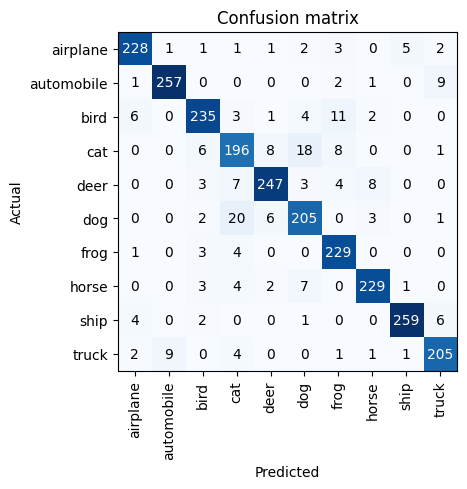

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

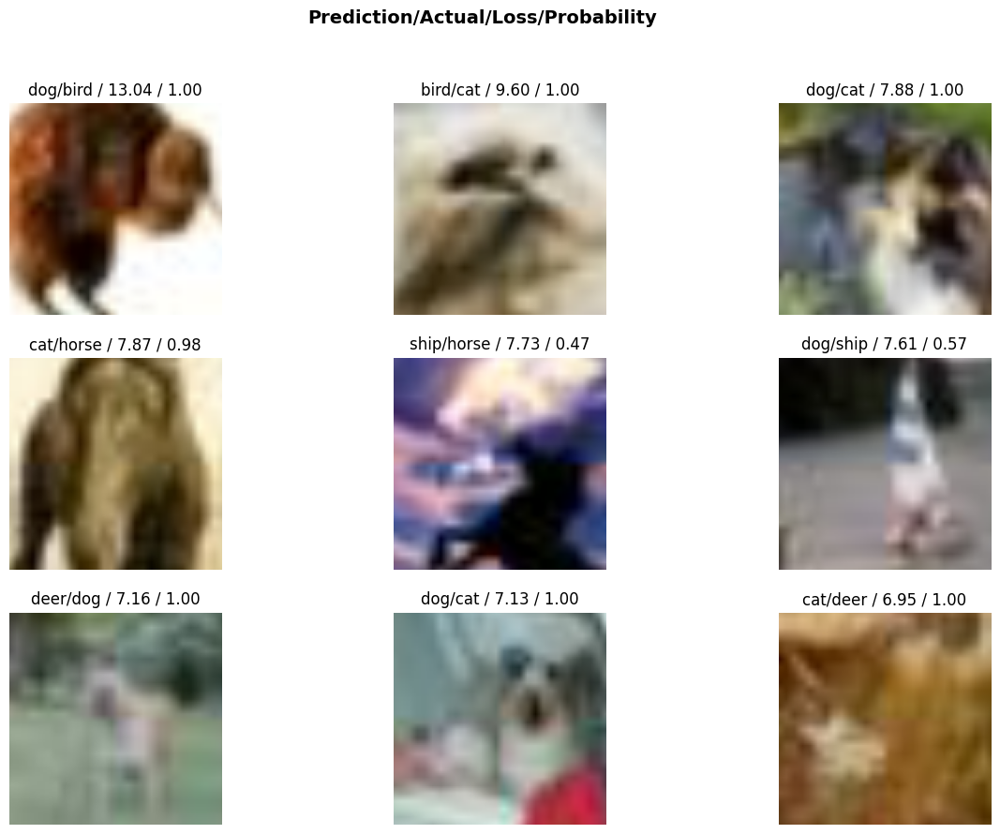

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsResNet.csv', index=False)

In [ ]:
df

,filename,predicted_class
0,0151.jpg,truck
1,0777.jpg,cat
2,4791.jpg,frog
3,6657.jpg,truck
4,0969.jpg,automobile
...,...,...
9995,9369.jpg,bird
9996,8759.jpg,ship
9997,2939.jpg,horse
9998,7767.jpg,cat


# TESTING ResNet 2 (progresive resizing) (lr=0.03, bs=128, size=256, freeze_epochs=2, image_size=256) [0.918800]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05, seed=42),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.02, bs=256, size=128, freeze_epochs=3, wd=0.001) [0.907200]

In [ ]:
#train the model
learn = cnn_learner(dls, resnet34, metrics=[accuracy, error_rate], pretrained=True, ps=0.001)
learn.fine_tune(epochs=3, base_lr=0.02, wd=0.001, freeze_epochs=3)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.876450,0.774597,0.736800,0.263200,01:40
1,0.528999,0.521458,0.818800,0.181200,01:27
2,0.418350,0.412550,0.857600,0.142400,01:24


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.470228,0.745438,0.779600,0.220400,01:32
1,0.330528,0.366874,0.870000,0.130000,01:32
2,0.177812,0.265599,0.907200,0.092800,01:35


### Iteració 2 (lr=0.02, bs=256, freeze_epochs=2, wd=0.001, image_size=256) [0.911200]

In [ ]:
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=256, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=3, base_lr=0.02, wd=0.001, freeze_epochs=2)

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.143138,0.295641,0.909600,0.090400,01:42
1,0.161819,0.313180,0.903600,0.096400,01:42


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.304238,0.612772,0.811200,0.188800,01:39
1,0.241372,0.324765,0.892400,0.107600,01:36
2,0.116761,0.263936,0.911200,0.088800,01:34


### Iteració 3 (lr=0.02, bs=128, freeze_epochs=1, wd=0.001, image_size=512) [0.918800]

In [ ]:
dls = dblock.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=512, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=5, base_lr=0.02, wd=0.001, freeze_epochs=1)

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.138340,0.363056,0.894400,0.105600,01:36


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.230916,0.455325,0.856400,0.143600,01:38
1,0.296936,0.388414,0.863600,0.136400,01:37
2,0.204601,0.328110,0.896000,0.104000,01:36
3,0.108908,0.274012,0.913600,0.086400,01:37
4,0.062110,0.262628,0.918800,0.081200,01:37


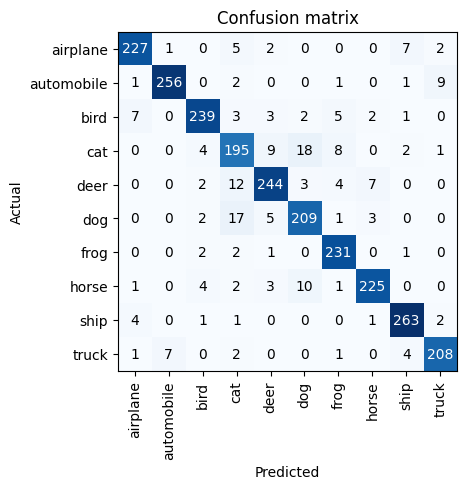

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

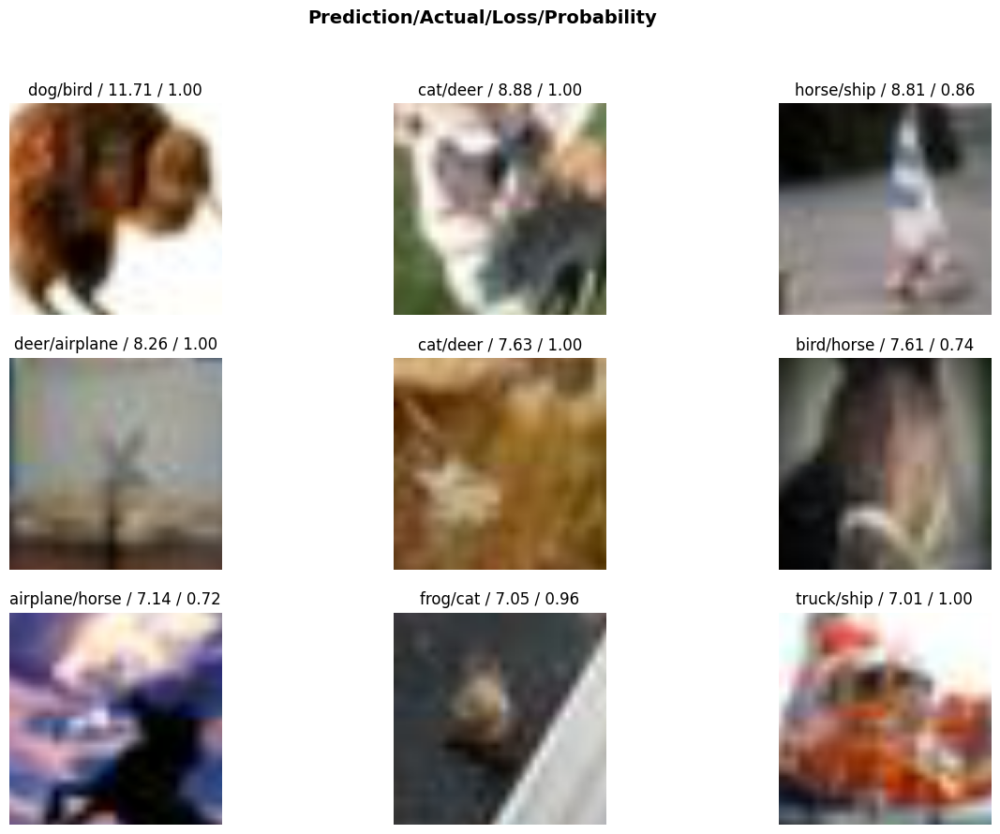

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsResNet2.csv', index=False)

In [ ]:
df

,filename,predicted_class
0,0151.jpg,truck
1,0777.jpg,cat
2,4791.jpg,frog
3,6657.jpg,truck
4,0969.jpg,automobile
...,...,...
9995,9369.jpg,bird
9996,8759.jpg,ship
9997,2939.jpg,horse
9998,7767.jpg,cat


# TESTING ResNet 3 (progresive resizing) (lr=0.03, bs=128, size=256, freeze_epochs=2, image_size=256) [0.879600]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05, seed=42),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.02, bs=256, size=128, freeze_epochs=3, wd=0.001) [0.910000]

In [ ]:
#train the model
learn = cnn_learner(dls, resnet34, metrics=[accuracy, error_rate], pretrained=True, ps=0.001)
learn.fine_tune(epochs=3, base_lr=0.02, wd=0.001, freeze_epochs=3)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.877433,0.785764,0.722400,0.277600,01:36
1,0.537165,0.460928,0.835200,0.164800,01:26
2,0.403418,0.432314,0.852000,0.148000,01:33


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.476404,0.585028,0.807200,0.192800,01:34
1,0.332970,0.366418,0.886000,0.114000,01:34
2,0.177570,0.269747,0.910000,0.090000,01:33


### Iteració 2 (lr=0.02, bs=256, freeze_epochs=2, wd=0.001, image_size=256) [0.916800]

In [ ]:
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=256, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=3, base_lr=0.02, wd=0.001, freeze_epochs=2)

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.138445,0.300048,0.912400,0.087600,01:30
1,0.168525,0.338556,0.898800,0.101200,01:24


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.312356,0.418628,0.860400,0.139600,01:31
1,0.240500,0.311253,0.900400,0.099600,01:30
2,0.113720,0.277247,0.916800,0.083200,01:30


### Iteració 3 (lr=0.01, bs=128, freeze_epochs=1, wd=0.001, image_size=512) [0.879600]

In [ ]:
from fastai.callback.all import *
dls = dblock.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=512, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Add the EarlyStoppingCallback and ReduceLROnPlateau
callbacks = [EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=2),
             ReduceLROnPlateau(monitor='accuracy', factor=0.2, min_delta=0.1, patience=1)]

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=20, base_lr=0.01, wd=0.001, freeze_epochs=1, cbs=callbacks)


Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.153498,0.344416,0.892800,0.107200,01:35


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.132522,0.311617,0.905600,0.094400,01:37
1,0.158600,0.342378,0.892000,0.108000,01:41
2,0.185555,0.399000,0.879600,0.120400,01:52


No improvement since epoch 0: early stopping


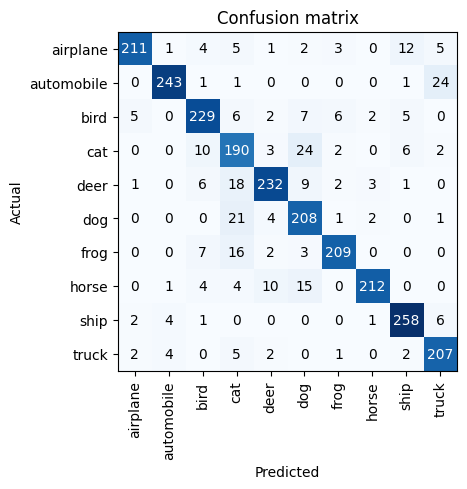

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

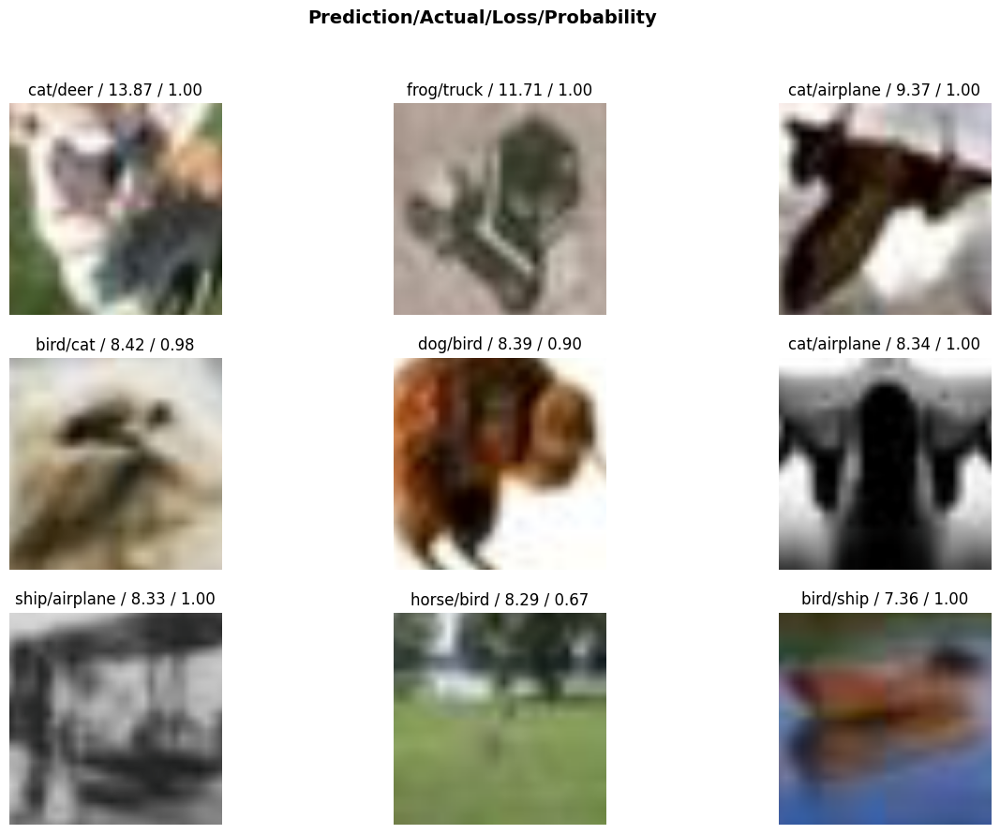

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsResNet3.csv', index=False)

In [ ]:
df

,filename,predicted_class
0,0151.jpg,truck
1,0777.jpg,cat
2,4791.jpg,frog
3,6657.jpg,truck
4,0969.jpg,automobile
...,...,...
9995,9369.jpg,bird
9996,8759.jpg,ship
9997,2939.jpg,horse
9998,7767.jpg,cat


# TESTING ResNet 4 (progresive resizing) (lr=0.03, bs=128, size=256, freeze_epochs=2, image_size=256) [0.899200]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05, seed=42),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.02, bs=256, size=128, freeze_epochs=3, wd=0.001, ps=0.001) [0.908800]

In [ ]:
#train the model
learn = cnn_learner(dls, resnet34, metrics=[accuracy, error_rate], pretrained=True, ps=0.001)
learn.fine_tune(epochs=3, base_lr=0.02, wd=0.001, freeze_epochs=3)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pt

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.876333,0.800316,0.740400,0.259600,01:50
1,0.525195,0.530666,0.827600,0.172400,01:39
2,0.404343,0.439496,0.852400,0.147600,01:40


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.473439,0.592804,0.802400,0.197600,01:45
1,0.325788,0.367063,0.875600,0.124400,01:43
2,0.176100,0.259467,0.908800,0.091200,01:45


### Iteració 2 (lr=0.01, bs=128, freeze_epochs=2, wd=0.001, image_size=512) [0.899200]

In [ ]:
from fastai.callback.all import *
dls = dblock.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=512, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Add the EarlyStoppingCallback and ReduceLROnPlateau
callbacks = [EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=2),
             ReduceLROnPlateau(monitor='accuracy', factor=0.2, min_delta=0.1, patience=1)]

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=20, base_lr=0.01, wd=0.001, freeze_epochs=2, cbs=callbacks)


Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.148464,0.279990,0.907200,0.092800,01:49
1,0.157079,0.327457,0.896000,0.104000,01:48


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.151026,0.285495,0.905200,0.094800,01:50
1,0.146330,0.292828,0.906000,0.094000,01:56
2,0.176015,0.319597,0.899200,0.100800,01:44


No improvement since epoch 0: early stopping


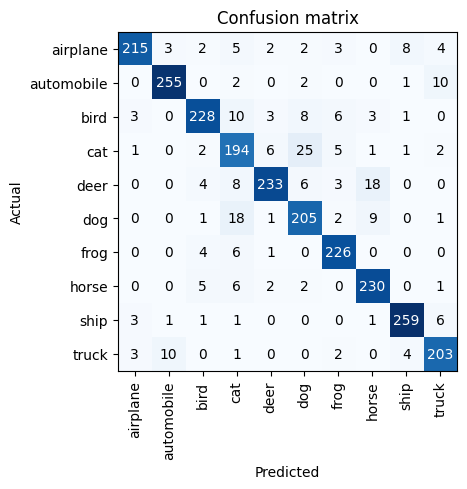

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

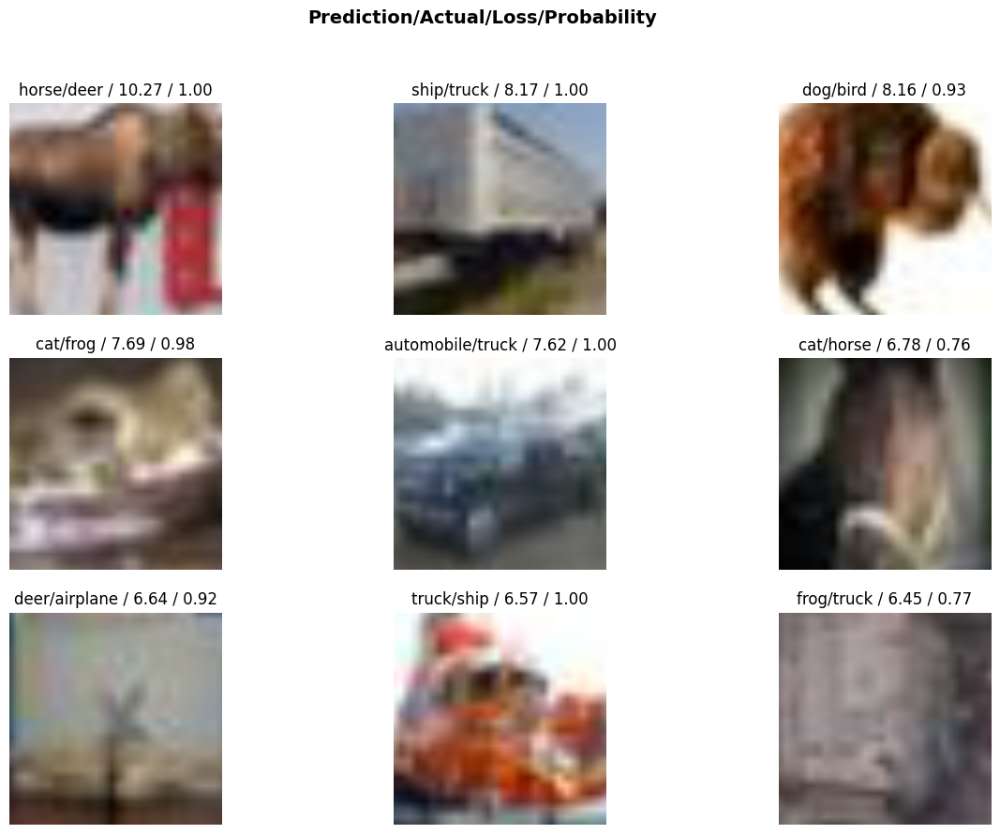

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsResNet.csv', index=False)

In [ ]:
df

,filename,predicted_class
0,0151.jpg,truck
1,0777.jpg,dog
2,4791.jpg,frog
3,6657.jpg,truck
4,0969.jpg,automobile
...,...,...
9995,9369.jpg,bird
9996,8759.jpg,ship
9997,2939.jpg,horse
9998,7767.jpg,cat


# TESTING ResNet 5 [0.968800]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.02, bs=256, size=128, freeze_epochs=3, wd=0.001, ps=0.001) [0.908800]

In [ ]:
#train the model
learn = cnn_learner(dls, resnet34, metrics=[accuracy, error_rate], pretrained=True, ps=0.001)
learn.fine_tune(epochs=7, base_lr=0.03, wd=0.001, freeze_epochs=3)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.823143,0.669271,0.768400,0.231600,01:48
1,0.484895,0.467176,0.850400,0.149600,01:38
2,0.413432,0.393492,0.856800,0.143200,01:36


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.430529,0.529658,0.821200,0.178800,01:36
1,0.439346,0.498802,0.828800,0.171200,01:34
2,0.378013,0.452930,0.842400,0.157600,01:34
3,0.275070,0.394217,0.865200,0.134800,01:33
4,0.187151,0.301956,0.895600,0.104400,01:33
5,0.106850,0.249238,0.914400,0.085600,01:33
6,0.070288,0.248632,0.919200,0.080800,01:34


### Iteració 2 (lr=0.01, bs=128, freeze_epochs=2, wd=0.001, image_size=512) [0.899200]

In [ ]:
from fastai.callback.all import *
dls = dblock.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=512, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Add the EarlyStoppingCallback and ReduceLROnPlateau
callbacks = [EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=2),
             ReduceLROnPlateau(monitor='accuracy', factor=0.2, min_delta=0.1, patience=1)]

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=20, base_lr=0.01, wd=0.001, freeze_epochs=2, cbs=callbacks)


Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.081342,0.062436,0.980400,0.019600,01:32
1,0.106437,0.081033,0.974400,0.025600,01:36


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.085689,0.066642,0.976800,0.023200,01:38
1,0.082903,0.086720,0.966400,0.033600,01:39
2,0.085967,0.103386,0.968800,0.031200,01:39


No improvement since epoch 0: early stopping


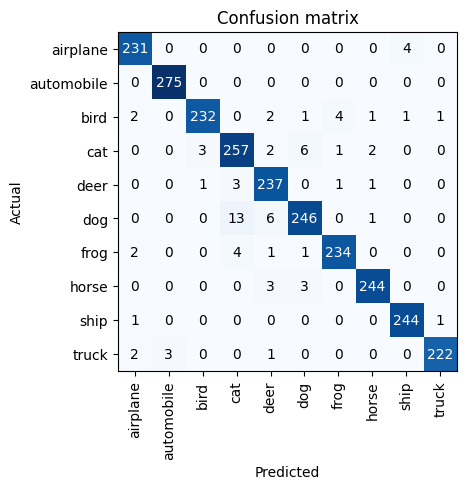

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

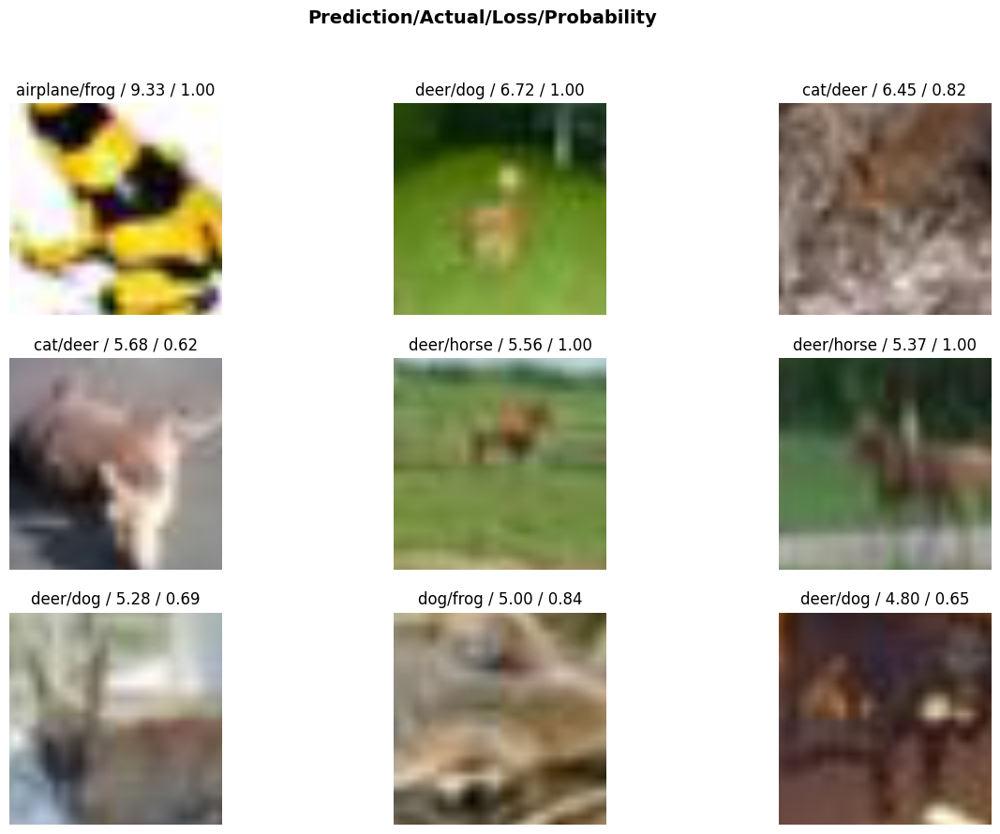

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsResNet5.csv', index=False)

In [ ]:
df

,filename,predicted_class
0,7531.jpg,frog
1,0110.jpg,airplane
2,1035.jpg,horse
3,2227.jpg,ship
4,2495.jpg,cat
...,...,...
9995,5169.jpg,cat
9996,5738.jpg,frog
9997,5572.jpg,dog
9998,9831.jpg,ship


# TESTING ResNet 8 [0.965600]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.02, bs=256, size=128, freeze_epochs=3, wd=0.001, ps=0.001) [0.908800]

In [ ]:
#train the model
learn = cnn_learner(dls, resnet34, metrics=[accuracy, error_rate], pretrained=True, ps=0.001)
learn.fine_tune(epochs=7, base_lr=0.03, wd=0.001, freeze_epochs=3)

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.787727,0.639727,0.778000,0.222000,01:39
1,0.490112,0.448775,0.852000,0.148000,01:35
2,0.411022,0.406969,0.857600,0.142400,01:31


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.425178,0.622457,0.803600,0.196400,01:34
1,0.452617,0.520186,0.816000,0.184000,01:35
2,0.366433,0.543759,0.823200,0.176800,01:34
3,0.280311,0.333749,0.887200,0.112800,01:33
4,0.189107,0.279556,0.908000,0.092000,01:33
5,0.108081,0.251167,0.918400,0.081600,01:33
6,0.069801,0.240425,0.922400,0.077600,01:33


### Iteració 2 (lr=0.01, bs=128, freeze_epochs=2, wd=0.001, image_size=512) [0.899200]

In [ ]:
from fastai.callback.all import *
dls = dblock.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=512, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Add the EarlyStoppingCallback and ReduceLROnPlateau
callbacks = [EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=1),
             ReduceLROnPlateau(monitor='accuracy', factor=0.2, min_delta=0.1, patience=1)]

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=20, base_lr=0.01, wd=0.001, freeze_epochs=1, cbs=callbacks)


Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.102773,0.102402,0.962800,0.037200,01:31


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.086994,0.078064,0.970400,0.029600,01:46
1,0.084679,0.089755,0.965600,0.034400,01:50


No improvement since epoch 0: early stopping


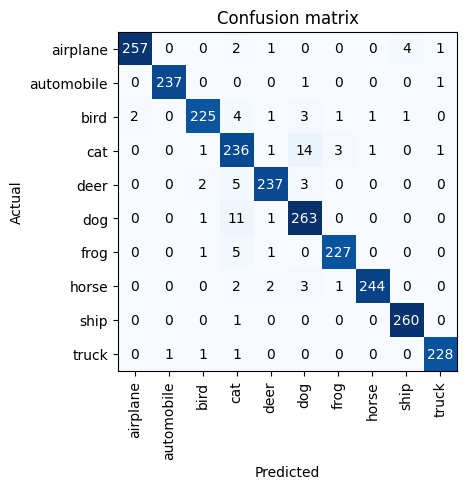

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

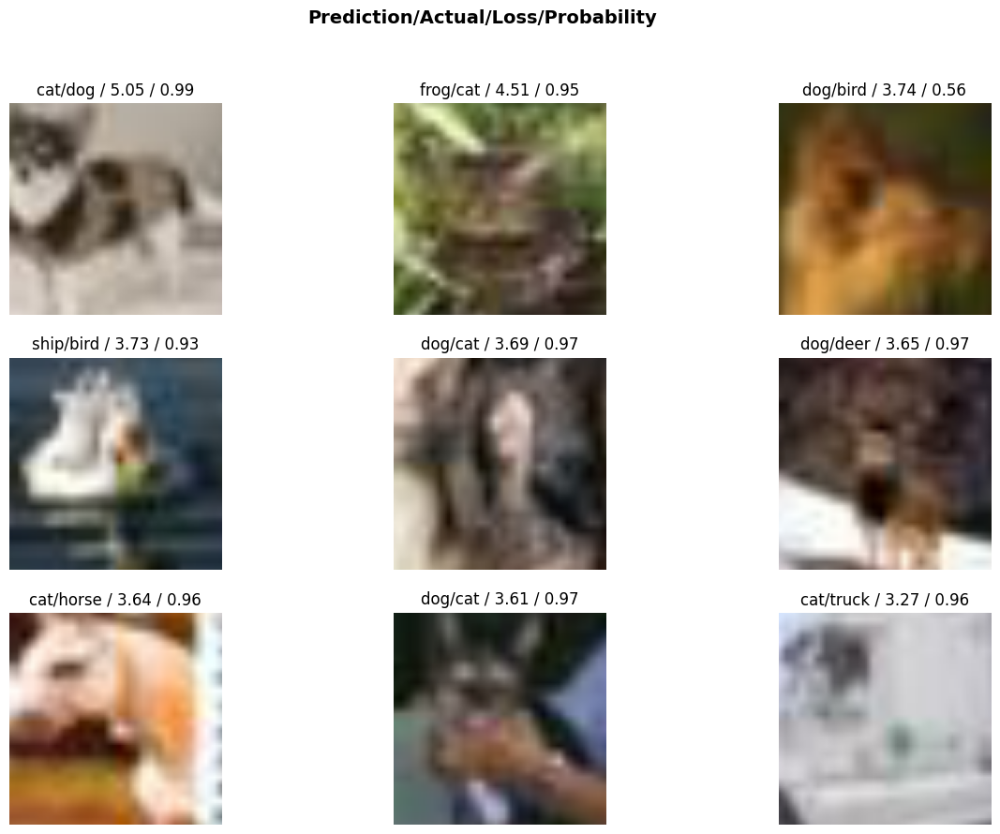

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsResNet8_S_.csv', index=False)

In [ ]:
df

,filename,predicted_class
0,7531.jpg,frog
1,0110.jpg,airplane
2,1035.jpg,horse
3,2227.jpg,ship
4,2495.jpg,dog
...,...,...
9995,5169.jpg,cat
9996,5738.jpg,frog
9997,5572.jpg,dog
9998,9831.jpg,ship


# DenseNet

## Param Tuning 1 {Iteration 6/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.920500]}
    'batch_size': [128,256,512],
    'learning_rate': [0.02,0.03,0.04,0.05],
    'weight_decay': [0.0],
    'dropout': [0.0],
    'freeze_epochs':[1]

learning_rate=0.02-->[0.9173];
{{learning_rate=0.03-->[0.9189]}};
learning_rate=0.04-->[0.9167]
learning_rate=0.05-->[0.9106]

batch_size=128-->[0.913175];
{{batch_size=256-->[0.918575]}};
batch_size=512-->[memory]

### Define datablock, dataloader and params

In [ ]:
from fastai.vision.all import *
from fastai.data.block import DataBlock
from sklearn.model_selection import ParameterSampler
import random
from sklearn.model_selection import ParameterGrid

In [ ]:
# Define the hyperparameter space to search over
param_grid = {
    'batch_size': [128,256,512],
    'learning_rate': [0.02,0.03,0.04,0.05],
    'weight_decay': [0.0],
    'dropout': [0.0],
    'freeze_epochs':[1]
}

In [ ]:
# Create a data block and data loaders with default parameters
path = Path('/content')
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    get_y=parent_label,
    splitter=GrandparentSplitter(valid_name='validation'),
    item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]
)
dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
# Define the number of random combinations to try
n_iter = len(list(ParameterGrid(param_grid)))

# Generate random combinations of hyperparameters
param_list = list(ParameterSampler(param_grid, n_iter=n_iter, random_state=42))

In [ ]:
len(list(ParameterGrid(param_grid)))

12

### Model

In [ ]:
from torchvision.models import densenet

In [ ]:
# Loop over the hyperparameter combinations
for i, params in enumerate(param_list):
    print(f'Iteration {i+1}/{n_iter} with params: {params}')

    # Update the data loaders with the current hyperparameters
    dls = data.dataloaders(path, bs=params['batch_size'], num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])


    # Create a simple model with the current hyperparameters
    learn = cnn_learner(dls, densenet121, metrics=[accuracy, error_rate], pretrained=True, ps=params['dropout'])

    # Fit the model with the current hyperparameters
    learn.fine_tune(3, base_lr=params['learning_rate'], wd=params['weight_decay'], freeze_epochs=params['freeze_epochs'])

    # Evaluate the model on the validation set
    acc = learn.validate()[1]
    print(f'Accuracy: {acc:.4f}')

    # Save the model and accuracy for later analysis
    learn.save(f'model_{i+1}')
    with open(f'accuracy_{i+1}.txt', 'w') as f:
        f.write(str(acc))

Iteration 1/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.635429,0.451680,0.846400,0.153600,02:23


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.552733,0.491942,0.834500,0.165500,02:41
1,0.393607,0.302640,0.895100,0.104900,02:41
2,0.223780,0.239420,0.914800,0.085200,02:45


Accuracy: 0.9148
Iteration 2/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.601556,0.470004,0.837100,0.162900,02:12


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.606728,0.555920,0.819600,0.180400,02:49
1,0.433867,0.337324,0.881400,0.118600,02:48
2,0.248057,0.240069,0.917300,0.082700,02:39


Accuracy: 0.9173
Iteration 3/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.613417,0.581113,0.811900,0.188100,02:13


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.637739,0.591322,0.801400,0.198600,02:40
1,0.443906,0.362101,0.875900,0.124100,02:40
2,0.272931,0.258134,0.914100,0.085900,02:41


Accuracy: 0.9141
Iteration 4/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.635298,0.556029,0.822100,0.177900,02:09


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.673179,0.728923,0.772000,0.228000,02:44


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.673179,0.728923,0.772000,0.228000,02:44
1,0.463797,0.409268,0.858400,0.141600,02:41
2,0.284246,0.268197,0.906500,0.093500,02:38


Accuracy: 0.9065
Iteration 5/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.744862,0.601279,0.807300,0.192700,02:10


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.514022,0.503948,0.831100,0.168900,02:39
1,0.376610,0.307431,0.896800,0.103200,02:39
2,0.215928,0.232675,0.919800,0.080200,02:39


Accuracy: 0.9198
Iteration 6/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.724183,0.533041,0.825000,0.175000,02:10


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.536620,0.452069,0.844700,0.155300,02:41
1,0.393961,0.314941,0.890900,0.109100,02:40
2,0.226983,0.238170,0.920500,0.079500,02:40


Accuracy: 0.9205
Iteration 7/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.698139,0.523444,0.837700,0.162300,02:10


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.569422,0.614375,0.800900,0.199100,02:39
1,0.413570,0.329131,0.887800,0.112200,02:40
2,0.242398,0.241545,0.919300,0.080700,02:40


Accuracy: 0.9193
Iteration 8/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.657410,0.592418,0.814800,0.185200,02:10


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.583609,0.486277,0.835000,0.165000,02:41
1,0.437723,0.344238,0.879600,0.120400,02:40
2,0.263256,0.245205,0.914700,0.085300,02:40


Accuracy: 0.9147
Iteration 9/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time


OutOfMemoryError: ignored

Iteration 1/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128} [0.9148]

Iteration 2/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128} [0.917300]

Iteration 3/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128} [0.9141]

Iteration 4/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128} [0.9065]

Iteration 5/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.9198]

{{Iteration 6/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.920500]}}

Iteration 7/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.919300]

Iteration 8/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.914700]

Iteration 9/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512} [out of memory]

learning_rate=0.02-->[0.9173];
{{learning_rate=0.03-->[0.9189]}};
learning_rate=0.04-->[0.9167]
learning_rate=0.05-->[0.9106]

batch_size=128-->[0.913175];
{{batch_size=256-->[0.918575]}}

## Param Tuning 2 {Iteration 10/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.005, 'batch_size': 256} [0.9237]}
    'batch_size': [256],
    'learning_rate': [0.03],
    'weight_decay': [0.0,0.005],
    'dropout': [0.0,0.005],
    'freeze_epochs':[1,2,3]

weight_decay=0.0-->[0.91967];
{{weight_decay=0.005-->[0.92068]}}

freeze_epochs=1-->[0.918575];
{{freeze_epochs=2-->[0.921425]}};
freeze_epochs=3-->[0.920525]

dropout=0.0-->[0.9192];
{{dropout=0.0005-->[0.92115]}}


### Define datablock, dataloader and params

In [ ]:
from fastai.vision.all import *
from fastai.data.block import DataBlock
from sklearn.model_selection import ParameterSampler
import random
from sklearn.model_selection import ParameterGrid

In [ ]:
# Define the hyperparameter space to search over
param_grid = {
    'batch_size': [256],
    'learning_rate': [0.03],
    'weight_decay': [0.0,0.005],
    'dropout': [0.0,0.005],
    'freeze_epochs':[1,2,3]
}

In [ ]:
# Create a data block and data loaders with default parameters
path = Path('/content')
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    get_y=parent_label,
    splitter=GrandparentSplitter(valid_name='validation'),
    item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]
)
dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
# Define the number of random combinations to try
n_iter = len(list(ParameterGrid(param_grid)))

# Generate random combinations of hyperparameters
param_list = list(ParameterSampler(param_grid, n_iter=n_iter, random_state=42))

In [ ]:
len(list(ParameterGrid(param_grid)))

12

### Model

In [ ]:
from torchvision.models import densenet

In [ ]:
# Loop over the hyperparameter combinations
for i, params in enumerate(param_list):
    print(f'Iteration {i+1}/{n_iter} with params: {params}')

    # Update the data loaders with the current hyperparameters
    dls = data.dataloaders(path, bs=params['batch_size'], num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])


    # Create a simple model with the current hyperparameters
    learn = cnn_learner(dls, densenet121, metrics=[accuracy, error_rate], pretrained=True, ps=params['dropout'])

    # Fit the model with the current hyperparameters
    learn.fine_tune(3, base_lr=params['learning_rate'], wd=params['weight_decay'], freeze_epochs=params['freeze_epochs'])

    # Evaluate the model on the validation set
    acc = learn.validate()[1]
    print(f'Accuracy: {acc:.4f}')

    # Save the model and accuracy for later analysis
    learn.save(f'model_{i+1}')
    with open(f'accuracy_{i+1}.txt', 'w') as f:
        f.write(str(acc))

Iteration 1/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 75.9MB/s]


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.697499,0.451379,0.847700,0.152300,02:26


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.533041,0.637878,0.798700,0.201300,02:54
1,0.394985,0.340303,0.885400,0.114600,02:47
2,0.234068,0.245192,0.915700,0.084300,02:44


Accuracy: 0.9157
Iteration 2/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.712332,0.522496,0.831100,0.168900,02:14


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.532230,0.658819,0.794300,0.205700,02:43
1,0.390889,0.304161,0.896600,0.103400,02:44
2,0.221829,0.239256,0.917700,0.082300,02:43


Accuracy: 0.9177
Iteration 3/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.776847,0.582619,0.802600,0.197400,02:15
1,0.496289,0.460776,0.853400,0.146600,02:16


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.508693,0.475650,0.840000,0.160000,02:46
1,0.378735,0.305822,0.897400,0.102600,02:47
2,0.216991,0.229346,0.921900,0.078100,02:47


Accuracy: 0.9219
Iteration 4/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.776808,0.597588,0.809700,0.190300,02:14
1,0.514366,0.456716,0.843200,0.156800,02:12


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.509315,0.501547,0.834700,0.165300,02:44
1,0.378762,0.307375,0.892200,0.107800,02:44
2,0.221209,0.233870,0.919000,0.081000,02:44


Accuracy: 0.9190
Iteration 5/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.813551,0.624731,0.787000,0.213000,02:12
1,0.541107,0.423842,0.857500,0.142500,02:11
2,0.434942,0.414931,0.862000,0.138000,02:12


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.494557,0.451562,0.857600,0.142400,02:41
1,0.367215,0.310602,0.891700,0.108300,02:42
2,0.216795,0.230350,0.919300,0.080700,02:42


Accuracy: 0.9193
Iteration 6/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.822936,0.610682,0.794000,0.206000,02:14
1,0.544132,0.456824,0.853800,0.146200,02:12
2,0.432767,0.398905,0.869300,0.130700,02:14


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.502719,0.586226,0.808100,0.191900,02:44
1,0.369772,0.319202,0.891100,0.108900,02:44
2,0.221682,0.227829,0.921600,0.078400,02:43


Accuracy: 0.9216
Iteration 7/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.005, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.695484,0.512413,0.839500,0.160500,02:12


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.542860,0.484920,0.837400,0.162600,02:43
1,0.389547,0.309958,0.896600,0.103400,02:42
2,0.231230,0.235745,0.920700,0.079300,02:43


Accuracy: 0.9207
Iteration 8/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.005, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.683908,0.522944,0.828400,0.171600,02:12


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.539803,0.566893,0.815600,0.184400,02:43
1,0.387810,0.357522,0.873800,0.126200,02:44
2,0.227407,0.235839,0.920200,0.079800,02:43


Accuracy: 0.9202
Iteration 9/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.005, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.761765,0.558951,0.818900,0.181100,02:14
1,0.497139,0.373212,0.871600,0.128400,02:13


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.509394,0.653239,0.799000,0.201000,02:46
1,0.381400,0.310338,0.894200,0.105800,02:46
2,0.221197,0.234777,0.921100,0.078900,02:46


Accuracy: 0.9211
Iteration 10/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.005, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.768979,0.599089,0.806500,0.193500,02:12
1,0.489223,0.446865,0.848000,0.152000,02:13


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.499493,0.491224,0.838700,0.161300,02:43
1,0.378955,0.349019,0.880900,0.119100,02:44
2,0.220193,0.227856,0.923700,0.076300,02:44


Accuracy: 0.9237
Iteration 11/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.005, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.817312,0.625661,0.792800,0.207200,02:13
1,0.548475,0.475357,0.847100,0.152900,02:13
2,0.431048,0.386798,0.870900,0.129100,02:13


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.493857,0.569099,0.814400,0.185600,02:43
1,0.371620,0.311242,0.892600,0.107400,02:43
2,0.218720,0.232978,0.919300,0.080700,02:42


Accuracy: 0.9193
Iteration 12/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.005, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.803353,0.609977,0.796500,0.203500,02:14
1,0.522440,0.454731,0.852100,0.147900,02:12
2,0.426661,0.400459,0.865700,0.134300,02:14


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.491640,0.459419,0.854800,0.145200,02:43
1,0.368534,0.306585,0.892000,0.108000,02:43
2,0.208732,0.234246,0.921900,0.078100,02:43


Accuracy: 0.9219


Iteration 1/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.9157]

Iteration 2/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.9177]

Iteration 3/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.0, 'batch_size': 256} [0.9219]

Iteration 4/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.0, 'batch_size': 256} [0.9190]

Iteration 5/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.0, 'batch_size': 256} [0.9193]

Iteration 6/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.0, 'batch_size': 256} [0.9216]

Iteration 7/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.005, 'batch_size': 256} [0.9207]

Iteration 8/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.005, 'batch_size': 256} [0.9202]

Iteration 9/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.005, 'batch_size': 256} [0.9211]

{{Iteration 10/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.005, 'batch_size': 256} [0.9237]}}

Iteration 11/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.005, 'batch_size': 256} [0.9193]

Iteration 12/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.005, 'batch_size': 256} [0.9219]

weight_decay=0.0-->[0.91967];
{{weight_decay=0.005-->[0.92068]}}

freeze_epochs=1-->[0.918575];
{{freeze_epochs=2-->[0.921425]}};
freeze_epochs=3-->[0.920525]

dropout=0.0-->[0.9192];
{{dropout=0.0005-->[0.92115]}}

## Param Tuning 3 {Iteration 4/8 with params: {'weight_decay': 0.01, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.005, 'batch_size': 256} [0.9239]}
    'batch_size': [256],
    'learning_rate': [0.03],
    'weight_decay': [0.005,0.01],
    'dropout': [0.005,0.01],
    'freeze_epochs':[2,3]


### Define datablock, dataloader and params

In [ ]:
from fastai.vision.all import *
from fastai.data.block import DataBlock
from sklearn.model_selection import ParameterSampler
import random
from sklearn.model_selection import ParameterGrid

In [ ]:
# Define the hyperparameter space to search over
param_grid = {
    'batch_size': [256],
    'learning_rate': [0.03],
    'weight_decay': [0.005,0.01],
    'dropout': [0.005,0.01],
    'freeze_epochs':[2,3]
}

In [ ]:
# Create a data block and data loaders with default parameters
path = Path('/content')
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    get_y=parent_label,
    splitter=GrandparentSplitter(valid_name='validation'),
    item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]
)
dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
# Define the number of random combinations to try
n_iter = len(list(ParameterGrid(param_grid)))

# Generate random combinations of hyperparameters
param_list = list(ParameterSampler(param_grid, n_iter=n_iter, random_state=42))

In [ ]:
len(list(ParameterGrid(param_grid)))

8

### Model

In [ ]:
from torchvision.models import densenet

In [ ]:
# Loop over the hyperparameter combinations
for i, params in enumerate(param_list):
    print(f'Iteration {i+1}/{n_iter} with params: {params}')

    # Update the data loaders with the current hyperparameters
    dls = data.dataloaders(path, bs=params['batch_size'], num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])


    # Create a simple model with the current hyperparameters
    learn = cnn_learner(dls, densenet121, metrics=[accuracy, error_rate], pretrained=True, ps=params['dropout'])

    # Fit the model with the current hyperparameters
    learn.fine_tune(3, base_lr=params['learning_rate'], wd=params['weight_decay'], freeze_epochs=params['freeze_epochs'])

    # Evaluate the model on the validation set
    acc = learn.validate()[1]
    print(f'Accuracy: {acc:.4f}')

    # Save the model and accuracy for later analysis
    learn.save(f'model_{i+1}')
    with open(f'accuracy_{i+1}.txt', 'w') as f:
        f.write(str(acc))

Iteration 1/8 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.005, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.767824,0.619726,0.804200,0.195800,02:13
1,0.520714,0.453283,0.851500,0.148500,02:17


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.513025,0.552895,0.819800,0.180200,02:48
1,0.373299,0.339670,0.886500,0.113500,02:48
2,0.225476,0.231067,0.921100,0.078900,02:49


Accuracy: 0.9211
Iteration 2/8 with params: {'weight_decay': 0.01, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.005, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.775489,0.660385,0.787900,0.212100,02:21
1,0.495407,0.407623,0.864400,0.135600,02:24


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.514857,0.555327,0.821100,0.178900,02:48
1,0.387540,0.294345,0.896600,0.103400,02:48
2,0.217558,0.229497,0.922000,0.078000,02:45


Accuracy: 0.9220
Iteration 3/8 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.005, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.803557,0.620690,0.792300,0.207700,02:15
1,0.530916,0.442572,0.852900,0.147100,02:15
2,0.430712,0.383275,0.869800,0.130200,02:15


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.486595,0.445785,0.847000,0.153000,02:45
1,0.376608,0.316450,0.890100,0.109900,02:47
2,0.214728,0.227554,0.922400,0.077600,02:45


Accuracy: 0.9224
Iteration 4/8 with params: {'weight_decay': 0.01, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.005, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.808252,0.621874,0.785800,0.214200,02:15
1,0.522086,0.505339,0.842800,0.157200,02:18
2,0.440733,0.418218,0.857100,0.142900,02:21


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.494641,0.494167,0.833000,0.167000,02:48
1,0.380100,0.324910,0.888100,0.111900,02:52
2,0.211797,0.228412,0.923900,0.076100,02:46


Accuracy: 0.9239
Iteration 5/8 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.01, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.779228,0.628729,0.794700,0.205300,02:21
1,0.500424,0.449813,0.849100,0.150900,02:19


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.520650,0.547882,0.815300,0.184700,02:51
1,0.391039,0.299046,0.896300,0.103700,02:47
2,0.218853,0.235464,0.921000,0.079000,02:44


Accuracy: 0.9210
Iteration 6/8 with params: {'weight_decay': 0.01, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.01, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.781565,0.642277,0.788800,0.211200,02:13
1,0.504643,0.431527,0.854700,0.145300,02:13


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.498943,0.486127,0.834900,0.165100,02:44
1,0.376245,0.294923,0.898300,0.101700,02:44
2,0.216852,0.233360,0.920600,0.079400,02:46


Accuracy: 0.9206
Iteration 7/8 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.01, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.807024,0.612796,0.793400,0.206600,02:19
1,0.522288,0.427503,0.859000,0.141000,02:15
2,0.444942,0.357297,0.880100,0.119900,02:14


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.506008,0.540001,0.815700,0.184300,02:44
1,0.376516,0.309375,0.894500,0.105500,02:44
2,0.205193,0.228424,0.919100,0.080900,02:43


Accuracy: 0.9191
Iteration 8/8 with params: {'weight_decay': 0.01, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.01, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.798362,0.599726,0.789300,0.210700,02:13
1,0.531894,0.457484,0.848100,0.151900,02:15
2,0.442680,0.378540,0.870500,0.129500,02:14


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.484856,0.542746,0.816100,0.183900,02:44
1,0.375867,0.333784,0.882800,0.117200,02:46
2,0.218174,0.222679,0.921900,0.078100,02:44


Accuracy: 0.9219


Iteration 1/8 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.005, 'batch_size': 256} [0.9211]

Iteration 2/8 with params: {'weight_decay': 0.01, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.005, 'batch_size': 256} [0.9220]

Iteration 3/8 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.005, 'batch_size': 256} [0.9224]

{{Iteration 4/8 with params: {'weight_decay': 0.01, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.005, 'batch_size': 256} [0.9239]}}

Iteration 5/8 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.01, 'batch_size': 256} [0.9210]

Iteration 6/8 with params: {'weight_decay': 0.01, 'learning_rate': 0.03, 'freeze_epochs': 2, 'dropout': 0.01, 'batch_size': 256} [0.9206]

Iteration 7/8 with params: {'weight_decay': 0.005, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.01, 'batch_size': 256} [0.9191]

Iteration 8/8 with params: {'weight_decay': 0.01, 'learning_rate': 0.03, 'freeze_epochs': 3, 'dropout': 0.01, 'batch_size': 256} [0.921900]

## Param Tuning 4 {** falta 6/6**Iteration 5/6 with params: {'weight_decay': 0.01, 'learning_rate': 0.01, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.005, 'batch_size': 256} [0.9329]}
    'batch_size': [256],
    'learning_rate': [0.01,0.03],
    'weight_decay': [0.01],
    'dropout': [0.005],
    'freeze_epochs':[3],
    'epochs':[3,5,7]

{{learning_rate=0.01-->[0.92723]}}
learning_rate=0.03-->[]

epochs=3-->[0.92095]
epochs=5-->[0.9273]
{{epochs=7-->[]}}

### Define datablock, dataloader and params

In [ ]:
from fastai.vision.all import *
from fastai.data.block import DataBlock
from sklearn.model_selection import ParameterSampler
import random
from sklearn.model_selection import ParameterGrid

In [ ]:
# Define the hyperparameter space to search over
param_grid = {
    'batch_size': [256],
    'learning_rate': [0.01,0.03],
    'weight_decay': [0.01],
    'dropout': [0.005],
    'freeze_epochs':[3],
    'epochs':[3,5,7]
}

In [ ]:
# Create a data block and data loaders with default parameters
path = Path('/content')
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    get_y=parent_label,
    splitter=GrandparentSplitter(valid_name='validation'),
    item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]
)
dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
# Define the number of random combinations to try
n_iter = len(list(ParameterGrid(param_grid)))

# Generate random combinations of hyperparameters
param_list = list(ParameterSampler(param_grid, n_iter=n_iter, random_state=42))

In [ ]:
len(list(ParameterGrid(param_grid)))

6

### Model

In [ ]:
from torchvision.models import densenet

In [ ]:
# Loop over the hyperparameter combinations
for i, params in enumerate(param_list):
    print(f'Iteration {i+1}/{n_iter} with params: {params}')

    # Update the data loaders with the current hyperparameters
    dls = data.dataloaders(path, bs=params['batch_size'], num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])


    # Create a simple model with the current hyperparameters
    learn = cnn_learner(dls, densenet121, metrics=[accuracy, error_rate], pretrained=True, ps=params['dropout'])

    # Fit the model with the current hyperparameters
    learn.fine_tune(params['epochs'], base_lr=params['learning_rate'], wd=params['weight_decay'], freeze_epochs=params['freeze_epochs'])

    # Evaluate the model on the validation set
    acc = learn.validate()[1]
    print(f'Accuracy: {acc:.4f}')

    # Save the model and accuracy for later analysis
    learn.save(f'model_{i+1}')
    with open(f'accuracy_{i+1}.txt', 'w') as f:
        f.write(str(acc))

Iteration 1/6 with params: {'weight_decay': 0.01, 'learning_rate': 0.01, 'freeze_epochs': 3, 'epochs': 3, 'dropout': 0.005, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 87.4MB/s]


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.960043,0.774453,0.738400,0.261600,02:17
1,0.636340,0.534907,0.818200,0.181800,02:14
2,0.467440,0.401143,0.864300,0.135700,02:13


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.418476,0.384592,0.871500,0.128500,02:45
1,0.311134,0.275815,0.907200,0.092800,02:45
2,0.173573,0.230221,0.921500,0.078500,02:45


Accuracy: 0.9215
Iteration 2/6 with params: {'weight_decay': 0.01, 'learning_rate': 0.03, 'freeze_epochs': 3, 'epochs': 3, 'dropout': 0.005, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.813754,0.573430,0.799600,0.200400,02:13
1,0.533066,0.425196,0.853400,0.146600,02:14
2,0.434604,0.388217,0.870700,0.129300,02:15


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.502555,0.460999,0.850800,0.149200,02:50
1,0.375524,0.311844,0.893400,0.106600,02:45
2,0.216228,0.230883,0.920400,0.079600,02:46


Accuracy: 0.9204
Iteration 3/6 with params: {'weight_decay': 0.01, 'learning_rate': 0.01, 'freeze_epochs': 3, 'epochs': 5, 'dropout': 0.005, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.969877,0.758353,0.739700,0.260300,02:14
1,0.633237,0.487014,0.834000,0.166000,02:15
2,0.465833,0.395966,0.866500,0.133500,02:15


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.357345,0.395765,0.872300,0.127700,02:46
1,0.356893,0.348886,0.888400,0.111600,02:48
2,0.259025,0.299962,0.896600,0.103400,02:46
3,0.161225,0.235467,0.924500,0.075500,02:47
4,0.099932,0.228600,0.927300,0.072700,02:45


Accuracy: 0.9273
Iteration 4/6 with params: {'weight_decay': 0.01, 'learning_rate': 0.03, 'freeze_epochs': 3, 'epochs': 5, 'dropout': 0.005, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.812825,0.662582,0.777700,0.222300,02:16
1,0.514986,0.430915,0.860100,0.139900,02:16
2,0.448432,0.370361,0.875700,0.124300,02:17


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.435967,0.426183,0.857300,0.142700,02:47
1,0.446940,0.372264,0.871800,0.128200,02:48
2,0.343747,0.309000,0.894900,0.105100,02:45
3,0.228665,0.236417,0.919400,0.080600,02:46
4,0.136115,0.219141,0.927300,0.072700,02:45


Accuracy: 0.9273
Iteration 5/6 with params: {'weight_decay': 0.01, 'learning_rate': 0.01, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.005, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.970760,0.745822,0.748500,0.251500,02:14
1,0.617032,0.494873,0.836500,0.163500,02:14
2,0.462121,0.378165,0.869700,0.130300,02:14


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.343862,0.328706,0.886600,0.113400,02:46
1,0.359555,0.337198,0.889200,0.110800,02:45
2,0.305675,0.350075,0.884100,0.115900,02:51
3,0.233484,0.274851,0.906800,0.093200,02:45
4,0.150972,0.251282,0.923300,0.076700,02:47
5,0.093993,0.224938,0.930800,0.069200,02:45
6,0.066243,0.223103,0.932900,0.067100,02:47


Accuracy: 0.9329
Iteration 6/6 with params: {'weight_decay': 0.01, 'learning_rate': 0.03, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.005, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time


Iteration 1/6 with params: {'weight_decay': 0.01, 'learning_rate': 0.01, 'freeze_epochs': 3, 'epochs': 3, 'dropout': 0.005, 'batch_size': 256} [0.9215]

Iteration 2/6 with params: {'weight_decay': 0.01, 'learning_rate': 0.03, 'freeze_epochs': 3, 'epochs': 3, 'dropout': 0.005, 'batch_size': 256} [0.9204]

Iteration 3/6 with params: {'weight_decay': 0.01, 'learning_rate': 0.01, 'freeze_epochs': 3, 'epochs': 5, 'dropout': 0.005, 'batch_size': 256} [0.9273]

Iteration 4/6 with params: {'weight_decay': 0.01, 'learning_rate': 0.03, 'freeze_epochs': 3, 'epochs': 5, 'dropout': 0.005, 'batch_size': 256} [0.9273]

{{Iteration 5/6 with params: {'weight_decay': 0.01, 'learning_rate': 0.01, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.005, 'batch_size': 256} [0.9329]}}

Iteration 6/6 with params: {'weight_decay': 0.01, 'learning_rate': 0.03, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.005, 'batch_size': 256} []

{{learning_rate=0.01-->[0.92723]}}
learning_rate=0.03-->[]

epochs=3-->[0.92095]
epochs=5-->[0.9273]
{{epochs=7-->[]}}

# TESTING DenseNet (progresive resizing) [0.907600]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05, seed=42),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.04, bs=256, freeze_epochs=3, image_size=128) [0.902800]

In [ ]:
from torchvision.models import densenet

#train the model
learn = cnn_learner(dls, densenet121, metrics=[accuracy, error_rate], pretrained=True, ps=0.0)
learn.fine_tune(epochs=3, base_lr=0.04, wd=0.0, freeze_epochs=3)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.614036,0.613397,0.804800,0.195200,02:29
1,0.416757,0.563659,0.824400,0.175600,02:27
2,0.382989,0.443366,0.860400,0.139600,02:24


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.453293,0.544489,0.816800,0.183200,02:59
1,0.314220,0.350459,0.876400,0.123600,02:59
2,0.163953,0.269915,0.902800,0.097200,03:02


### Iteració 2 (lr=0.03, bs=256, freeze_epochs=2, image_size=256) [0.915600]

In [ ]:
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=256, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=3, base_lr=0.03, wd=0.0, freeze_epochs=2)

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.135124,0.344865,0.895600,0.104400,02:32
1,0.180099,0.420201,0.880400,0.119600,02:45


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.261513,0.471864,0.851200,0.148800,03:07
1,0.193800,0.308616,0.900000,0.100000,03:06
2,0.092052,0.258341,0.915600,0.084400,03:02


### Iteració 3 (lr=0.01, bs=128, freeze_epochs=1, wd=0.001, image_size=512) [0.901600]

In [ ]:
from fastai.callback.all import *
dls = dblock.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=512, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Add the EarlyStoppingCallback and ReduceLROnPlateau
callbacks = [EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=2),
             ReduceLROnPlateau(monitor='accuracy', factor=0.2, min_delta=0.1, patience=1)]

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=20, base_lr=0.01, wd=0.0, freeze_epochs=1, cbs=callbacks)


Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.098908,0.312466,0.914400,0.085600,02:30


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.070552,0.274776,0.912800,0.087200,03:01
1,0.067573,0.311201,0.914800,0.085200,02:58
2,0.067684,0.340346,0.907600,0.092400,02:59


No improvement since epoch 0: early stopping


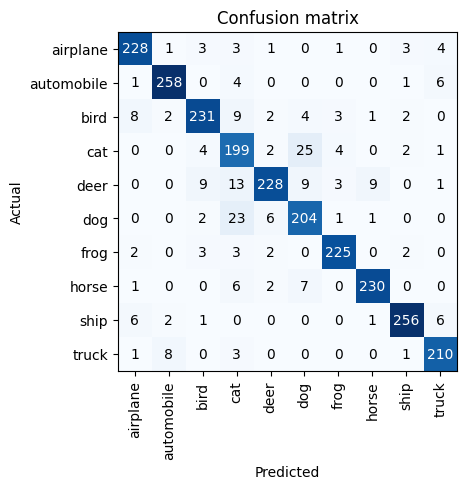

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

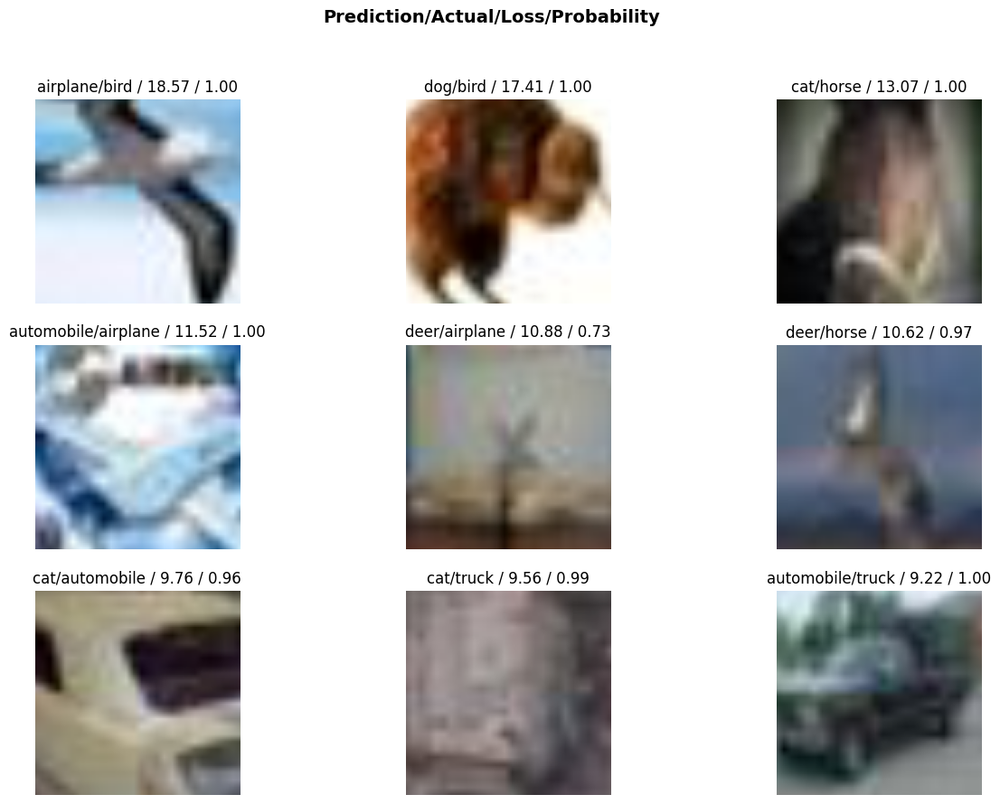

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsDenseNet.csv', index=False)

In [ ]:
df

,filename,predicted_class
0,0151.jpg,truck
1,0777.jpg,dog
2,4791.jpg,frog
3,6657.jpg,truck
4,0969.jpg,automobile
...,...,...
9995,9369.jpg,bird
9996,8759.jpg,ship
9997,2939.jpg,cat
9998,7767.jpg,cat


# TESTING DenseNet 2 (little progresive resizing) [0.957600]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.03, bs=256, freeze_epochs=3, image_size=128, wd=0.01, ps=0.005) [0.923200]

In [ ]:
from torchvision.models import densenet

#train the model
learn = cnn_learner(dls, densenet121, metrics=[accuracy, error_rate], pretrained=True, ps=0.005)
learn.fine_tune(epochs=3, base_lr=0.03, wd=0.01, freeze_epochs=3)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.635605,0.512898,0.820000,0.180000,02:24
1,0.414550,0.423961,0.857200,0.142800,02:22
2,0.358179,0.448534,0.849600,0.150400,02:21


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.408732,0.566048,0.823200,0.176800,03:00
1,0.286820,0.316752,0.892400,0.107600,02:58
2,0.141626,0.232439,0.923200,0.076800,02:58


### Iteració 2 (lr=0.01, bs=128, freeze_epochs=1, image_size=512, wd=0.01, ps=0.005) [0.957600]

In [ ]:
from fastai.callback.all import *
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=256, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Add the EarlyStoppingCallback and ReduceLROnPlateau
callbacks = [EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=2),
             ReduceLROnPlateau(monitor='accuracy', factor=0.25, min_delta=0.1, patience=1)]

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=20, base_lr=0.01, wd=0.01, freeze_epochs=1, cbs=callbacks)


Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.124246,0.111470,0.961200,0.038800,02:27


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.099934,0.089347,0.966000,0.034000,02:58
1,0.085663,0.101389,0.963200,0.036800,03:00
2,0.085975,0.123488,0.957600,0.042400,02:58


No improvement since epoch 0: early stopping


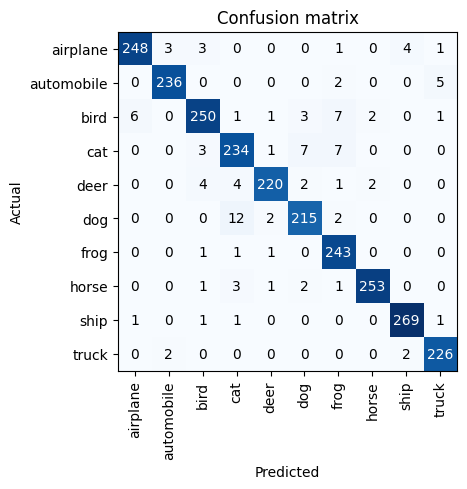

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

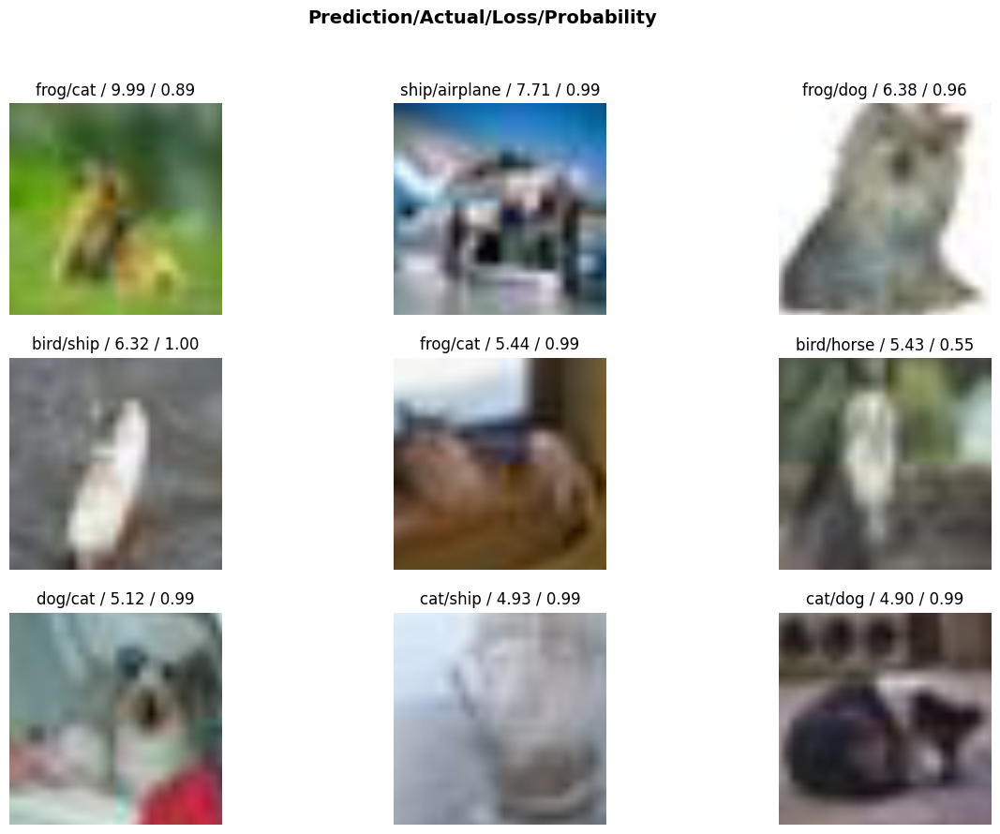

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsDenseNet2_S.csv', index=False)

In [ ]:
df

,filename,predicted_class
0,7531.jpg,frog
1,0110.jpg,airplane
2,1035.jpg,horse
3,2227.jpg,ship
4,2495.jpg,dog
...,...,...
9995,5169.jpg,dog
9996,5738.jpg,frog
9997,5572.jpg,dog
9998,9831.jpg,ship


# TESTING DenseNet3 (no progresive resizing) [0.866800]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner (lr=0.01, bs=256, freeze_epochs=3, image_size=128, wd=0.01, ps=0.005)

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
from torchvision.models import densenet

# Add the EarlyStoppingCallback and ReduceLROnPlateau
callbacks = [EarlyStoppingCallback(monitor='accuracy', min_delta=0.001, patience=2),
             ReduceLROnPlateau(monitor='accuracy', factor=0.25, min_delta=0.1, patience=1)]

# Step 4: Fine-tune the model with larger image size
learn = cnn_learner(dls, densenet121, metrics=[accuracy, error_rate], pretrained=True, ps=0.005)
learn.fine_tune(epochs=20, base_lr=0.01, wd=0.01, freeze_epochs=3, cbs=callbacks)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.811262,0.714567,0.769200,0.230800,02:21
1,0.495128,0.448899,0.842400,0.157600,02:26
2,0.371177,0.396630,0.872400,0.127600,02:22


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.225575,0.289393,0.901600,0.098400,03:03
1,0.176193,0.304379,0.901600,0.098400,03:00
2,0.180049,0.316475,0.902800,0.097200,03:00
3,0.185436,0.362863,0.884000,0.116000,03:00
4,0.193055,0.419343,0.866800,0.133200,02:59


No improvement since epoch 2: early stopping


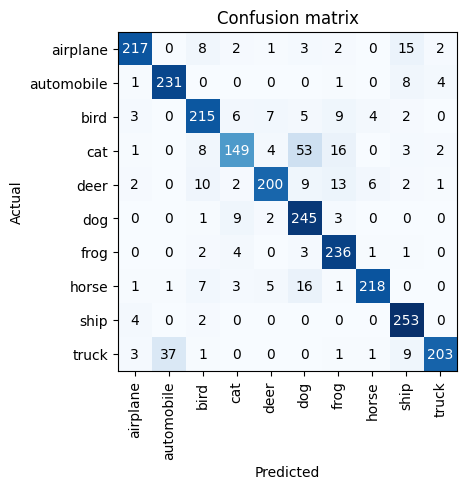

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

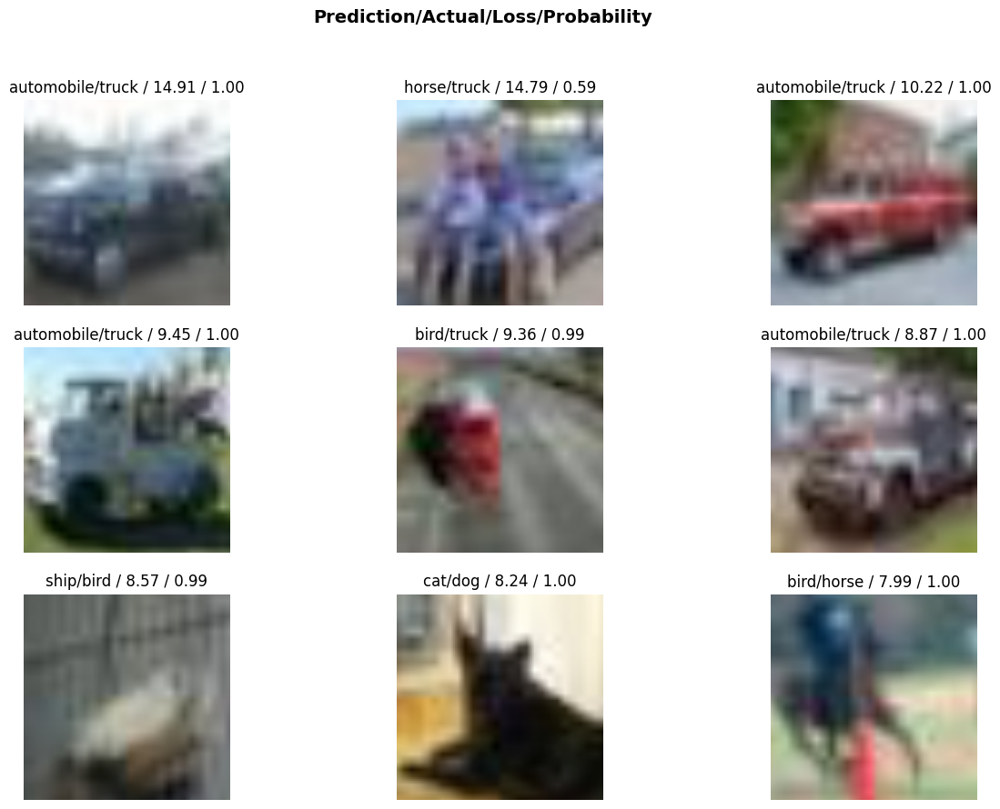

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsDenseNet3_S.csv', index=False)

In [ ]:
df

,filename,predicted_class
0,7531.jpg,frog
1,0110.jpg,bird
2,1035.jpg,horse
3,2227.jpg,ship
4,2495.jpg,dog
...,...,...
9995,5169.jpg,automobile
9996,5738.jpg,frog
9997,5572.jpg,dog
9998,9831.jpg,ship


# TESTING DenseNet 4 (little progresive resizing) [0.972400]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.03, bs=256, freeze_epochs=3, image_size=128, wd=0.01, ps=0.005)

In [ ]:
from torchvision.models import densenet

#train the model
learn = cnn_learner(dls, densenet121, metrics=[accuracy, error_rate], pretrained=True, ps=0.001)
learn.fine_tune(epochs=3, base_lr=0.03, wd=0.015, freeze_epochs=3)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.648398,0.624292,0.781600,0.218400,02:23
1,0.415518,0.444888,0.850400,0.149600,02:37
2,0.362690,0.405405,0.858000,0.142000,02:30


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.410636,0.645725,0.789200,0.210800,03:01
1,0.288764,0.330387,0.891600,0.108400,02:59
2,0.144195,0.257928,0.908400,0.091600,02:59


### Iteració 2 (lr=0.01, bs=128, freeze_epochs=1, image_size=512, wd=0.01, ps=0.005)

In [ ]:
from fastai.callback.all import *
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=256, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Add the EarlyStoppingCallback and ReduceLROnPlateau
callbacks = [EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=1),
             ReduceLROnPlateau(monitor='accuracy', factor=0.25, min_delta=0.1, patience=1)]

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=20, base_lr=0.005, wd=0.015, freeze_epochs=1, cbs=callbacks)


Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.113630,0.103516,0.965200,0.034800,02:39


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.094192,0.088341,0.969200,0.030800,03:03
1,0.083804,0.083207,0.972400,0.027600,03:01


No improvement since epoch 0: early stopping


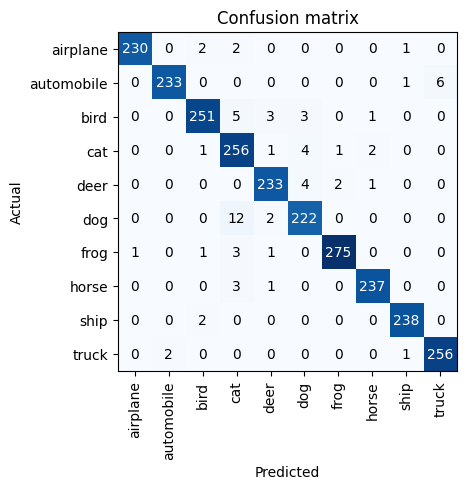

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

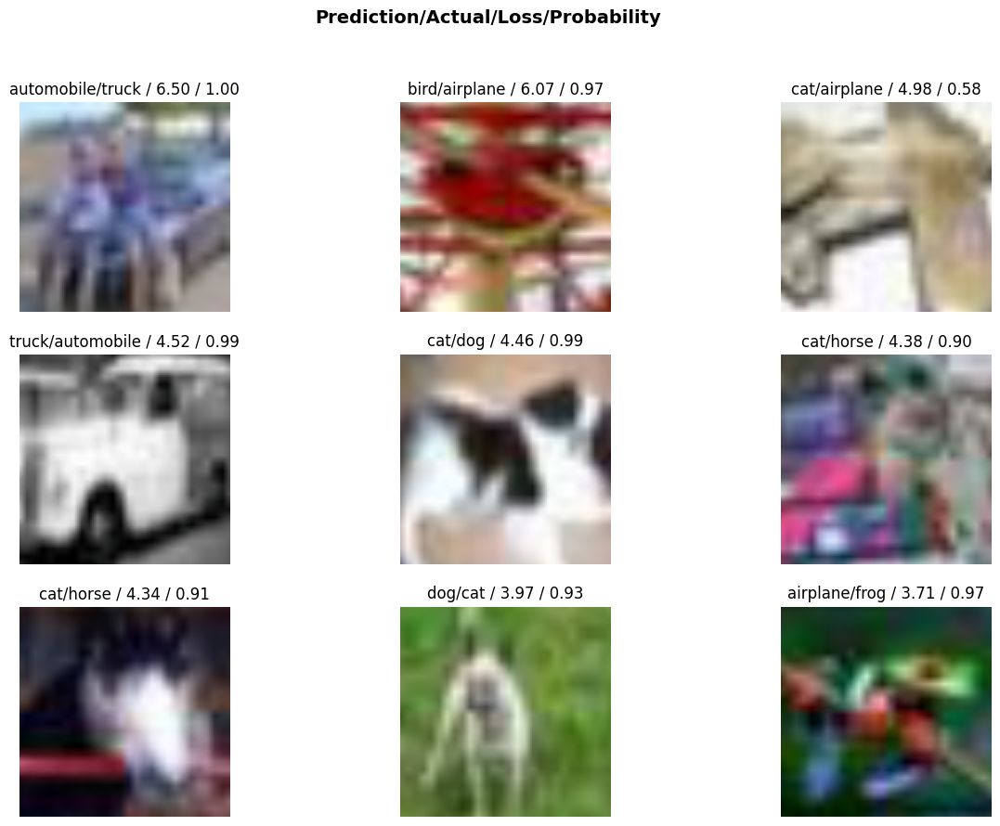

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsDenseNet4_S.csv', index=False)

In [ ]:
df

,filename,predicted_class
0,7531.jpg,frog
1,0110.jpg,airplane
2,1035.jpg,horse
3,2227.jpg,ship
4,2495.jpg,dog
...,...,...
9995,5169.jpg,dog
9996,5738.jpg,frog
9997,5572.jpg,dog
9998,9831.jpg,ship


# TESTING DenseNet 5 (little progresive resizing) [0.936000]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.03, bs=256, freeze_epochs=3, image_size=128, wd=0.01, ps=0.005)

In [ ]:
from torchvision.models import densenet

#train the model
learn = cnn_learner(dls, densenet121, metrics=[accuracy, error_rate], pretrained=True, ps=0.001)
learn.fine_tune(epochs=3, base_lr=0.03, wd=0.015, freeze_epochs=3)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.656829,0.549286,0.816800,0.183200,02:24
1,0.416161,0.443074,0.861200,0.138800,02:23
2,0.355868,0.421186,0.867600,0.132400,02:24


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.407882,0.658751,0.795600,0.204400,03:00
1,0.294919,0.310175,0.892000,0.108000,02:59
2,0.148155,0.225942,0.924800,0.075200,03:00


### Iteració 2 (lr=0.01, bs=128, freeze_epochs=1, image_size=512, wd=0.01, ps=0.005)

In [ ]:
from fastai.callback.all import *
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=256, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Add the EarlyStoppingCallback and ReduceLROnPlateau
callbacks = [EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=1),
             ReduceLROnPlateau(monitor='accuracy', factor=0.25, min_delta=0.1, patience=1)]

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=20, base_lr=0.02, wd=0.015, freeze_epochs=1, cbs=callbacks)


Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.156164,0.219835,0.926000,0.074000,02:29


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.115252,0.154066,0.950000,0.050000,03:01
1,0.111548,0.196754,0.936000,0.064000,03:01


No improvement since epoch 0: early stopping


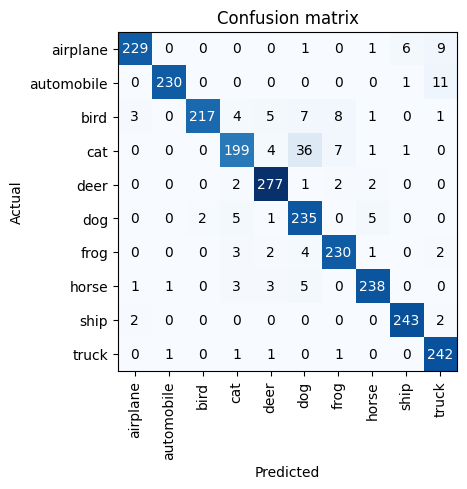

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

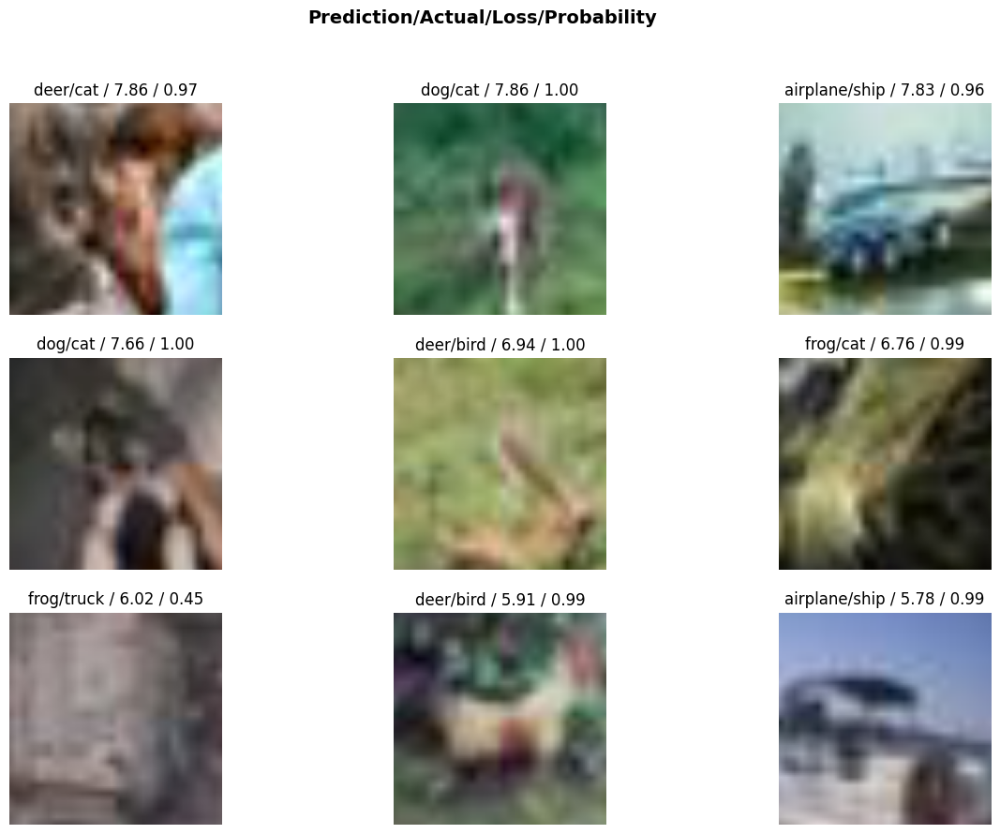

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsDenseNet5_S.csv', index=False)

In [ ]:
df

,filename,predicted_class
0,7531.jpg,frog
1,0110.jpg,airplane
2,1035.jpg,horse
3,2227.jpg,ship
4,2495.jpg,dog
...,...,...
9995,5169.jpg,cat
9996,5738.jpg,frog
9997,5572.jpg,dog
9998,9831.jpg,ship


# TESTING DenseNet 6 (little progresive resizing) [0.968800]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.03, bs=256, freeze_epochs=3, image_size=128, wd=0.01, ps=0.005)

In [ ]:
from torchvision.models import densenet

#train the model
learn = cnn_learner(dls, densenet121, metrics=[accuracy, error_rate], pretrained=True, ps=0.001)
learn.fine_tune(epochs=3, base_lr=0.03, wd=0.015, freeze_epochs=3)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 203MB/s]


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.646723,0.588094,0.811200,0.188800,02:41
1,0.420859,0.480085,0.854800,0.145200,02:29
2,0.350283,0.377848,0.874400,0.125600,02:25


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.405797,0.429391,0.860000,0.140000,03:04
1,0.293972,0.278405,0.901600,0.098400,03:04
2,0.147231,0.209053,0.929200,0.070800,03:04


### Iteració 2 (lr=0.01, bs=128, freeze_epochs=1, image_size=512, wd=0.01, ps=0.005)

In [ ]:
from fastai.callback.all import *
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=256, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Add the EarlyStoppingCallback and ReduceLROnPlateau
callbacks = [EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=1),
             ReduceLROnPlateau(monitor='accuracy', factor=0.25, min_delta=0.1, patience=1)]

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=20, base_lr=0.005, wd=0.015, freeze_epochs=1, cbs=callbacks)


Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.111970,0.109194,0.966800,0.033200,02:29


epoch,train_loss,valid_loss,accuracy,error_rate,time


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.096903,0.092960,0.969200,0.030800,03:04
1,0.084955,0.095134,0.968800,0.031200,03:02


No improvement since epoch 0: early stopping


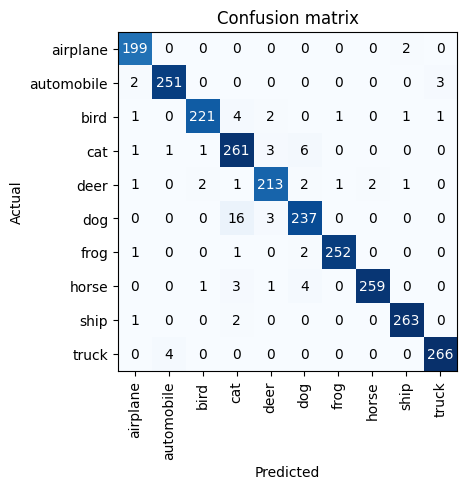

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

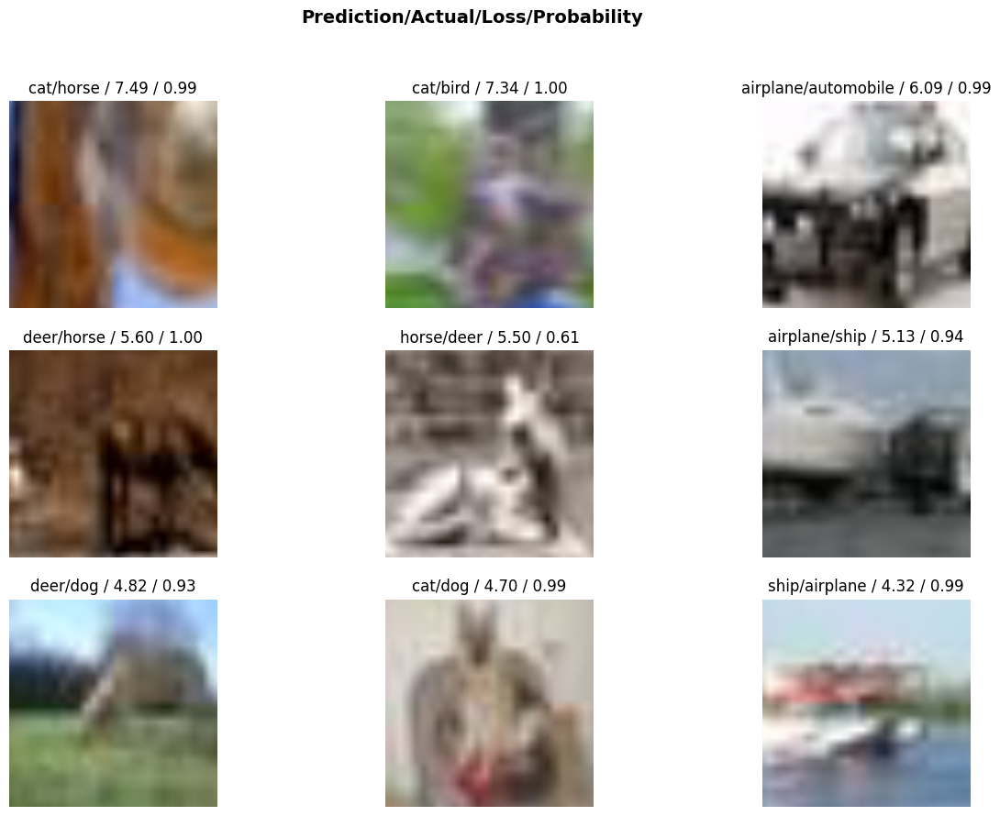

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsDenseNet6_S.csv', index=False)

In [ ]:
df

,filename,predicted_class
0,7531.jpg,frog
1,0110.jpg,airplane
2,1035.jpg,horse
3,2227.jpg,ship
4,2495.jpg,dog
...,...,...
9995,5169.jpg,cat
9996,5738.jpg,frog
9997,5572.jpg,dog
9998,9831.jpg,ship


,filename,predicted_class
0,7531.jpg,frog
1,0110.jpg,airplane
2,1035.jpg,horse
3,2227.jpg,ship
4,2495.jpg,dog
...,...,...
9995,5169.jpg,cat
9996,5738.jpg,frog
9997,5572.jpg,dog
9998,9831.jpg,ship


# EfficientNet

## Param Tuning 1 {Iteration 12/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512} [0.8951]}
    'batch_size': [128,256, 512],
    'learning_rate': [0.02,0.03,0.04,0.05],
    'weight_decay': [0.0],
    'dropout': [0.0],
    'freeze_epochs':[1]

Learning_rate=0.02-->[0.838167];
Learning_rate=0.03-->[0.86753];
Learning_rate=0.04-->[0.8856];
{{Learning_rate=0.05-->[0.8928]}}


batch_size=128-->[0.8712];
batch_size=256-->[0.87025];
{{batch_size=512-->[0.871625]}}

### Define datablock, dataloader and params

In [ ]:
from fastai.vision.all import *
from fastai.data.block import DataBlock
from sklearn.model_selection import ParameterSampler
import random
from sklearn.model_selection import ParameterGrid

In [ ]:
# Define the hyperparameter space to search over
param_grid = {
    'batch_size': [128,256,512],
    'learning_rate': [0.02,0.03,0.04,0.05],
    'weight_decay': [0.0],
    'dropout': [0.0],
    'freeze_epochs':[1]
}

In [ ]:
path = Path('/content')
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    get_y=parent_label,
    splitter=GrandparentSplitter(valid_name='validation'),
    item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]
)
dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
# Define the number of random combinations to try
n_iter = len(list(ParameterGrid(param_grid)))

# Generate random combinations of hyperparameters
param_list = list(ParameterSampler(param_grid, n_iter=n_iter, random_state=42))

In [ ]:
len(list(ParameterGrid(param_grid)))

12

### Model

In [ ]:
from fastai.vision.all import *
from fastai.vision.models import efficientnet_b0

In [ ]:
# Loop over the hyperparameter combinations
for i, params in enumerate(param_list):
    print(f'Iteration {i+1}/{n_iter} with params: {params}')

    # Update the data loaders with the current hyperparameters
    dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])
    # Create a simple model with the current hyperparameters
    learn = cnn_learner(dls, efficientnet_b0, metrics=[accuracy, error_rate], pretrained=True, ps=None)

    # Fit the model with the current hyperparameters
    learn.fine_tune(3, base_lr=params['learning_rate'], wd=params['weight_decay'], freeze_epochs=params['freeze_epochs'])

    # Evaluate the model on the validation set
    acc = learn.validate()[1]
    print(f'Accuracy: {acc:.4f}')

    # Save the model and accuracy for later analysis
    learn.save(f'model_{i+1}')
    with open(f'accuracy_{i+1}.txt', 'w') as f:
        f.write(str(acc))


Iteration 1/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B0_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B0_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-3dd342df.pth" to /root/.cache/torch/hub/c

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,5.175812,3.449013,0.367400,0.632600,01:39


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.191943,0.798703,0.750900,0.249100,01:45
1,0.700441,0.524304,0.824800,0.175200,01:47
2,0.606078,0.493188,0.837600,0.162400,01:46


Accuracy: 0.8376
Iteration 2/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,3.898922,2.382470,0.493200,0.506800,01:33


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.925659,0.632219,0.796100,0.203900,01:44
1,0.568758,0.424034,0.858100,0.141900,01:45
2,0.480451,0.394242,0.867300,0.132700,01:53


Accuracy: 0.8673
Iteration 3/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,3.156622,1.824347,0.562800,0.437200,01:38


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.763942,0.520871,0.824100,0.175900,01:48
1,0.509736,0.376246,0.875000,0.125000,01:45
2,0.415729,0.342561,0.886100,0.113900,01:46


Accuracy: 0.8861
Iteration 4/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,2.564814,1.412454,0.613900,0.386100,01:38


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.692509,0.481585,0.841700,0.158300,01:56
1,0.471777,0.337743,0.884000,0.116000,01:50
2,0.374424,0.314304,0.893800,0.106200,01:49


Accuracy: 0.8938
Iteration 5/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,5.173594,3.459943,0.366000,0.634000,01:36


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.265832,0.840499,0.747000,0.253000,01:47
1,0.702533,0.534592,0.825900,0.174100,01:46
2,0.610965,0.495264,0.837700,0.162300,01:48


Accuracy: 0.8377
Iteration 6/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,3.907470,2.327716,0.499600,0.500400,01:47


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.932920,0.631691,0.793700,0.206300,01:47
1,0.580518,0.425070,0.855800,0.144200,01:47
2,0.470859,0.395271,0.866900,0.133100,01:47


Accuracy: 0.8669
Iteration 7/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,3.022640,1.736848,0.562700,0.437300,01:36


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.764399,0.516185,0.825400,0.174600,01:49
1,0.506125,0.367935,0.877100,0.122900,01:49
2,0.399914,0.340306,0.886900,0.113100,01:49


Accuracy: 0.8869
Iteration 8/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,2.529608,1.389234,0.616200,0.383800,01:35


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.681970,0.503667,0.825300,0.174700,01:46
1,0.455488,0.344313,0.880400,0.119600,01:54
2,0.360175,0.315085,0.889500,0.110500,01:57


Accuracy: 0.8895
Iteration 9/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,5.201430,3.541560,0.332800,0.667200,01:38


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.248645,0.843239,0.745500,0.254500,01:50
1,0.714679,0.535352,0.828200,0.171800,01:48
2,0.608586,0.496486,0.839200,0.160800,01:50


Accuracy: 0.8392
Iteration 10/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,3.956141,2.323250,0.500900,0.499100,01:50


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.907301,0.610070,0.799700,0.200300,01:48
1,0.546641,0.419696,0.859700,0.140300,01:48
2,0.471684,0.391840,0.868400,0.131600,01:48


Accuracy: 0.8684
Iteration 11/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,3.020652,1.705158,0.575600,0.424400,01:38


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.738627,0.526387,0.822500,0.177500,01:49
1,0.508208,0.367534,0.876300,0.123700,01:50
2,0.404259,0.340489,0.883800,0.116200,01:57


Accuracy: 0.8838
Iteration 12/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,2.620729,1.451759,0.609600,0.390400,01:38


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.695098,0.489896,0.838200,0.161800,01:50
1,0.463977,0.339334,0.885400,0.114600,01:48
2,0.362704,0.312590,0.895100,0.104900,01:48


Accuracy: 0.8951


Iteration 1/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128} [0.8376]

Iteration 2/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128} [0.8673]

Iteration 3/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128} [0.8861]

{Iteration 4/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 128} [0.8938]}

Iteration 5/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.8377]

Iteration 6/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.8669]

Iteration 7/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.8869]

Iteration 8/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 256} [0.8895]

Iteration 9/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.02, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512} [0.8392]

Iteration 10/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.03, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512} [0.8684]

Iteration 11/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.04, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512} [0.8838]

{{Iteration 12/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512} [0.8951]}}

Learning_rate=0.02-->[0.838167];
Learning_rate=0.03-->[0.86753];
Learning_rate=0.04-->[0.8856];
{{Learning_rate=0.05-->[0.8928]}}


batch_size=128-->[0.8712];
batch_size=256-->[0.87025];
{{batch_size=512-->[0.871625]}}


## Param Tuning 2 {Iteration 12/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.05, 'freeze_epochs': 3, 'dropout': 0.005, 'batch_size': 512} [0.9049]}
    'batch_size': [512],
    'learning_rate': [0.05],
    'weight_decay': [0.0,0.005],
    'dropout': [0.0,0.005],
    'freeze_epochs':[1,2,3]

{{weight_decay=0.0-->[0.8992167]}}
weight_decay=0.005-->[0.8981]

freeze_epochs=1-->[0.8938]
freeze_epochs=2-->[0.899875]
{{freeze_epochs=3-->[0.9023]}}

dropout=0.0-->[0.8976167]
{{dropout=0.005-->[0.8997]}}


### Define datablock, dataloader and params

In [ ]:
from fastai.vision.all import *
from fastai.data.block import DataBlock
from sklearn.model_selection import ParameterSampler
import random
from sklearn.model_selection import ParameterGrid

In [ ]:
# Define the hyperparameter space to search over
param_grid = {
    'batch_size': [512],
    'learning_rate': [0.05],
    'weight_decay': [0.0,0.005],
    'dropout': [0.0,0.005],
    'freeze_epochs':[1,2,3]
}

In [ ]:
path = Path('/content')
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    get_y=parent_label,
    splitter=GrandparentSplitter(valid_name='validation'),
    item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]
)
dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
# Define the number of random combinations to try
n_iter = len(list(ParameterGrid(param_grid)))

# Generate random combinations of hyperparameters
param_list = list(ParameterSampler(param_grid, n_iter=n_iter, random_state=42))

In [ ]:
len(list(ParameterGrid(param_grid)))

12

### Model

In [ ]:
from fastai.vision.all import *
from fastai.vision.models import efficientnet_b0

In [ ]:
# Loop over the hyperparameter combinations
for i, params in enumerate(param_list):
    print(f'Iteration {i+1}/{n_iter} with params: {params}')

    # Update the data loaders with the current hyperparameters
    dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])
    # Create a simple model with the current hyperparameters
    learn = cnn_learner(dls, efficientnet_b0, metrics=[accuracy, error_rate], pretrained=True, ps=None)

    # Fit the model with the current hyperparameters
    learn.fine_tune(3, base_lr=params['learning_rate'], wd=params['weight_decay'], freeze_epochs=params['freeze_epochs'])

    # Evaluate the model on the validation set
    acc = learn.validate()[1]
    print(f'Accuracy: {acc:.4f}')

    # Save the model and accuracy for later analysis
    learn.save(f'model_{i+1}')
    with open(f'accuracy_{i+1}.txt', 'w') as f:
        f.write(str(acc))


Iteration 1/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B0_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B0_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,2.616893,1.498986,0.591200,0.408800,01:52


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.692858,0.491774,0.835500,0.164500,01:47
1,0.477460,0.344282,0.884500,0.115500,01:47
2,0.362248,0.315900,0.892900,0.107100,01:47


Accuracy: 0.8929
Iteration 2/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,2.602665,1.473015,0.605900,0.394100,01:42


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.696060,0.483850,0.841600,0.158400,02:05
1,0.461556,0.350348,0.881000,0.119000,01:46
2,0.367791,0.318455,0.889400,0.110600,01:52


Accuracy: 0.8894
Iteration 3/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 2, 'dropout': 0.0, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,5.228905,3.272817,0.379900,0.620100,01:41
1,1.114577,0.804728,0.737900,0.262100,01:54


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.618765,0.439121,0.851700,0.148300,02:12
1,0.436825,0.322338,0.891200,0.108800,02:08
2,0.337403,0.294353,0.901700,0.098300,01:52


Accuracy: 0.9017
Iteration 4/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.05, 'freeze_epochs': 2, 'dropout': 0.0, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,5.328179,3.496332,0.366900,0.633100,01:35
1,1.136863,0.827523,0.729600,0.270400,01:34


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.608750,0.442170,0.849100,0.150900,01:46
1,0.436533,0.328999,0.886600,0.113400,01:49
2,0.335056,0.303174,0.897000,0.103000,01:46


Accuracy: 0.8970
Iteration 5/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 3, 'dropout': 0.0, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,7.129301,5.753494,0.104900,0.895100,01:44
1,1.607775,1.109085,0.666100,0.333900,01:35
2,0.821188,0.624174,0.790500,0.209500,01:35


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.568917,0.416056,0.855200,0.144800,01:46
1,0.435773,0.318845,0.889900,0.110100,01:47
2,0.336085,0.291773,0.900800,0.099200,01:46


Accuracy: 0.9008
Iteration 6/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.05, 'freeze_epochs': 3, 'dropout': 0.0, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,7.022366,5.849960,0.104100,0.895900,01:33
1,1.610984,1.135455,0.665100,0.334900,01:33
2,0.828074,0.632988,0.786500,0.213500,01:34


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.568071,0.412873,0.858400,0.141600,01:46
1,0.415366,0.308172,0.896200,0.103800,01:46
2,0.316545,0.287418,0.903900,0.096100,01:46


Accuracy: 0.9039
Iteration 7/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.005, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,2.605963,1.465241,0.595600,0.404400,01:35


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.698759,0.498758,0.830300,0.169700,02:00
1,0.466949,0.343523,0.888400,0.111600,01:46
2,0.365031,0.312059,0.897000,0.103000,01:46


Accuracy: 0.8970
Iteration 8/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.005, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,2.611631,1.461860,0.614000,0.386000,01:34


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.692115,0.467078,0.840200,0.159800,01:47
1,0.472803,0.338355,0.885700,0.114300,01:46
2,0.362529,0.314275,0.895900,0.104100,01:50


Accuracy: 0.8959
Iteration 9/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 2, 'dropout': 0.005, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,5.383334,3.406263,0.377600,0.622400,01:35
1,1.111246,0.798360,0.741100,0.258900,01:34


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.618408,0.428111,0.854700,0.145300,01:46
1,0.433007,0.321058,0.890900,0.109100,01:48
2,0.343185,0.295456,0.903300,0.096700,01:45


Accuracy: 0.9033
Iteration 10/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.05, 'freeze_epochs': 2, 'dropout': 0.005, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,5.295493,3.129974,0.397100,0.602900,01:34
1,1.099117,0.790284,0.740200,0.259800,01:36


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.613096,0.433797,0.849400,0.150600,01:48
1,0.441411,0.323906,0.888500,0.111500,01:47
2,0.336111,0.301735,0.897500,0.102500,01:46


Accuracy: 0.8975
Iteration 11/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 3, 'dropout': 0.005, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,7.153030,5.835474,0.105100,0.894900,01:35
1,1.641854,1.153410,0.658300,0.341700,01:34
2,0.843985,0.640209,0.786100,0.213900,01:34


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.569897,0.415903,0.861300,0.138700,01:46
1,0.418749,0.313899,0.891500,0.108500,02:02
2,0.327286,0.293569,0.899600,0.100400,01:45


Accuracy: 0.8996
Iteration 12/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.05, 'freeze_epochs': 3, 'dropout': 0.005, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,7.263732,5.684973,0.114600,0.885400,01:35
1,1.539355,1.043420,0.691500,0.308500,01:37
2,0.813510,0.617890,0.795400,0.204600,01:35


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.565702,0.414614,0.857000,0.143000,01:48
1,0.407001,0.318410,0.890800,0.109200,01:48
2,0.324361,0.283246,0.904900,0.095100,01:47


Accuracy: 0.9049


Iteration 1/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512} [0.8929]

Iteration 2/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.0, 'batch_size': 512} [0.8894]

Iteration 3/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 2, 'dropout': 0.0, 'batch_size': 512} [0.9017]

Iteration 4/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.05, 'freeze_epochs': 2, 'dropout': 0.0, 'batch_size': 512} [0.8970]

Iteration 5/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 3, 'dropout': 0.0, 'batch_size': 512} [0.9008]

Iteration 6/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.05, 'freeze_epochs': 3, 'dropout': 0.0, 'batch_size': 512} [0.9039]

Iteration 7/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.005, 'batch_size': 512} [0.8970]

Iteration 8/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.05, 'freeze_epochs': 1, 'dropout': 0.005, 'batch_size': 512} [0.8959]

Iteration 9/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 2, 'dropout': 0.005, 'batch_size': 512} [0.9033]

Iteration 10/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.05, 'freeze_epochs': 2, 'dropout': 0.005, 'batch_size': 512} [0.8975]

Iteration 11/12 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 3, 'dropout': 0.005, 'batch_size': 512} [0.8996]

{{Iteration 12/12 with params: {'weight_decay': 0.005, 'learning_rate': 0.05, 'freeze_epochs': 3, 'dropout': 0.005, 'batch_size': 512} [0.9049]}}

{{weight_decay=0.0-->[0.8992167]}}
weight_decay=0.005-->[0.8981]

freeze_epochs=1-->[0.8938]
freeze_epochs=2-->[0.899875]
{{freeze_epochs=3-->[0.9023]}}

dropout=0.0-->[0.8976167]
{{dropout=0.005-->[0.8997]}}

## Param Tuning 3 {Iteration 5/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.3, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.005, 'batch_size': 512} [0.9233]}
    'batch_size': [512],
    'learning_rate': [0.3,0.05],
    'weight_decay': [0.0],
    'dropout': [0.005],
    'freeze_epochs':[3],
    'epochs':[3,5,7]

{{learning_rate=0.3-->[0.917567]}}
learning_rate=0.05-->[0.91353]

epochs=3-->[0.9058]
epochs=5-->[0.919]
{{epochs=7-->[0.92185]}}

### Define datablock, dataloader and params

In [ ]:
from fastai.vision.all import *
from fastai.data.block import DataBlock
from sklearn.model_selection import ParameterSampler
import random
from sklearn.model_selection import ParameterGrid

In [ ]:
# Define the hyperparameter space to search over
param_grid = {
    'batch_size': [512],
    'learning_rate': [0.3,0.05],
    'weight_decay': [0.0],
    'dropout': [0.005],
    'freeze_epochs':[3],
    'epochs':[3,5,7]
}

In [ ]:
path = Path('/content')
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    get_y=parent_label,
    splitter=GrandparentSplitter(valid_name='validation'),
    item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]
)
dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
# Define the number of random combinations to try
n_iter = len(list(ParameterGrid(param_grid)))

# Generate random combinations of hyperparameters
param_list = list(ParameterSampler(param_grid, n_iter=n_iter, random_state=42))

In [ ]:
len(list(ParameterGrid(param_grid)))

6

### Model

In [ ]:
from fastai.vision.all import *
from fastai.vision.models import efficientnet_b0

In [ ]:
# Loop over the hyperparameter combinations
for i, params in enumerate(param_list):
    print(f'Iteration {i+1}/{n_iter} with params: {params}')

    # Update the data loaders with the current hyperparameters
    dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])
    # Create a simple model with the current hyperparameters
    learn = cnn_learner(dls, efficientnet_b0, metrics=[accuracy, error_rate], pretrained=True, ps=None)

    # Fit the model with the current hyperparameters
    learn.fine_tune(params['epochs'], base_lr=params['learning_rate'], wd=params['weight_decay'], freeze_epochs=params['freeze_epochs'])

    # Evaluate the model on the validation set
    acc = learn.validate()[1]
    print(f'Accuracy: {acc:.4f}')

    # Save the model and accuracy for later analysis
    learn.save(f'model_{i+1}')
    with open(f'accuracy_{i+1}.txt', 'w') as f:
        f.write(str(acc))


Iteration 1/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.3, 'freeze_epochs': 3, 'epochs': 3, 'dropout': 0.005, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.998053,1.182524,0.652200,0.347800,01:46
1,0.745763,0.645437,0.785000,0.215000,01:32
2,0.643941,0.775035,0.746400,0.253600,01:35


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.603802,0.467598,0.842400,0.157600,01:45
1,0.436310,0.338851,0.885200,0.114800,01:44
2,0.280795,0.262117,0.907200,0.092800,01:46


Accuracy: 0.9072
Iteration 2/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 3, 'epochs': 3, 'dropout': 0.005, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,7.135321,5.771516,0.109200,0.890800,01:43
1,1.574998,1.101967,0.665800,0.334200,01:32
2,0.818611,0.634465,0.786500,0.213500,01:30


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.572750,0.421272,0.854800,0.145200,01:43
1,0.410950,0.309875,0.896300,0.103700,01:42
2,0.326489,0.286988,0.904400,0.095600,01:42


Accuracy: 0.9044
Iteration 3/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.3, 'freeze_epochs': 3, 'epochs': 5, 'dropout': 0.005, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.976155,1.171018,0.648300,0.351700,01:31
1,0.746118,0.733824,0.760900,0.239100,01:31
2,0.645426,0.524807,0.818300,0.181700,01:30


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.574213,0.443906,0.849300,0.150700,01:43
1,0.539081,0.450550,0.849300,0.150700,01:41
2,0.408973,0.315982,0.890000,0.110000,01:42
3,0.286501,0.251085,0.913100,0.086900,01:41


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.574213,0.443906,0.849300,0.150700,01:43
1,0.539081,0.450550,0.849300,0.150700,01:41
2,0.408973,0.315982,0.890000,0.110000,01:42
3,0.286501,0.251085,0.913100,0.086900,01:41
4,0.198627,0.234635,0.922200,0.077800,01:41


Accuracy: 0.9222
Iteration 4/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 3, 'epochs': 5, 'dropout': 0.005, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,7.177323,5.857971,0.104700,0.895300,01:29
1,1.563179,1.117963,0.672300,0.327700,01:28
2,0.828579,0.626899,0.790500,0.209500,01:30


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.582063,0.439825,0.849400,0.150600,01:41
1,0.464731,0.339370,0.882800,0.117200,01:40
2,0.353194,0.294748,0.902100,0.097900,01:39
3,0.272278,0.258343,0.914200,0.085800,01:40
4,0.232780,0.255506,0.915800,0.084200,01:40


Accuracy: 0.9158
Iteration 5/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.3, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.005, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,1.944677,1.127694,0.663100,0.336900,01:28
1,0.759378,0.647034,0.778100,0.221900,01:28
2,0.637685,0.515116,0.823500,0.176500,01:29


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.533679,0.418542,0.857200,0.142800,01:39
1,0.545531,0.499926,0.833400,0.166600,01:40
2,0.475146,0.382113,0.869400,0.130600,01:41
3,0.375840,0.318203,0.892300,0.107700,01:39
4,0.282625,0.273666,0.908600,0.091400,01:40
5,0.192523,0.237902,0.921000,0.079000,01:41
6,0.150182,0.234560,0.923300,0.076700,01:41


Accuracy: 0.9233
Iteration 6/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.005, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,7.131998,5.758879,0.102700,0.897300,01:34
1,1.550960,1.078773,0.674700,0.325300,01:32
2,0.816027,0.632436,0.786000,0.214000,01:32


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.587038,0.437967,0.848800,0.151200,01:40
1,0.468707,0.362950,0.877800,0.122200,01:41
2,0.374951,0.312948,0.891700,0.108300,01:40
3,0.307974,0.275413,0.908100,0.091900,01:42
4,0.237591,0.251464,0.919300,0.080700,01:42
5,0.206500,0.249068,0.919300,0.080700,01:41
6,0.183020,0.247297,0.920400,0.079600,01:41


Accuracy: 0.9204


Iteration 1/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.3, 'freeze_epochs': 3, 'epochs': 3, 'dropout': 0.005, 'batch_size': 512} [0.9072]

Iteration 2/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 3, 'epochs': 3, 'dropout': 0.005, 'batch_size': 512} [0.9044]

Iteration 3/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.3, 'freeze_epochs': 3, 'epochs': 5, 'dropout': 0.005, 'batch_size': 512} [0.9222]

Iteration 4/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 3, 'epochs': 5, 'dropout': 0.005, 'batch_size': 512} [0.9158]

{{Iteration 5/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.3, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.005, 'batch_size': 512} [0.9233]}}

Iteration 6/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.05, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.005, 'batch_size': 512} [0.9204]

{{learning_rate=0.3-->[0.917567]}}
learning_rate=0.05-->[0.91353]

epochs=3-->[0.9058]
epochs=5-->[0.919]
{{epochs=7-->[0.92185]}}


## Param Tuning 4 {Iteration 6/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.1, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.005, 'batch_size': 512} [0.9286]}
    'batch_size': [512],
    'learning_rate': [0.2,0.1],
    'weight_decay': [0.0],
    'dropout': [0.005],
    'freeze_epochs':[3],
    'epochs':[3,5,7]

learning_rate=0.1-->[0.92063]
{{learning_rate=0.2-->[0.9211]}}

epochs=3-->[0.9125]
epochs=5-->[0.92375]
{{epochs=7-->[0.92635]}}

### Define datablock, dataloader and params

In [ ]:
from fastai.vision.all import *
from fastai.data.block import DataBlock
from sklearn.model_selection import ParameterSampler
import random
from sklearn.model_selection import ParameterGrid

In [ ]:
# Define the hyperparameter space to search over
param_grid = {
    'batch_size': [512],
    'learning_rate': [0.2,0.1],
    'weight_decay': [0.0],
    'dropout': [0.005],
    'freeze_epochs':[3],
    'epochs':[3,5,7]
}

In [ ]:
path = Path('/content')
data = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    get_y=parent_label,
    splitter=GrandparentSplitter(valid_name='validation'),
    item_tfms=[RandomResizedCrop(128, min_scale=0.5), FlipItem(p=0.5)],
    batch_tfms=[Normalize.from_stats(*imagenet_stats)]
)
dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


In [ ]:
# Define the number of random combinations to try
n_iter = len(list(ParameterGrid(param_grid)))

# Generate random combinations of hyperparameters
param_list = list(ParameterSampler(param_grid, n_iter=n_iter, random_state=42))

In [ ]:
len(list(ParameterGrid(param_grid)))

6

### Model

In [ ]:
from fastai.vision.all import *
from fastai.vision.models import efficientnet_b0

In [ ]:
# Loop over the hyperparameter combinations
for i, params in enumerate(param_list):
    print(f'Iteration {i+1}/{n_iter} with params: {params}')

    # Update the data loaders with the current hyperparameters
    dls = data.dataloaders(path, bs=128, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])
    # Create a simple model with the current hyperparameters
    learn = cnn_learner(dls, efficientnet_b0, metrics=[accuracy, error_rate], pretrained=True, ps=None)

    # Fit the model with the current hyperparameters
    learn.fine_tune(params['epochs'], base_lr=params['learning_rate'], wd=params['weight_decay'], freeze_epochs=params['freeze_epochs'])

    # Evaluate the model on the validation set
    acc = learn.validate()[1]
    print(f'Accuracy: {acc:.4f}')

    # Save the model and accuracy for later analysis
    learn.save(f'model_{i+1}')
    with open(f'accuracy_{i+1}.txt', 'w') as f:
        f.write(str(acc))


Iteration 1/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.2, 'freeze_epochs': 3, 'epochs': 3, 'dropout': 0.005, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B0_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B0_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-3dd342df.pth" to /root/.cache/torch/hub/c

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,2.602348,1.510912,0.599600,0.400400,01:46
1,0.789576,0.631080,0.789000,0.211000,01:29
2,0.627349,0.500358,0.832300,0.167700,01:28


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.575616,0.432080,0.853800,0.146200,01:43
1,0.402100,0.307301,0.895000,0.105000,01:41
2,0.267918,0.248312,0.913900,0.086100,01:42


Accuracy: 0.9139
Iteration 2/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.1, 'freeze_epochs': 3, 'epochs': 3, 'dropout': 0.005, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,4.769205,3.076684,0.415100,0.584900,01:30
1,1.039067,0.793082,0.738600,0.261400,01:28
2,0.689128,0.526723,0.818200,0.181800,01:40


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.532743,0.390483,0.866700,0.133300,01:42
1,0.388487,0.296286,0.897300,0.102700,01:42
2,0.272235,0.257583,0.911100,0.088900,01:41


Accuracy: 0.9111
Iteration 3/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.2, 'freeze_epochs': 3, 'epochs': 5, 'dropout': 0.005, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,2.758274,1.550936,0.599300,0.400700,01:28
1,0.792734,0.698123,0.774500,0.225500,01:29
2,0.629663,0.516535,0.826700,0.173300,01:28


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.538089,0.424004,0.859900,0.140100,01:42
1,0.482672,0.354215,0.879300,0.120700,01:41
2,0.363157,0.299109,0.896700,0.103300,01:42
3,0.238426,0.243251,0.918000,0.082000,01:41
4,0.182105,0.230036,0.925300,0.074700,01:41


Accuracy: 0.9253
Iteration 4/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.1, 'freeze_epochs': 3, 'epochs': 5, 'dropout': 0.005, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,4.871852,3.004793,0.430400,0.569600,01:31
1,1.007231,0.750304,0.752700,0.247300,01:30
2,0.685165,0.525087,0.822500,0.177500,01:38


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.534599,0.398358,0.862800,0.137200,01:48
1,0.452100,0.336741,0.885900,0.114100,01:44
2,0.336959,0.268205,0.906500,0.093500,01:43
3,0.248304,0.247976,0.917000,0.083000,01:43
4,0.195952,0.239583,0.922200,0.077800,01:42


Accuracy: 0.9222
Iteration 5/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.2, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.005, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,2.702100,1.495572,0.599100,0.400900,01:48
1,0.807783,0.677351,0.770700,0.229300,01:35
2,0.645675,0.510322,0.823800,0.176200,01:34


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.517319,0.389770,0.865800,0.134200,01:44
1,0.499072,0.419319,0.857300,0.142700,01:43
2,0.420683,0.357787,0.879400,0.120600,01:44
3,0.339264,0.306067,0.895800,0.104200,01:42
4,0.244996,0.256962,0.913800,0.086200,01:43
5,0.173350,0.229904,0.922900,0.077100,01:42
6,0.139813,0.229003,0.924100,0.075900,01:42


Accuracy: 0.9241
Iteration 6/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.1, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.005, 'batch_size': 512}
Found 50000 items
2 datasets of sizes 40000,10000
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,4.808383,3.302513,0.406600,0.593400,01:28
1,1.057201,0.818900,0.737300,0.262700,01:28
2,0.689992,0.511056,0.825100,0.174900,01:29


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.510419,0.374145,0.871000,0.129000,01:43
1,0.449654,0.344843,0.882700,0.117300,01:48
2,0.372091,0.300613,0.899600,0.100400,01:43
3,0.302031,0.265172,0.910700,0.089300,01:43
4,0.216542,0.240049,0.919600,0.080400,01:42
5,0.166736,0.227384,0.927200,0.072800,01:43
6,0.140941,0.225752,0.928600,0.071400,01:44


Accuracy: 0.9286


Iteration 1/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.2, 'freeze_epochs': 3, 'epochs': 3, 'dropout': 0.005, 'batch_size': 512} [0.9139]

Iteration 2/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.1, 'freeze_epochs': 3, 'epochs': 3, 'dropout': 0.005, 'batch_size': 512} [0.9111]

Iteration 3/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.2, 'freeze_epochs': 3, 'epochs': 5, 'dropout': 0.005, 'batch_size': 512} [0.9253]

Iteration 4/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.1, 'freeze_epochs': 3, 'epochs': 5, 'dropout': 0.005, 'batch_size': 512} [0.9222]

Iteration 5/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.2, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.005, 'batch_size': 512} [0.9241]

{{Iteration 6/6 with params: {'weight_decay': 0.0, 'learning_rate': 0.1, 'freeze_epochs': 3, 'epochs': 7, 'dropout': 0.005, 'batch_size': 512} [0.9286]}}

learning_rate=0.1-->[0.92063]
{{learning_rate=0.2-->[0.9211]}}

epochs=3-->[0.9125]
epochs=5-->[0.92375]
{{epochs=7-->[0.92635]}}

# TESTING EfficientNet (little progresive resizing) [0.936000]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=64, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.03, bs=256, freeze_epochs=3, image_size=128, wd=0.01, ps=0.005)

In [ ]:
from fastai.vision.all import *
from fastai.vision.models import efficientnet_b0
#train the model
learn = cnn_learner(dls, efficientnet_b0, metrics=[accuracy, error_rate], pretrained=True, ps=0.005)
learn.fine_tune(epochs=7, base_lr=0.3, wd=0.0, freeze_epochs=3)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B0_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B0_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-3dd342df.pth" to /root/.cache/torch/hub/c

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.950196,3.758402,0.675200,0.324800,01:52
1,1.909980,14.756789,0.702800,0.297200,01:59
2,5.531210,255.210419,0.750000,0.250000,01:47


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.844855,21085.732422,0.770400,0.229600,02:06
1,0.982107,5996.540527,0.628000,0.372000,02:05
2,1.750338,332580.906250,0.618000,0.382000,02:05


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.844855,21085.732422,0.770400,0.229600,02:06
1,0.982107,5996.540527,0.628000,0.372000,02:05
2,1.750338,332580.906250,0.618000,0.382000,02:05
3,0.894746,25740.054688,0.783200,0.216800,02:03
4,0.439846,16700.996094,0.830800,0.169200,02:04
5,0.282369,7305.434570,0.888400,0.111600,02:03
6,0.225541,776.553284,0.892800,0.107200,02:04


### Iteració 2 (lr=0.01, bs=128, freeze_epochs=1, image_size=512, wd=0.01, ps=0.005)

In [ ]:
from fastai.callback.all import *
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=256, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Add the EarlyStoppingCallback and ReduceLROnPlateau
callbacks = [EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=1),
             ReduceLROnPlateau(monitor='accuracy', factor=0.25, min_delta=0.1, patience=1)]

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=20, base_lr=0.05, wd=0.0, freeze_epochs=1, cbs=callbacks)


Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.223228,34481.792969,0.926800,0.073200,01:28


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.197282,17412.767578,0.935200,0.064800,01:39
1,0.186786,7538.928223,0.936000,0.064000,01:38


No improvement since epoch 0: early stopping


In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

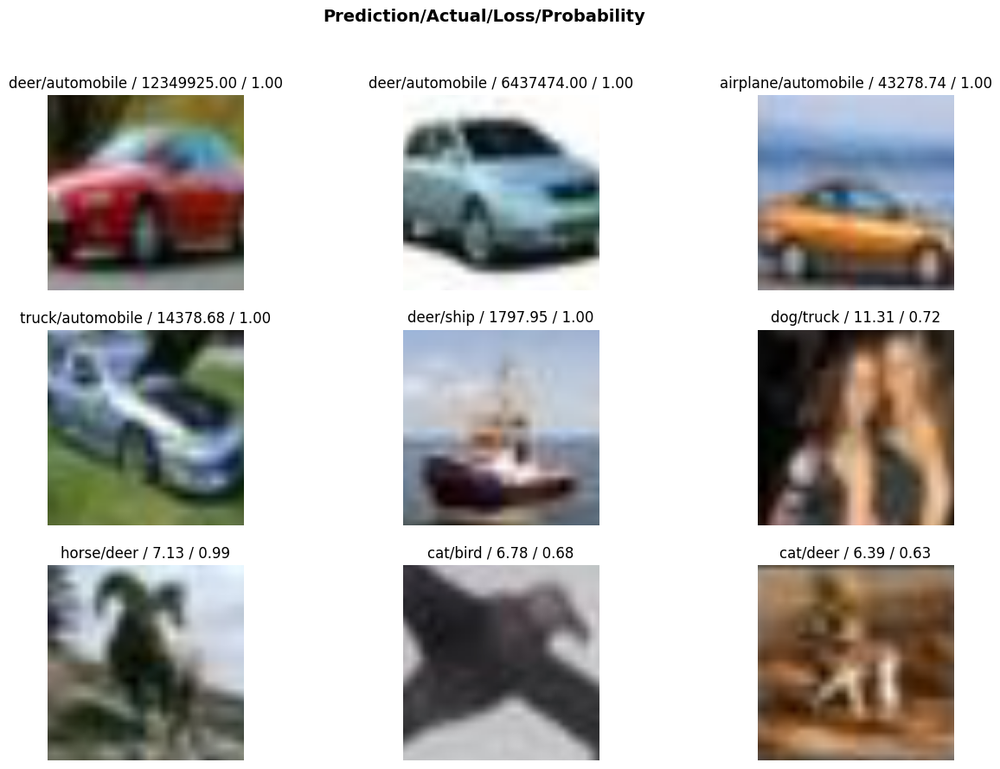

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsEfficientNet_S.csv', index=False)

In [ ]:
df

,filename,predicted_class
0,7531.jpg,frog
1,0110.jpg,airplane
2,1035.jpg,horse
3,2227.jpg,ship
4,2495.jpg,dog
...,...,...
9995,5169.jpg,cat
9996,5738.jpg,frog
9997,5572.jpg,dog
9998,9831.jpg,ship


,filename,predicted_class
0,7531.jpg,frog
1,0110.jpg,airplane
2,1035.jpg,horse
3,2227.jpg,ship
4,2495.jpg,dog
...,...,...
9995,5169.jpg,cat
9996,5738.jpg,frog
9997,5572.jpg,dog
9998,9831.jpg,ship


# TESTING EfficientNet 2 (little progresive resizing) [0.989600]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=64, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.03, bs=256, freeze_epochs=3, image_size=128, wd=0.01, ps=0.005)

In [ ]:
from fastai.vision.all import *
from fastai.vision.models import efficientnet_b0
#train the model
learn = cnn_learner(dls, efficientnet_b0, metrics=[accuracy, error_rate], pretrained=True, ps=0.005)
learn.fine_tune(epochs=7, base_lr=0.05, wd=0.0, freeze_epochs=3)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B0_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B0_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-3dd342df.pth" to /root/.cache/torch/hub/c

epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.909404,0.829220,0.716000,0.284000,01:57
1,0.706773,0.801456,0.758400,0.241600,01:51
2,0.619678,0.973091,0.826000,0.174000,01:51


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.391589,0.786201,0.883200,0.116800,02:09
1,0.401378,0.469730,0.878000,0.122000,02:11
2,0.317689,0.344354,0.891600,0.108400,02:12
3,0.240076,1.465542,0.903600,0.096400,02:13
4,0.150357,1.212610,0.915600,0.084400,02:14
5,0.098778,1.150220,0.919600,0.080400,02:12
6,0.075727,0.971309,0.920800,0.079200,02:13


### Iteració 2 (lr=0.01, bs=128, freeze_epochs=1, image_size=512, wd=0.01, ps=0.005)

In [ ]:
from fastai.callback.all import *
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=256, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Add the EarlyStoppingCallback and ReduceLROnPlateau
callbacks = [EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=1),
             ReduceLROnPlateau(monitor='accuracy', factor=0.25, min_delta=0.1, patience=1)]

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=20, base_lr=0.01, wd=0.0, freeze_epochs=1, cbs=callbacks)


Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.066890,0.035351,0.989200,0.010800,01:35


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.059179,0.031585,0.990800,0.009200,01:41
1,0.058923,0.031595,0.989600,0.010400,01:42


No improvement since epoch 0: early stopping


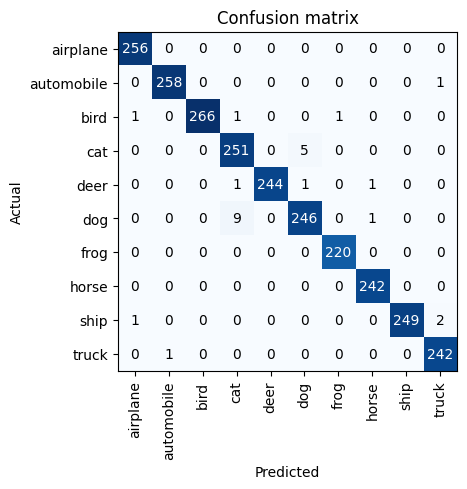

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

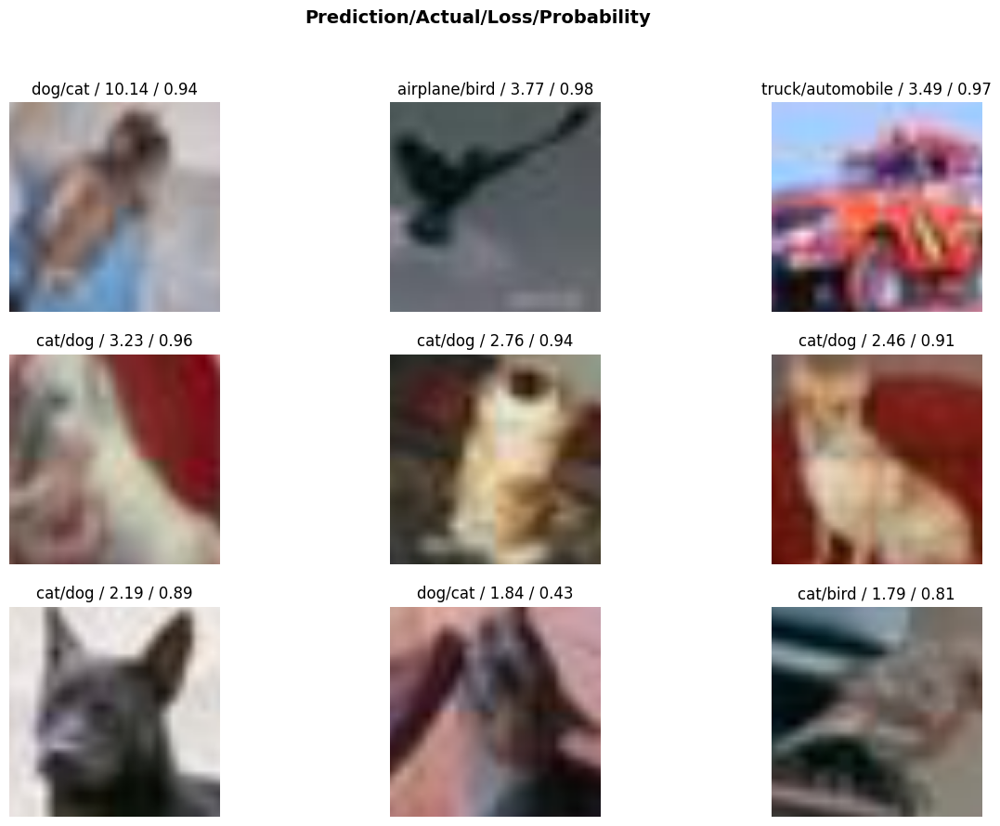

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsEfficientNet_S_2.csv', index=False)

In [ ]:
df

,filename,predicted_class
0,1539.jpg,cat
1,0348.jpg,automobile
2,9792.jpg,automobile
3,3167.jpg,truck
4,1842.jpg,airplane
...,...,...
9995,9848.jpg,horse
9996,5282.jpg,frog
9997,7398.jpg,deer
9998,8258.jpg,bird


# TESTING EfficientNet 3 (little progresive resizing) [0.988800]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=64, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.03, bs=256, freeze_epochs=3, image_size=128, wd=0.01, ps=0.005)

In [ ]:
from fastai.vision.all import *
from fastai.vision.models import efficientnet_b0
#train the model
learn = cnn_learner(dls, efficientnet_b0, metrics=[accuracy, error_rate], pretrained=True, ps=0.005)
learn.fine_tune(epochs=7, base_lr=0.05, wd=0.0, freeze_epochs=3)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B0_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B0_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.882452,0.760278,0.743200,0.256800,02:19


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.882452,0.760278,0.743200,0.256800,02:19
1,0.712559,0.564485,0.818400,0.181600,01:49
2,0.577065,0.669879,0.871200,0.128800,01:49


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.379385,1.406188,0.883600,0.116400,02:06
1,0.377551,0.595364,0.896800,0.103200,02:06
2,0.335005,8.330103,0.898400,0.101600,02:06
3,0.221212,5.549809,0.916800,0.083200,02:06
4,0.151251,2.442653,0.926400,0.073600,02:07
5,0.103465,1.230100,0.930400,0.069600,02:07
6,0.074572,1.338509,0.934400,0.065600,02:08


### Iteració 2 (lr=0.01, bs=128, freeze_epochs=1, image_size=512, wd=0.01, ps=0.005)

In [ ]:
from fastai.callback.all import *
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=256, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Add the EarlyStoppingCallback and ReduceLROnPlateau
callbacks = [EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=1),
             ReduceLROnPlateau(monitor='accuracy', factor=0.25, min_delta=0.1, patience=1)]

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=20, base_lr=0.01, wd=0.0, freeze_epochs=1, cbs=callbacks)


Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.064152,0.108669,0.989600,0.010400,01:30


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.059345,0.141050,0.989600,0.010400,01:39
1,0.054940,0.154473,0.988800,0.011200,01:37


No improvement since epoch 0: early stopping


In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

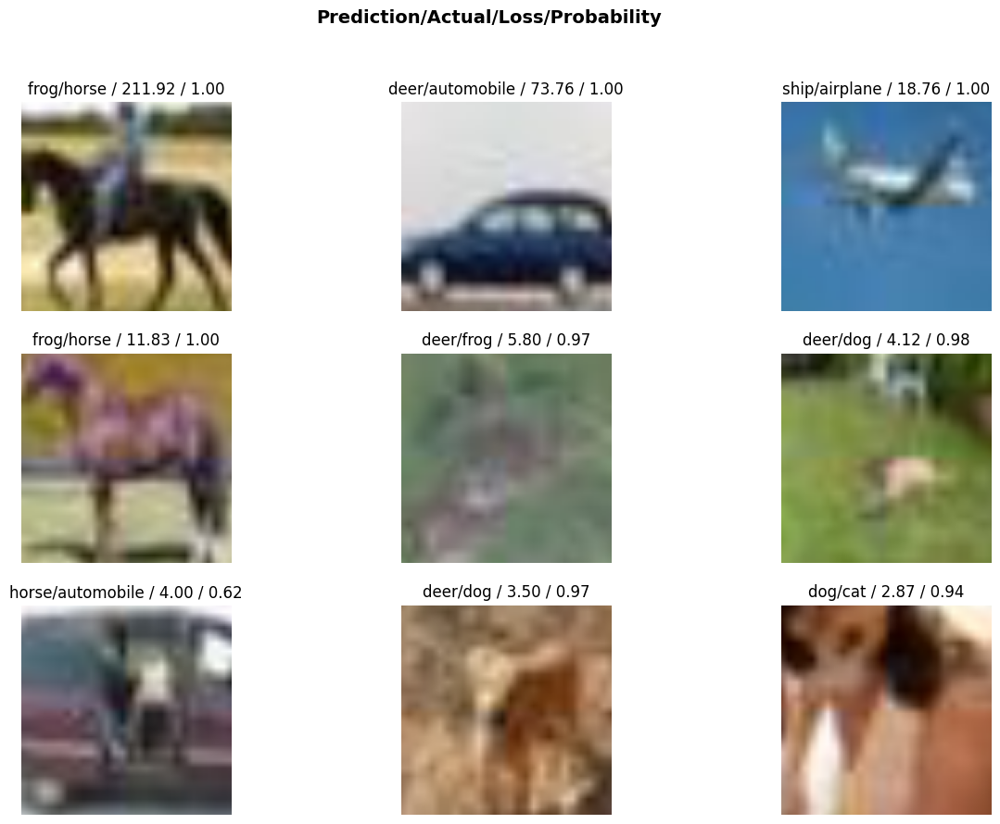

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsEfficientNet_S_3.csv', index=False)

In [ ]:
df

,filename,predicted_class
0,1539.jpg,cat
1,0348.jpg,automobile
2,9792.jpg,automobile
3,3167.jpg,truck
4,1842.jpg,airplane
...,...,...
9995,9848.jpg,horse
9996,5282.jpg,frog
9997,7398.jpg,deer
9998,8258.jpg,dog


,filename,predicted_class
0,1539.jpg,cat
1,0348.jpg,automobile
2,9792.jpg,automobile
3,3167.jpg,truck
4,1842.jpg,airplane
...,...,...
9995,9848.jpg,horse
9996,5282.jpg,frog
9997,7398.jpg,deer
9998,8258.jpg,dog


# TESTING EfficientNet 4 (little progresive resizing) [0.995200]

## Carreguem dades

In [ ]:
#desenzipem les dades
from google.colab import drive
#drive.mount('/content/drive')
#!mkdir /content/dataset/
#!unzip "drive/MyDrive/AML/AML_dataset.zip" -d "/content/dataset/"
!unzip "/content/test_unlabelled.zip"

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: test_unlabelled/5000.jpg  
  inflating: test_unlabelled/5001.jpg  
  inflating: test_unlabelled/5002.jpg  
  inflating: test_unlabelled/5003.jpg  
  inflating: test_unlabelled/5004.jpg  
  inflating: test_unlabelled/5005.jpg  
  inflating: test_unlabelled/5006.jpg  
  inflating: test_unlabelled/5007.jpg  
  inflating: test_unlabelled/5008.jpg  
  inflating: test_unlabelled/5009.jpg  
  inflating: test_unlabelled/5010.jpg  
  inflating: test_unlabelled/5011.jpg  
  inflating: test_unlabelled/5012.jpg  
  inflating: test_unlabelled/5013.jpg  
  inflating: test_unlabelled/5014.jpg  
  inflating: test_unlabelled/5015.jpg  
  inflating: test_unlabelled/5016.jpg  
  inflating: test_unlabelled/5017.jpg  
  inflating: test_unlabelled/5018.jpg  
  inflating: test_unlabelled/5019.jpg  
  inflating: test_unlabelled/5020.jpg  
  inflating: test_unlabelled/5021.jpg  
  inflating: test_unlabelled/5022.jpg  
  inflating: test_u

## Ajuntem les dades "train" i "validation" (dins la carpeta "train")

In [ ]:
import os

# Set the path to the validation folder
val_path = Path('/content/validation')
#train_path = path/'train'
#test_path = path/'test_unlabelled'

# Loop through each subfolder in the validation folder
for subfolder in os.listdir(val_path):
    # Set the path to the subfolder
    subfolder_path = os.path.join(val_path, subfolder)
    # Loop through each image in the subfolder
    for img_file in os.listdir(subfolder_path):
        # Set the path to the image
        img_path = os.path.join(subfolder_path, img_file)
        # Rename the image by adding the "valid_" prefix
        os.rename(img_path, os.path.join(subfolder_path, 'valid_' + img_file))


In [ ]:
import shutil

# Set the paths to the train and validation folders
train_path = Path('/content/train')

# Loop through each subfolder in the train and validation folders
for subfolder in os.listdir(train_path):
    # Set the paths to the subfolders
    train_subfolder_path = os.path.join(train_path, subfolder)
    val_subfolder_path = os.path.join(val_path, subfolder)
    # Copy the images from the validation subfolder to the train subfolder
    for img_file in os.listdir(val_subfolder_path):
        img_path = os.path.join(val_subfolder_path, img_file)
        shutil.copy(img_path, train_subfolder_path)


In [ ]:
train_count = len(get_image_files(train_path))
valid_count = len(get_image_files(val_path))

In [ ]:
print(f"train images: {train_count}")
print(f"validation images: {valid_count}")

train images: 50000
validation images: 10000


## Learner

### Definim el DataBlock i Dataloader

In [ ]:
from fastai.vision.all import *

# Set the path to the train_all folder
path = Path('/content/train')
# Define the data block
dblock = DataBlock(blocks=(ImageBlock, CategoryBlock),
                   get_items=get_image_files,
                   splitter=RandomSplitter(valid_pct=0.05),
                   get_y=parent_label,
                   item_tfms=[RandomResizedCrop(128, min_scale=0.75), FlipItem(p=0.5)],
                   batch_tfms=[Normalize.from_stats(*imagenet_stats)])

# Create the dataloaders
dls = dblock.dataloaders(path, bs=64, num_workers=8, verbose=True,
                         batch_tfms=[*aug_transforms(size=128, max_rotate=30.0, min_scale=0.75, flip_vert=True),
                                         Normalize.from_stats(*imagenet_stats)],
                         item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


### Iteració 1 (lr=0.03, bs=256, freeze_epochs=3, image_size=128, wd=0.01, ps=0.005)

In [ ]:
from fastai.vision.all import *
from fastai.vision.models import efficientnet_b0
from fastai.callback.all import *

callbacks = [ReduceLROnPlateau(monitor='accuracy', factor=0.25, min_delta=0.01, patience=1)]

#train the model
learn = cnn_learner(dls, efficientnet_b0, metrics=[accuracy, error_rate], pretrained=True, ps=0.005)
learn.fine_tune(epochs=10, base_lr=0.05, wd=0.0, freeze_epochs=3)

/usr/local/lib/python3.9/dist-packages/fastai/vision/learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B0_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B0_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.915433,0.801592,0.726000,0.274000,02:06
1,0.699633,0.565365,0.820400,0.179600,01:56
2,0.568758,1.474147,0.854800,0.145200,01:52


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.358472,1.619563,0.879200,0.120800,02:09
1,0.354703,0.749890,0.890000,0.110000,02:10
2,0.328110,1.121996,0.894800,0.105200,02:09
3,0.266561,1.374368,0.904000,0.096000,02:07


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.358472,1.619563,0.879200,0.120800,02:09
1,0.354703,0.749890,0.890000,0.110000,02:10
2,0.328110,1.121996,0.894800,0.105200,02:09
3,0.266561,1.374368,0.904000,0.096000,02:07
4,0.212142,3.713680,0.906000,0.094000,02:09
5,0.140982,9.973156,0.894400,0.105600,02:09
6,0.117452,10.485888,0.914800,0.085200,02:07
7,0.062076,7.028413,0.927600,0.072400,02:07
8,0.047958,6.551011,0.930000,0.070000,02:08
9,0.048076,1.017339,0.932400,0.067600,02:08


### Iteració 2 (lr=0.01, bs=128, freeze_epochs=1, image_size=512, wd=0.01, ps=0.005)

In [ ]:
from fastai.callback.all import *
dls = dblock.dataloaders(path, bs=256, num_workers=8, verbose=True,
                             batch_tfms=[*aug_transforms(size=256, max_rotate=30.0, min_scale=0.75, flip_vert=True,),
                                         Normalize.from_stats(*imagenet_stats)],
                             item_tfms=[FlipItem(p=0.5),Normalize.from_stats(*imagenet_stats)])

# Add the EarlyStoppingCallback and ReduceLROnPlateau
callbacks = [EarlyStoppingCallback(monitor='accuracy', min_delta=0.01, patience=1),
             ReduceLROnPlateau(monitor='accuracy', factor=0.5, min_delta=0.1, patience=1)]

# Step 4: Fine-tune the model with larger image size
learn.dls = dls
learn.fine_tune(epochs=20, base_lr=0.01, wd=0.0, freeze_epochs=1, cbs=callbacks)


Found 50000 items
2 datasets of sizes 47500,2500
Setting up Pipeline: PILBase.create
Setting up Pipeline: parent_label -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: FlipItem -- {'p': 0.5} -> RandomResizedCrop -- {'size': (128, 128), 'min_scale': 0.75, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Normalize -- {'mean': tensor([[[[0.4850]],

         [[0.4560]],

         [[0.4060]]]], device='cuda:0'), 'std': tensor([[[[0.2290]],

         [[0.2240]],

         [[0.2250]]]], device='cuda:0'), 'axes': (0, 2, 3)}


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.038642,0.101390,0.993600,0.006400,01:32


epoch,train_loss,valid_loss,accuracy,error_rate,time
0,0.037192,0.111092,0.995600,0.004400,01:42
1,0.035223,0.071492,0.995200,0.004800,01:42


No improvement since epoch 0: early stopping


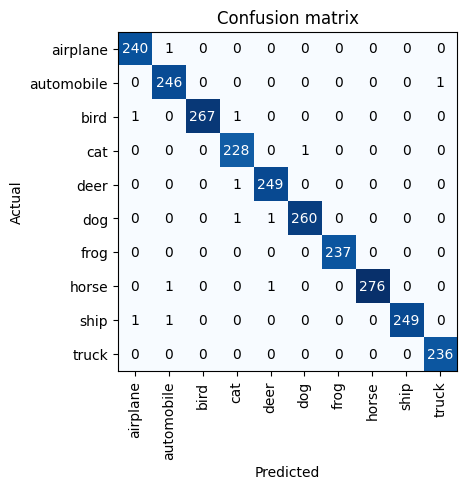

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

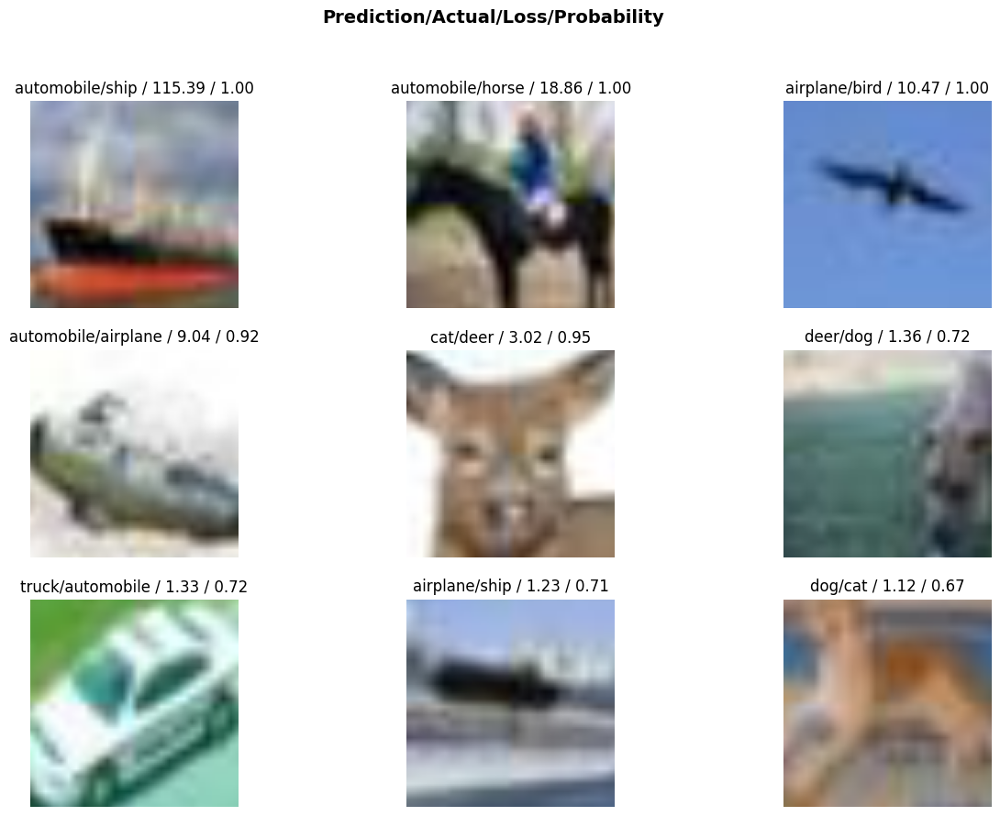

In [ ]:
interp2 = Interpretation.from_learner(learn)
interp2.plot_top_losses(9, figsize=(15,10))

## Predictions

In [ ]:
# Make predictions on the test set
test_dl = dls.test_dl(get_image_files(Path('/content/test_unlabelled')))
preds, _ = learn.get_preds(dl=test_dl)

# Create a CSV file with the predictions
test_names = [f.name for f in test_dl.items]
pred_classes = [dls.vocab[i] for i in preds.argmax(dim=-1)]
df = pd.DataFrame({'filename': test_names, 'predicted_class': pred_classes})
df.to_csv('predictionsEfficientNet_S_4.csv', index=False)

In [ ]:
df

,filename,predicted_class
0,1539.jpg,cat
1,0348.jpg,automobile
2,9792.jpg,automobile
3,3167.jpg,truck
4,1842.jpg,airplane
...,...,...
9995,9848.jpg,horse
9996,5282.jpg,frog
9997,7398.jpg,deer
9998,8258.jpg,dog


# Ensamble

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import LabelEncoder

In [ ]:
predictions = pd.read_csv('predictions.csv')
predictions

,filename,VGG19_S_7_9148,ResNet8_S_9656,ResNet5_9688,DenseNet2_S_957600,DenseNet4_S_9724,DenseNet6_S_968,EfficientNet_S_2_9896,EfficientNet_S_3_9888,EfficientNet_S_4_9952
0,0000.jpg,airplane,airplane,airplane,airplane,airplane,airplane,airplane,airplane,airplane
1,0001.jpg,bird,deer,deer,deer,deer,deer,deer,deer,deer
2,0002.jpg,cat,dog,cat,cat,cat,cat,cat,cat,cat
3,0003.jpg,cat,cat,cat,cat,cat,cat,cat,cat,cat
4,0004.jpg,automobile,cat,cat,truck,automobile,ship,cat,automobile,automobile
...,...,...,...,...,...,...,...,...,...,...
9995,9995.jpg,ship,ship,ship,ship,ship,ship,ship,ship,ship
9996,9996.jpg,automobile,automobile,automobile,automobile,automobile,automobile,automobile,automobile,automobile
9997,9997.jpg,automobile,automobile,automobile,automobile,automobile,automobile,automobile,automobile,automobile
9998,9998.jpg,cat,cat,cat,cat,cat,cat,cat,cat,cat


In [ ]:
# Define the weights for each model based on their accuracy
weights = [0.9148, 0.9656, 0.9688, 0.9576, 0.9724, 0.968, 0.9896, 0.9888, 0.9952, 0.0]

# Get the predictions columns
prediction_cols = list(predictions.columns[1:])

# create one-hot encoding for categorical values
predictions_onehot = pd.get_dummies(predictions[prediction_cols])

In [ ]:
# add an extra column of zeros to predictions_onehot
n_classes = len(prediction_cols) + 1
extra_col = np.zeros((predictions.shape[0], 1))
predictions_onehot = pd.concat([predictions_onehot, pd.DataFrame(extra_col, columns=['missing_class'])], axis=1)

In [ ]:
# initialize an array to store the weighted predictions
weighted_preds = np.zeros((predictions.shape[0], n_classes))

In [ ]:
# calculate the weighted predictions for each model
for i, col in enumerate(prediction_cols + ['missing_class']):
    weighted_preds += predictions_onehot.filter(like=col).values * weights[i]
#The for loop iterates over each column in the one-hot encoded data, as well as the extra column of zeros.
#For each column, the corresponding weight is applied to the one-hot encoded values, and the resulting array is added to the weighted_preds array.

In [ ]:
# get final predictions
final_preds = np.argmax(weighted_preds, axis=1)
final_preds

array([0, 4, 3, ..., 1, 3, 8])

In [ ]:
#convert the numerical predictions back to their original categorical values
label_encoder = LabelEncoder()
label_encoder.fit(predictions.iloc[:, 1:].values.flatten())
final_preds_cat = label_encoder.inverse_transform(final_preds)
final_preds_cat

array(['airplane', 'deer', 'cat', ..., 'automobile', 'cat', 'ship'],
      dtype=object)

In [ ]:
df_final_preds = pd.DataFrame(final_preds_cat, index=predictions["filename"], columns=["prediction"])
df_final_preds.to_csv('predictions_ensambler.csv')
df_final_preds

,prediction
filename,
0000.jpg,airplane
0001.jpg,deer
0002.jpg,cat
0003.jpg,cat
0004.jpg,automobile
...,...
9995.jpg,ship
9996.jpg,automobile
9997.jpg,automobile


# NOTES:

## CONSELLS
data augmentation (per datasets)

parametres senzills
- im size
- batch size (16, 32, ...)
- epochs (callbacks per ferlos més eficients)

altres parametres relacionats amb learning rate
- learning rate
- optimazer com actualitzem els pesos després de cada batch
- scheduler planificar el learning rate en cada epoch (+ control)

ESQUEMA PER FASTAI learn=cnn_learner(#en desús) learn= vision_learner(
  - dls (DATASET)
  - resnet34
  - metrics=[,](METRIQUES PER VISUALITZAR (LOSS, ACCURACY ERROR)
  - loss_func=(COM CALCULEM L'ERROR ENTRE IMATGES D'ENTRADA I IMATGES DE SORTIDA)
  - opt_fun
  - lr=
  - cbs=[ShowGraphCallbacks()]

learn.summary (EXPLICA COM ÉS LA XARXA I ELS SEUS PARÀMETRES)
learn.fit_one_cycle / learn.fine_tune (PER FER ELS ENTRENAMENTS, MODIFICA LEARNING RATE, FINE_TUNE PRIMER CONGELA LA PART CONVOLUCIONAL I DESPRÉS LA DESCONGELA)
learn.save / learn.export

## param tuning
Learner.fine_tune (epochs, base_lr=0.002, freeze_epochs=1, lr_mult=100, pct_start=0.3, div=5.0, lr_max=None,div_final=100000.0, wd=None, moms=None, cbs=None,reset_opt=False, start_epoch=0)

base_lr=[0.001,0.005,0.01]

freeze_epochs=[1,2,3]

wd=[None,0.1,0.01,0.001]

cbs=[EarlyStoppingCallback(patience=2)

## Batch/item dataloader/datablock
1. The difference between item transformation in DataBlock and DataLoader is when the transformations are applied. Item transformations in DataBlock are applied to each item (i.e., image and label) during data processing, before they are grouped into batches. Item transformations in DataLoader, on the other hand, are applied to each item within a batch during training.

2. Similarly, batch transformations in DataBlock are applied to each batch during data processing, before it is passed to the model. Batch transformations in DataLoader are applied to each batch during training.

3. You should use item transformations in DataBlock when you want to apply the same set of transformations to each item in your dataset. You should use item transformations in DataLoader when you want to apply different transformations to each item within a batch during training. You should use batch transformations in DataBlock when you want to apply the same set of transformations to each batch in your dataset. You should use batch transformations in DataLoader when you want to apply different transformations to each batch during training.

The main difference between using item transformations in DataBlock and DataLoader is the timing of when the transformations are applied. Item transformations in DataBlock are applied once to each item during the initial processing of the data, before the items are grouped into batches. Item transformations in DataLoader are applied to each item within a batch during training or inference. The purpose of item transformations in DataBlock is to prepare the data for loading into the model, while the purpose of item transformations in DataLoader is to increase the diversity of the data and reduce overfitting by generating new variations of the original data.

The main difference between using batch transformations in DataBlock and DataLoader is the timing of when the transformations are applied. Batch transformations in DataBlock are applied once to each batch during the initial processing of the data, after the individual items have been grouped into batches. Batch transformations in DataLoader are applied to each batch during training or inference, after the individual items within each batch have been transformed using item transformations. The purpose of batch transformations in DataBlock is to prepare the data for loading into the model, while the purpose of batch transformations in DataLoader is to increase the diversity of the data and reduce overfitting by generating new variations of the original data.

## DATABLOCK

1. blocks=(ImageBlock, CategoryBlock): defines the two types of data that the data block should expect - image data and category labels. ImageBlock is used to represent the image data and CategoryBlock is used to represent the categories/labels that the images belong to.

2. get_items=get_image_files: specifies the function to use to get the list of all image files in the dataset. get_image_files is a function provided by the fastai library that returns a list of all image files in a given directory.

3. get_y=parent_label: specifies the function to use to get the category label for each image. parent_label is a function provided by the fastai library that returns the parent folder name of an image file, which is assumed to be the label for the image.

4. splitter=GrandparentSplitter(valid_name='validation'): specifies the function to use to split the data into training and validation sets. GrandparentSplitter is a function provided by the fastai library that splits the data based on the grandparent folder name of each image file. In this case, the grandparent folder is assumed to be the name of the dataset (either "train" or "validation"), and the validation set is assumed to be the subset of the data with grandparent folder name "validation".

5. item_tfms=[RandomResizedCrop(224, min_scale=0.5), FlipItem(p=0.5), Resize(224)]: specifies a list of image transformations to apply to each image before it is loaded into the dataloader.
- RandomResizedCrop(224, min_scale=0.5) - This transformation randomly crops a square region of the image, resizes it to 224x224, and applies a random scaling factor between 0.5 and 1.0 to the cropped region. This helps to ensure that the model is exposed to a variety of image scales and cropping configurations during training.
- FlipItem(p=0.5) - This transformation flips the image horizontally with a probability of 0.5. This helps to introduce some horizontal variation into the training data and improve the model's robustness to flipped images.

6. batch_tfms=[*aug_transforms(), Normalize.from_stats(*imagenet_stats)]: specifies a list of transformations to apply to each batch of images. Batch transformations are applied to a batch of images (i.e., a set of images loaded into the GPU memory together) just before the model is trained on the batch.
- *aug_transforms() - This is a set of data augmentation techniques provided by the fastai library, including random flipping, rotating, zooming, and warping of the images. These transformations help to introduce more variety and randomness into the training data, which can improve the model's ability to generalize to new images. The * in [*aug_transforms()] is used to "unpack" the list of transformations provided by aug_transforms() so that they are passed as separate arguments to batch_tfms.
- Normalize.from_stats(*imagenet_stats) - This transformation normalizes the pixel values of the images in the batch to have zero mean and unit standard deviation, using the mean and standard deviation of the ImageNet dataset. This helps to center and scale the input data for the model, making it easier for the optimizer to learn meaningful weights for each input feature.

## DATALOADER

1. dls3: creates a DataLoaders object, which is responsible for loading the data in batches and applying the specified transformations to the data.

2. data.dataloaders(path, bs=128, item_tfms=[...], batch_tfms=[...], verbose=True): specifies the arguments to create the DataLoaders object.

3. path: the path to the directory containing the training and validation data.

4. bs=128: specifies the batch size to use for training and validation batches. A batch size of 128 means that each batch will contain 128 images.

5. item_tfms=[Resize(224, method='squish'), FlipItem(p=0.5), Normalize.from_stats(*imagenet_stats)]: specifies a list of image transformations to apply to each image before it is loaded into the dataloader.
- Resize(224, method='squish'): This transformation resizes each image to have a height and width of 224 pixels while maintaining the aspect ratio. If the aspect ratio of the original image is not 1:1 (i.e., the width and height are not equal), then the image will be "squished" or "stretched" to fit the 224x224 size.
- FlipItem(p=0.5): This transformation horizontally flips each image with a probability of 0.5. This is a common technique used to increase the number of training examples and improve model performance.
- Normalize.from_stats(*imagenet_stats): This transformation normalizes each image using the mean and standard deviation of the ImageNet dataset. ImageNet is a large dataset of labeled images that is commonly used to pretrain deep learning models. Normalizing the images using the ImageNet statistics helps to improve model performance.

6. batch_tfms=[*aug_transforms(size=224, max_rotate=30.0, min_scale=0.75), Normalize.from_stats(*imagenet_stats)]: This line specifies a list of transformations that will be applied to each batch of images before they are passed to the model for training or inference.
- *aug_transforms(size=224, max_rotate=30.0, min_scale=0.75): This step uses the aug_transforms() function from the fastai library to apply a set of data augmentation techniques to each batch of images. These techniques include random cropping, flipping, rotating, and zooming. The size argument specifies the final size of the cropped images (in this case, 224x224), and the max_rotate and min_scale arguments specify the maximum rotation angle and minimum zoom scale to use for the data augmentation.
- Normalize.from_stats(*imagenet_stats): This step normalizes the images in each batch using the mean and standard deviation of the ImageNet dataset. By normalizing the images in each batch, we can ensure that the model is trained on data that has a similar distribution to the ImageNet dataset, which can help to improve model performance.

7. verbose=True: specifies that progress messages should be printed to the console during training and validation.

## Model performance
To improve the performance of your model and reduce overfitting, here are some suggestions for optimizing your data loading pipeline:

Increase the size of the dataset by applying data augmentation techniques: You can use a variety of data augmentation techniques, such as random crops, flips, rotations, and color jittering, to increase the size of your training dataset. This will help your model generalize better and reduce overfitting. You can use the aug_transforms function from the fastai.vision.transforms module to apply a set of commonly used data augmentation techniques.

Use progressive resizing: You can start by training your model on small images (e.g., 64x64) and gradually increase the size of the images (e.g., 128x128, 224x224) as the training progresses. This technique can help your model to learn low-level features on small images first and then refine them on larger images.

Use mixed-precision training: You can use mixed-precision training, which uses half-precision (float16) for storing the model's weights and activations, to speed up the training process. This technique can reduce the memory footprint of your model and increase the training speed.

Use batch normalization: You can use batch normalization layers in your model to normalize the activations of the previous layer, which can help the model to converge faster and reduce overfitting.

Use transfer learning: You can use a pre-trained model, such as VGG or ResNet, as a feature extractor and then fine-tune the model on your dataset. This can help your model to learn useful features from the pre-trained model and reduce the amount of training required.

Regarding the data loading pipeline, you can apply the following suggestions:

Use the RandomResizedCrop transformation with a larger crop size (e.g., 224x224) to randomly crop and resize the images during training. This will help your model to learn from different parts of the image and improve its robustness.

Use the RandomFlip transformation to randomly flip the images horizontally during training. This will help your model to learn from different orientations of the objects in the images.

Use the Normalize transformation to normalize the pixel values of the images using the mean and standard deviation of the dataset. This will help your model to learn faster and reduce overfitting.

Use the ToTensor transformation to convert the images to PyTorch tensors. This will make it easier for the model to process the images.

Use the DataLoader class to create batches of data for training. You can set the batch_size parameter to a value that fits into your GPU memory and the num_workers parameter to a value that utilizes all the CPU cores on your machine. You can also shuffle the training data to prevent the model from memorizing the order of the images.

## Citas
Hands-On Machine Learning with Scikit-Learn, Keras & TensorFlow (Aurélien Géron): if you set high learning rate, yhen your system will rapidly adapt to new data but it will also tend to quikly forget the old data. Conversely, if you set a low learning rate, the system will have more inertia; that is, it will learn more slowly, but it will also be less sensitive to noise in the new data or to sequences of nonrepresentative data points.

